## Germany & neighbors PV Cut Scenario due to Volcanic Eruption with 130 €/t CO2 price. Transmission Expansion is not allowed in the base model

In [1]:
import pypsa 
import matplotlib.pyplot as plt
plt.style.use("bmh")
import pandas as pd
from pypsa.plot import add_legend_patches
import gurobipy
import cartopy.crs as ccrs
from pypsa.optimization import optimize
import matplotlib.cm as cm
import numpy as np
import xarray as xr
import seaborn as sns
import os
import re

pd.set_option("display.max_rows", None)  # Display all rows
pd.set_option("display.max_columns", None)  # Display all columns


# Base Scenario

## Import Network

In [2]:
country = 'DE'
buses = '20'
le = '1.0'

In [3]:
n = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\elec_s_20_ec_lv1.0_168h-EQ0.9c_aut.nc")

INFO:pypsa.io:Imported network elec_s_20_ec_lv1.0_168h-EQ0.9c_aut.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


In [4]:
#gen_curve(n, '2030-01-01', '2030-12-31', colors_gen,'CZ')

In [5]:
# add co2price
co2_price = 130 #€/t

for index in n.generators.index:
    emission = n.carriers.co2_emissions.filter(like= n.generators.carrier[index]) #t/MWh_th
    n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\3184507867.py:6: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel


In [6]:
for c in n.iterate_components(list(n.components.keys())[2:]):
    print("Component '{}' has {} entries".format(c.name,len(c.df)))

Component 'Bus' has 20 entries
Component 'Carrier' has 21 entries
Component 'GlobalConstraint' has 1 entries
Component 'Line' has 8 entries
Component 'LineType' has 34 entries
Component 'TransformerType' has 14 entries
Component 'Link' has 6 entries
Component 'Load' has 20 entries
Component 'Generator' has 261 entries
Component 'StorageUnit' has 65 entries


In [7]:
#remove nuclear fleet from germany
n.generators.loc[n.generators.index.str.startswith('DE') & n.generators.index.str.endswith('nuclear'), 'p_nom'] = 0


In [8]:
# set marginal cost of load shedding to 3000€/MWh
for bus in n.generators.bus:
    for index in n.generators.index:
        if not bus.endswith('H2') and index.endswith('load'):
            n.generators.loc[index, 'marginal_cost'] = 3000

#edit load shedding's unit from kW to MW
for index in n.generators.index:
    if index.endswith('load') and not index.endswith('H2 load'):
        n.generators.loc[index, 'sign'] = 1

#### Import solved model, if no changes to the model have been made

In [9]:
def import_nc_file(directory, filename):
    # Construct the full path to the .nc file
    file_path = os.path.join(directory, filename)
    
    # Open the NetCDF file using xarray
    ds = pypsa.Network(file_path)
    
    return ds
directory = os.getcwd()
dir = 'c:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes'


In [10]:
def add_EQ_constraints(n, o, scaling=1e-1):
    """
    Add equity constraints to the network.

    Currently this is only implemented for the electricity sector only.

    Opts must be specified in the config.yaml.

    Parameters
    ----------
    n : pypsa.Network
    o : str

    Example
    -------
    scenario:
        opts: [Co2L-EQ0.7-24h]

    Require each country or node to on average produce a minimal share
    of its total electricity consumption itself. Example: EQ0.7c demands each country
    to produce on average at least 70% of its consumption; EQ0.7 demands
    each node to produce on average at least 70% of its consumption.
    """
    # TODO: Generalize to cover myopic and other sectors?
    float_regex = "[0-9]*\.?[0-9]+"
    level = float(re.findall(float_regex, o)[0])
    if o[-1] == "c":
        ggrouper = n.generators.bus.map(n.buses.country)
        lgrouper = n.loads.bus.map(n.buses.country)
        sgrouper = n.storage_units.bus.map(n.buses.country)
    else:
        ggrouper = n.generators.bus
        lgrouper = n.loads.bus
        sgrouper = n.storage_units.bus
    load = (
        n.snapshot_weightings.generators
        @ n.loads_t.p_set.groupby(lgrouper, axis=1).sum()
    )
    inflow = (
        n.snapshot_weightings.stores
        @ n.storage_units_t.inflow.groupby(sgrouper, axis=1).sum()
    )
    inflow = inflow.reindex(load.index).fillna(0.0)
    rhs = scaling * (level * load - inflow)
    p = n.model["Generator-p"]
    lhs_gen = (
        (p * (n.snapshot_weightings.generators * scaling))
        .groupby(ggrouper.to_xarray())
        .sum()
        .sum("snapshot")
    )
    # TODO: double check that this is really needed, why do have to subtract the spillage
    if not n.storage_units_t.inflow.empty:
        spillage = n.model["StorageUnit-spill"]
        lhs_spill = (
            (spillage * (-n.snapshot_weightings.stores * scaling))
            .groupby(sgrouper.to_xarray())
            .sum()
            .sum("snapshot")
        )
        lhs = lhs_gen + lhs_spill
    else:
        lhs = lhs_gen
    n.model.add_constraints(lhs >= rhs, name="equity_min")

o = 'EQ0.9c'

n.optimize.create_model()
add_EQ_constraints(n, o)
n.optimize.solve_model(solver_name='gurobi')

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\3994677034.py:37: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  @ n.loads_t.p_set.groupby(lgrouper, axis=1).sum()
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\3994677034.py:41: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  @ n.storage_units_t.inflow.groupby(sgrouper, axis=1).sum()
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 10/10 [00:00<00:00, 86.20it/s]
INFO:linopy.io: Writing time: 0.93s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-paqtfn11.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-paqtfn11.lp


Reading time = 0.23 seconds


INFO:gurobipy:Reading time = 0.23 seconds


obj: 54689 rows, 25567 columns, 111795 nonzeros


INFO:gurobipy:obj: 54689 rows, 25567 columns, 111795 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 54689 rows, 25567 columns and 111795 nonzeros


INFO:gurobipy:Optimize a model with 54689 rows, 25567 columns and 111795 nonzeros


Model fingerprint: 0x8b6535ca


INFO:gurobipy:Model fingerprint: 0x8b6535ca


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 3e+02]


INFO:gurobipy:  Matrix range     [1e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 39109 rows and 5846 columns


INFO:gurobipy:Presolve removed 39109 rows and 5846 columns


Presolve time: 0.10s


INFO:gurobipy:Presolve time: 0.10s


Presolved: 15580 rows, 19721 columns, 61526 nonzeros


INFO:gurobipy:Presolved: 15580 rows, 19721 columns, 61526 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.05s


INFO:gurobipy:Ordering time: 0.05s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 40


INFO:gurobipy: Dense cols : 40


 AA' NZ     : 1.556e+05


INFO:gurobipy: AA' NZ     : 1.556e+05


 Factor NZ  : 5.639e+05 (roughly 20 MB of memory)


INFO:gurobipy: Factor NZ  : 5.639e+05 (roughly 20 MB of memory)


 Factor Ops : 4.342e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.342e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.65614849e+17 -9.63077472e+17  1.31e+10 1.78e+04  3.56e+14     0s


INFO:gurobipy:   0   4.65614849e+17 -9.63077472e+17  1.31e+10 1.78e+04  3.56e+14     0s


   1   3.31940009e+17 -7.52815119e+17  8.26e+09 7.54e+04  2.52e+14     0s


INFO:gurobipy:   1   3.31940009e+17 -7.52815119e+17  8.26e+09 7.54e+04  2.52e+14     0s


   2   2.16019570e+17 -2.07100296e+17  4.06e+09 2.81e+04  9.80e+13     0s


INFO:gurobipy:   2   2.16019570e+17 -2.07100296e+17  4.06e+09 2.81e+04  9.80e+13     0s


   3   7.08494186e+16 -2.98757128e+16  3.67e+08 4.53e+03  1.20e+13     0s


INFO:gurobipy:   3   7.08494186e+16 -2.98757128e+16  3.67e+08 4.53e+03  1.20e+13     0s


   4   1.82985096e+16 -1.45986172e+15  1.60e+07 1.68e+02  8.37e+11     0s


INFO:gurobipy:   4   1.82985096e+16 -1.45986172e+15  1.60e+07 1.68e+02  8.37e+11     0s


   5   2.17895323e+15 -9.01228040e+13  1.17e+06 9.31e-09  7.18e+10     1s


INFO:gurobipy:   5   2.17895323e+15 -9.01228040e+13  1.17e+06 9.31e-09  7.18e+10     1s


   6   8.76505774e+13 -4.09069248e+13  4.67e+04 6.52e-09  3.67e+09     1s


INFO:gurobipy:   6   8.76505774e+13 -4.09069248e+13  4.67e+04 6.52e-09  3.67e+09     1s


   7   1.65971032e+13 -1.37454655e+13  8.52e+03 6.52e-09  7.88e+08     1s


INFO:gurobipy:   7   1.65971032e+13 -1.37454655e+13  8.52e+03 6.52e-09  7.88e+08     1s


   8   4.54240698e+12 -3.42445933e+12  1.74e+03 5.12e-09  1.95e+08     1s


INFO:gurobipy:   8   4.54240698e+12 -3.42445933e+12  1.74e+03 5.12e-09  1.95e+08     1s


   9   1.91401953e+12 -2.37049995e+12  6.41e+02 3.03e-09  1.03e+08     1s


INFO:gurobipy:   9   1.91401953e+12 -2.37049995e+12  6.41e+02 3.03e-09  1.03e+08     1s


  10   1.61355642e+12 -1.55316934e+12  5.24e+02 1.40e-09  7.56e+07     1s


INFO:gurobipy:  10   1.61355642e+12 -1.55316934e+12  5.24e+02 1.40e-09  7.56e+07     1s


  11   8.16486637e+11 -8.61977797e+11  2.14e+02 8.15e-10  3.97e+07     1s


INFO:gurobipy:  11   8.16486637e+11 -8.61977797e+11  2.14e+02 8.15e-10  3.97e+07     1s


  12   3.72848052e+11 -2.72962691e+11  8.14e+01 2.33e-10  1.52e+07     1s


INFO:gurobipy:  12   3.72848052e+11 -2.72962691e+11  8.14e+01 2.33e-10  1.52e+07     1s


  13   2.19631672e+11 -1.36628747e+11  3.94e+01 2.33e-10  8.34e+06     1s


INFO:gurobipy:  13   2.19631672e+11 -1.36628747e+11  3.94e+01 2.33e-10  8.34e+06     1s


  14   1.90779476e+11 -4.05469917e+10  3.19e+01 1.02e-10  5.41e+06     1s


INFO:gurobipy:  14   1.90779476e+11 -4.05469917e+10  3.19e+01 1.02e-10  5.41e+06     1s


  15   1.19564554e+11  7.61572205e+09  1.36e+01 9.46e-11  2.61e+06     1s


INFO:gurobipy:  15   1.19564554e+11  7.61572205e+09  1.36e+01 9.46e-11  2.61e+06     1s


  16   9.28097805e+10  3.02161092e+10  7.12e+00 4.18e-11  1.46e+06     1s


INFO:gurobipy:  16   9.28097805e+10  3.02161092e+10  7.12e+00 4.18e-11  1.46e+06     1s


  17   8.08287551e+10  4.04374998e+10  4.34e+00 5.28e-11  9.43e+05     1s


INFO:gurobipy:  17   8.08287551e+10  4.04374998e+10  4.34e+00 5.28e-11  9.43e+05     1s


  18   7.20213905e+10  4.65796742e+10  2.24e+00 5.12e-11  5.94e+05     1s


INFO:gurobipy:  18   7.20213905e+10  4.65796742e+10  2.24e+00 5.12e-11  5.94e+05     1s


  19   6.74036278e+10  5.29100415e+10  1.26e+00 3.11e-11  3.38e+05     1s


INFO:gurobipy:  19   6.74036278e+10  5.29100415e+10  1.26e+00 3.11e-11  3.38e+05     1s


  20   6.46475158e+10  5.56593707e+10  7.01e-01 5.55e-11  2.10e+05     1s


INFO:gurobipy:  20   6.46475158e+10  5.56593707e+10  7.01e-01 5.55e-11  2.10e+05     1s


  21   6.26498233e+10  5.86483815e+10  2.89e-01 8.32e-11  9.33e+04     1s


INFO:gurobipy:  21   6.26498233e+10  5.86483815e+10  2.89e-01 8.32e-11  9.33e+04     1s


  22   6.17715233e+10  5.97639742e+10  1.37e-01 2.99e-11  4.68e+04     1s


INFO:gurobipy:  22   6.17715233e+10  5.97639742e+10  1.37e-01 2.99e-11  4.68e+04     1s


  23   6.13577379e+10  6.03467760e+10  7.25e-02 5.32e-11  2.36e+04     1s


INFO:gurobipy:  23   6.13577379e+10  6.03467760e+10  7.25e-02 5.32e-11  2.36e+04     1s


  24   6.11378166e+10  6.05128628e+10  3.96e-02 5.33e-11  1.46e+04     1s


INFO:gurobipy:  24   6.11378166e+10  6.05128628e+10  3.96e-02 5.33e-11  1.46e+04     1s


  25   6.10269942e+10  6.06834606e+10  2.29e-02 5.49e-11  8.01e+03     1s


INFO:gurobipy:  25   6.10269942e+10  6.06834606e+10  2.29e-02 5.49e-11  8.01e+03     1s


  26   6.09004525e+10  6.07714290e+10  5.40e-03 1.33e-10  3.01e+03     1s


INFO:gurobipy:  26   6.09004525e+10  6.07714290e+10  5.40e-03 1.33e-10  3.01e+03     1s


  27   6.08630083e+10  6.08432371e+10  7.54e-04 6.18e-11  4.61e+02     1s


INFO:gurobipy:  27   6.08630083e+10  6.08432371e+10  7.54e-04 6.18e-11  4.61e+02     1s


  28   6.08559629e+10  6.08526663e+10  1.11e-04 6.76e-11  7.69e+01     1s


INFO:gurobipy:  28   6.08559629e+10  6.08526663e+10  1.11e-04 6.76e-11  7.69e+01     1s


  29   6.08550116e+10  6.08538660e+10  4.34e-05 8.90e-11  2.67e+01     1s


INFO:gurobipy:  29   6.08550116e+10  6.08538660e+10  4.34e-05 8.90e-11  2.67e+01     1s


  30   6.08546759e+10  6.08541953e+10  1.99e-05 5.71e-11  1.12e+01     1s


INFO:gurobipy:  30   6.08546759e+10  6.08541953e+10  1.99e-05 5.71e-11  1.12e+01     1s


  31   6.08544754e+10  6.08543290e+10  6.80e-06 6.89e-11  3.41e+00     1s


INFO:gurobipy:  31   6.08544754e+10  6.08543290e+10  6.80e-06 6.89e-11  3.41e+00     1s


  32   6.08543812e+10  6.08543633e+10  6.65e-07 1.06e-10  4.17e-01     1s


INFO:gurobipy:  32   6.08543812e+10  6.08543633e+10  6.65e-07 1.06e-10  4.17e-01     1s


  33   6.08543706e+10  6.08543687e+10  1.05e-07 3.99e-10  4.37e-02     1s


INFO:gurobipy:  33   6.08543706e+10  6.08543687e+10  1.05e-07 3.99e-10  4.37e-02     1s


  34   6.08543698e+10  6.08543694e+10  8.09e-08 1.29e-10  8.07e-03     1s


INFO:gurobipy:  34   6.08543698e+10  6.08543694e+10  8.09e-08 1.29e-10  8.07e-03     1s


  35   6.08543696e+10  6.08543696e+10  6.94e-07 3.40e-10  9.95e-04     1s


INFO:gurobipy:  35   6.08543696e+10  6.08543696e+10  6.94e-07 3.40e-10  9.95e-04     1s


  36   6.08543696e+10  6.08543696e+10  1.27e-08 9.77e-11  2.99e-06     1s


INFO:gurobipy:  36   6.08543696e+10  6.08543696e+10  1.27e-08 9.77e-11  2.99e-06     1s


  37   6.08543696e+10  6.08543696e+10  4.98e-10 7.71e-10  3.09e-08     1s


INFO:gurobipy:  37   6.08543696e+10  6.08543696e+10  4.98e-10 7.71e-10  3.09e-08     1s


  38   6.08543696e+10  6.08543696e+10  1.67e-10 9.28e-10  4.77e-10     1s


INFO:gurobipy:  38   6.08543696e+10  6.08543696e+10  1.67e-10 9.28e-10  4.77e-10     1s


INFO:gurobipy:


Barrier solved model in 38 iterations and 1.27 seconds (0.47 work units)


INFO:gurobipy:Barrier solved model in 38 iterations and 1.27 seconds (0.47 work units)


Optimal objective 6.08543696e+10


INFO:gurobipy:Optimal objective 6.08543696e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    9360 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:    9360 DPushes remaining with DInf 0.0000000e+00                 1s


       0 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:


     530 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:     530 PPushes remaining with PInf 0.0000000e+00                 1s


       0 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 5.4596604e-10      1s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 5.4596604e-10      1s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    5038    6.0854370e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    5038    6.0854370e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 5038 iterations and 1.45 seconds (0.50 work units)


INFO:gurobipy:Solved in 5038 iterations and 1.45 seconds (0.50 work units)


Optimal objective  6.085436962e+10


INFO:gurobipy:Optimal objective  6.085436962e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 25567 primals, 54689 duals
Objective: 6.09e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

('ok', 'optimal')

In [11]:
#solve network
#n.optimize(solver_name='gurobi')
#filename = "base_DE_20nodes_1.5_solved_168h.nc"
#n = import_nc_file(dir, filename)
contingency = 'pv'
n.name = f'base_{contingency}'

### Export model for later use

In [12]:
file = f"{country}_{buses}_{le}_base_solved_168h.nc"
output_path = os.path.join(dir, file)

n.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network DE_20_1.0_base_solved_168h.nc has lines, links, generators, global_constraints, carriers, loads, storage_units, buses


<xarray.Dataset> Size: 231kB
Dimensions:                               (snapshots: 53,
                                           investment_periods: 0, lines_i: 8,
                                           lines_t_p0_i: 8, lines_t_p1_i: 8,
                                           lines_t_loss_i: 8, links_i: 6,
                                           links_t_p0_i: 3, links_t_p1_i: 3,
                                           generators_i: 261,
                                           ...
                                           storage_units_t_p_dispatch_i: 23,
                                           storage_units_t_p_store_i: 13,
                                           storage_units_t_state_of_charge_i: 65,
                                           buses_i: 20, buses_t_p_i: 20,
                                           buses_t_v_ang_i: 6,
                                           buses_t_marginal_price_i: 20)
Coordinates: (12/27)
  * snapshots                             (snapshots) int64 424B 0 1 2 ... 51 52
  * investment_periods                    (investment_periods) int64 0B 
  * lines_i                               (lines_i) object 64B '12' ... '22'
  * lines_t_p0_i                          (lines_t_p0_i) object 64B '12' ... ...
  * lines_t_p1_i                          (lines_t_p1_i) object 64B '12' ... ...
  * lines_t_loss_i                        (lines_t_loss_i) object 64B '12' .....
    ...                                    ...
  * storage_units_t_p_store_i             (storage_units_t_p_store_i) object 104B ...
  * storage_units_t_state_of_charge_i     (storage_units_t_state_of_charge_i) object 520B ...
  * buses_i                               (buses_i) object 160B 'AT1 0' ... '...
  * buses_t_p_i                           (buses_t_p_i) object 160B 'AT1 0' ....
  * buses_t_v_ang_i                       (buses_t_v_ang_i) object 48B 'DE1 0...
  * buses_t_marginal_price_i              (buses_t_marginal_price_i) object 160B ...
Data variables: (12/98)
    snapshots_snapshot                    (snapshots) datetime64[ns] 424B 201...
    snapshots_objective                   (snapshots) float64 424B 168.0 ... ...
    snapshots_generators                  (snapshots) float64 424B 168.0 ... ...
    snapshots_stores                      (snapshots) float64 424B 168.0 ... ...
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    buses_country                         (buses_i) object 160B 'AT' ... 'SE'
    buses_control                         (buses_i) object 160B 'Slack' ... 'PQ'
    buses_generator                       (buses_i) object 160B 'AT1 0 CCGT' ...
    buses_t_p                             (snapshots, buses_t_p_i) float64 8kB ...
    buses_t_v_ang                         (snapshots, buses_t_v_ang_i) float64 3kB ...
    buses_t_marginal_price                (snapshots, buses_t_marginal_price_i) float64 8kB ...
Attributes:
    network__linearized_uc:      0
    network__multi_invest:       0
    network_name:                base_pv
    network_objective:           60854369615.301315
    network_objective_constant:  18417213809.827305
    network_pypsa_version:       0.27.0
    network_srid:                4326
    crs:                         {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"Worl...
    meta:                        {"version": "0.10.0", "tutorial": false, "lo...

In [13]:
def system_cost(n): #n.statistics.capex()
    stat = n.statistics()
    tsc = stat['Capital Expenditure'] + stat['Operational Expenditure']
    return tsc.droplevel(0).div(1e6) # million €/a

In [14]:
tot_cos_base=n.objective/1e9
system_cost_base = system_cost(n)
marg_price_region_base = n.buses_t.marginal_price.mean()
stat_base = n.statistics()

## Plot Network

<function matplotlib.pyplot.show(close=None, block=None)>

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


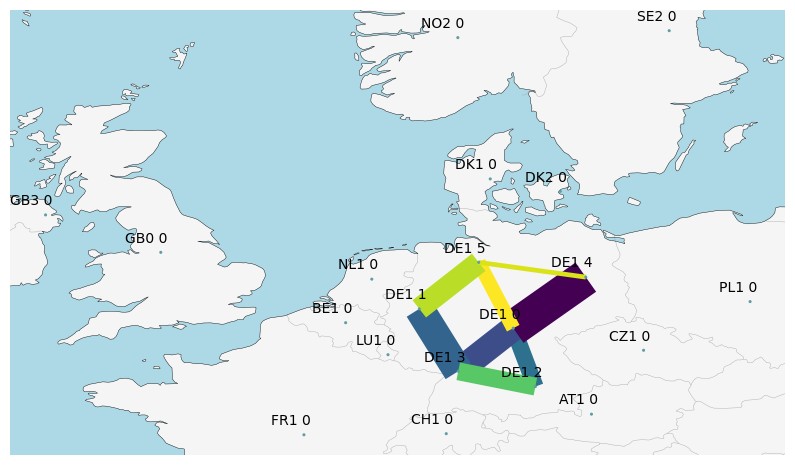

In [15]:
loading = (n.lines_t.p0.abs().mean().sort_index()/(n.lines.s_nom_opt*n.lines.s_max_pu).sort_index()).fillna(0.)

fig, ax = plt.subplots(
    figsize=(10,10),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

n.plot(
    ax=ax,
    branch_components=["Line"],
    line_widths=n.lines.s_nom_opt/1e3, #GW
    line_colors=loading,
    line_cmap=plt.cm.viridis,
    color_geomap=True,
    bus_sizes=0.003
)

bus = n.buses
region = []
for index, row in bus.iterrows():
    x = row['x']
    y = row['y']
    if "H2" in index:
        pass
    else:
        region.append(index)
        ax.annotate(
        index,
        xy=(x, y),
        xytext=(5, 5),  # Adjust the position of the annotation
        textcoords="offset points",
        ha='right', va='bottom'
    )

plt.show


## Installed Capacity Map Plot

In [16]:
#color list for installed cap
tech_list = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
tech_list.remove('load')
color_cap = []

for i in range(len(tech_list)):
    for j in range(len(n.carriers.index)):
        if tech_list[i] == n.carriers.index[j]:
            color_cap.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

cap = n.generators[n.generators['carrier']!='load'].groupby(['bus', 'carrier']).p_nom_opt.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\3847545614.py:9: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_cap.append(n.carriers.color[j])


In [17]:
color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}
color_map["Import/Export"] = '#133337'

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


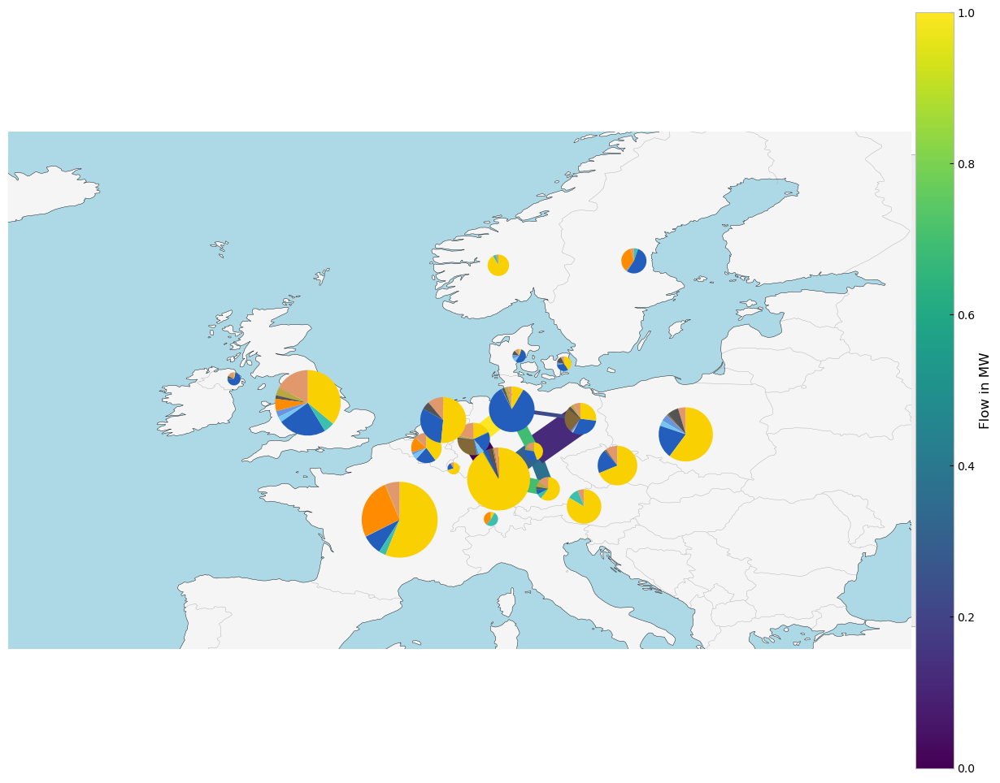

In [18]:
fig, ax = plt.subplots(
    figsize=(15,15),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

collection = n.plot(
    bus_sizes=cap / 5e4,
    bus_colors = color_map,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
        
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Generation Map Plot

In [19]:
#color list for energy generated 
tech_list_gen_table = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
colors_gen_table = []

for i in range(len(tech_list_gen_table)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen_table[i] == n.carriers.index[j]:
            colors_gen_table.append(n.carriers.color[j])
            break  # break the inner loop once a match is found 

#Adjust Load shedding's unit to MW from kW
#for column in n.generators_t.p.columns:
#    if column.endswith('load') and not column.endswith('H2 load'):
#        n.generators_t.p[column]/=1e3
        

gen = n.generators.assign(g=n.generators_t.p.mean()).groupby(["bus", "carrier"]).g.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\971004373.py:8: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen_table.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


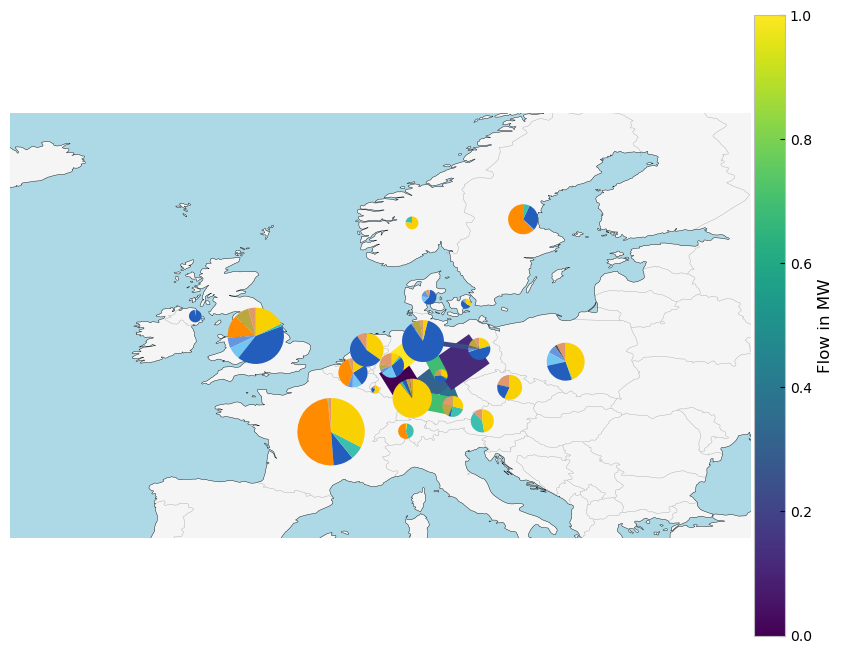

In [20]:
carriers = n.generators.carrier.unique()

plt.figure(figsize =(10,10))

collection = n.plot(
    bus_sizes=gen / 1e4,
    bus_colors = colors_gen_table,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Installed Capacity

<Figure size 640x480 with 0 Axes>

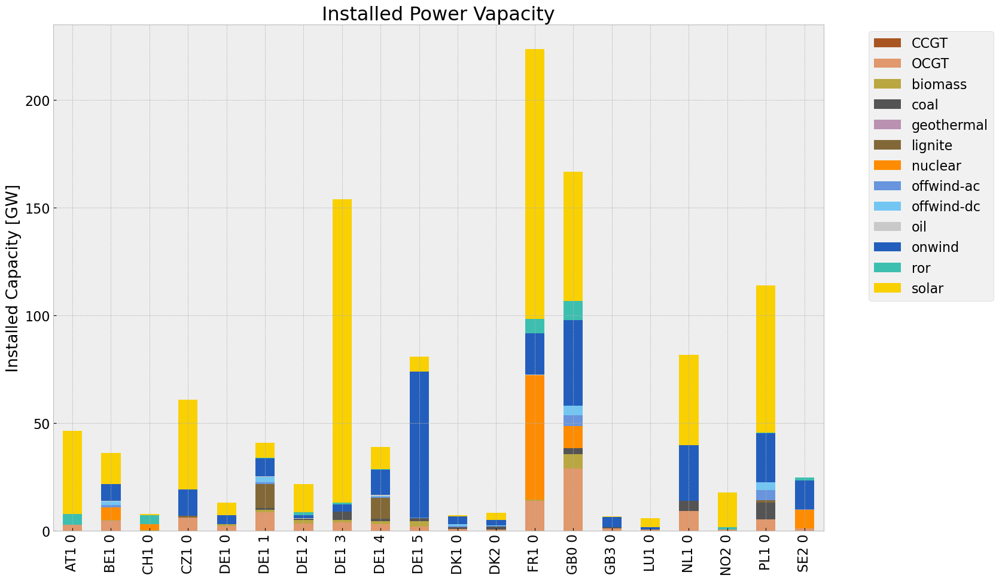

In [21]:
def inst_cap_table(n,colors):

    capacities = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Vapacity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_installed_cap.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    plt.show()

    

    return capacities

# consolidated istalled cap without load_shedding

#capacities_base = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_base.fillna(0, inplace=True)
#gen = (capacities_base.unstack()/1000).drop(columns=['load'],inplace=False)

capacities_base = inst_cap_table(n, color_cap)

<Figure size 640x480 with 0 Axes>

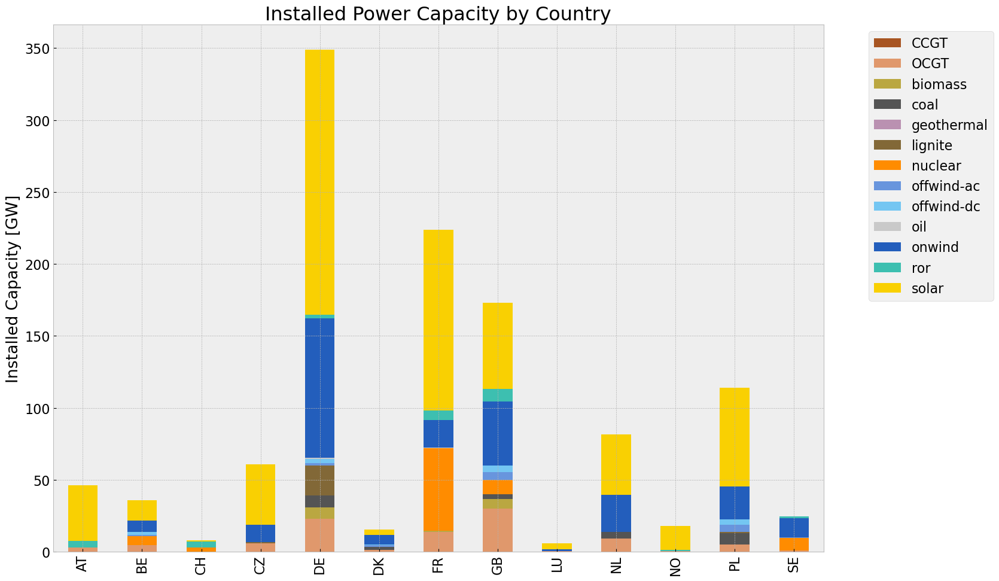

In [22]:
#aggregate installed capacities by country
def inst_cap_table_country(n,colors):
    
    model = n
    capacities = model.generators
    capacities['country'] = capacities['bus'].str[:2]
    capacities = capacities.groupby(['country', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=color_map,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Capacity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_installed_cap_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()
    
     

    return gen

cap_base_country= inst_cap_table_country(n, color_cap)

## Generation

<Figure size 640x480 with 0 Axes>

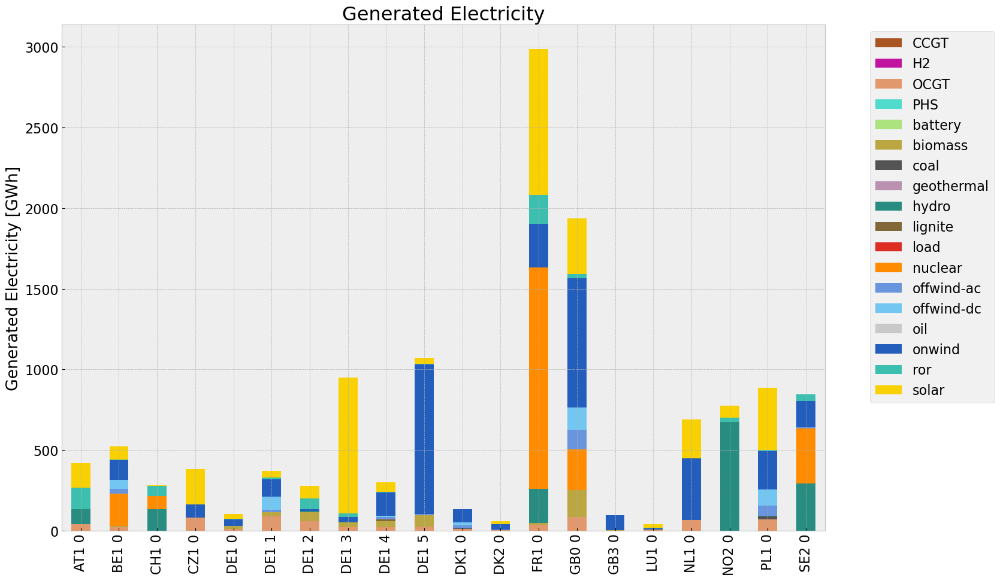

In [23]:
def gen_power_table(n):

    carrier_gen = list(n.generators.carrier.unique())
    carrier_sto = list(n.storage_units.carrier.unique())
    carrier = carrier_gen + carrier_sto

    gen_df = n.generators[["carrier","bus","p_nom_opt"]]
    sto_df = n.storage_units[["carrier","bus","p_nom_opt"]]
    tot_df = pd.concat([gen_df, sto_df])
    tot_series = pd.Series(index = tot_df.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    gen_sto = n.storage_units_t.p.sum()
    gen_gen = n.generators_t.p.sum()
    gen = pd.concat([gen_sto, gen_gen])
    gen = gen.clip(lower=0)

    for r in region:
            for tech in carrier:
                key = f"{r} {tech}"
                if key in gen.index:
                    try:
                        tot_series.loc[r, tech] = gen[key]
                    #print(generations.loc[r, tech])
                    except KeyError:
                        print('error')
    #tot_series.fillna(0, inplace=True)

    tot_df = (tot_series.unstack()/1000)
    tot_df.fillna(0,inplace = True)

    #define color dict for tech
    color_dict = {}

    for index, row in n.carriers.iterrows():
        key = index
        value = row['color']
        color_dict[key] = value

    #color list
    colors = [color_dict[cat] for cat in tot_df.columns]

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    tot_df.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=color_map,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_gen_elec.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()

    return tot_df

gen_base = gen_power_table(n)

<Figure size 640x480 with 0 Axes>

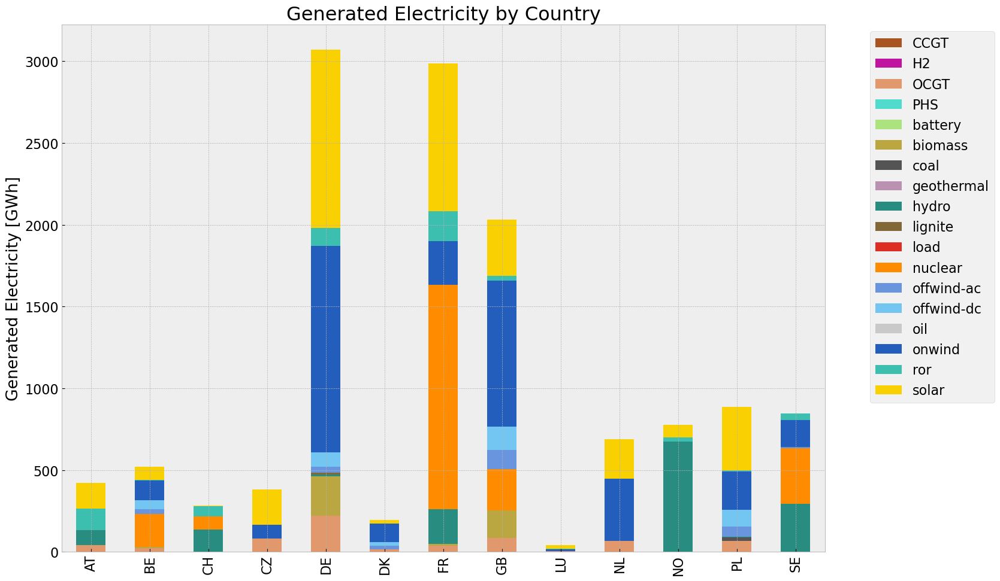

In [24]:
def gen_power_table_country(n):

    carrier_gen = list(n.generators.carrier.unique())
    carrier_sto = list(n.storage_units.carrier.unique())
    carrier = carrier_gen + carrier_sto

    gen_df = n.generators[["carrier","bus","p_nom_opt"]]
    sto_df = n.storage_units[["carrier","bus","p_nom_opt"]]
    tot_df = pd.concat([gen_df, sto_df])
    tot_series = pd.Series(index = tot_df.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    gen_sto = n.storage_units_t.p.sum()
    gen_gen = n.generators_t.p.sum()
    gen = pd.concat([gen_sto, gen_gen])
    gen = gen.clip(lower=0)

    for r in region:
            for tech in carrier:
                key = f"{r} {tech}"
                if key in gen.index:
                    try:
                        tot_series.loc[r, tech] = gen[key]
                    #print(generations.loc[r, tech])
                    except KeyError:
                        print('error')
    #tot_series.fillna(0, inplace=True)

    tot_df = (tot_series.unstack()/1000)
    tot_df.fillna(0,inplace = True)


    
    tot_df['country'] = tot_df.index.str[:2]
    tot_df = tot_df.groupby(['country']).sum()   
    #generations['load']/=1e3

    #define color dict for tech
    color_dict = {}

    for index, row in n.carriers.iterrows():
        key = index
        value = row['color']
        color_dict[key] = value

    #color list
    colors = [color_dict[cat] for cat in tot_df.columns]


    plt.figure()
    plt.rcParams.update({'font.size': 16})

    tot_df.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=color_map,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_gen_elec_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    plt.show()
    return tot_df

gen_base_country = gen_power_table_country(n)

## Snapshot

In [25]:
sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()

#links = n.links_t.p0.groupby(n.links.carrier, axis =1).sum().drop(['DC','H2 electrolysis'], axis=1, inplace =False).head()
tech_list_gen = pd.concat([tech_list_gen, sto], axis=1).columns.tolist()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\318663498.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\318663498.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()


In [26]:
colors_gen = []

for i in range(len(tech_list_gen)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen[i] == n.carriers.index[j]:
            colors_gen.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\4040974225.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen.append(n.carriers.color[j])


In [27]:
def gen_curve(n, start, end, colors,ctr):

    plt.rcParams.update({'font.size': 16})

    #import export 
    lines_ctr_bus0 = n.lines[n.lines['bus0'].str.startswith(ctr) & ~n.lines['bus1'].str.startswith(ctr)].index
    lines_ctr_bus1 = n.lines[n.lines['bus1'].str.startswith(ctr) & ~n.lines['bus0'].str.startswith(ctr)].index
    links_ctr_bus0 = n.links[n.links['bus0'].str.startswith(ctr) & ~n.links['bus1'].str.startswith(ctr)].index
    links_ctr_bus1 = n.links[n.links['bus1'].str.startswith(ctr) & ~n.links['bus0'].str.startswith(ctr)].index


    df_lines_ctr_bus0 = n.lines_t.p0[lines_ctr_bus0]
    df_lines_ctr_bus1 = n.lines_t.p1[lines_ctr_bus1]
    df_links_ctr_bus0 = n.links_t.p0[links_ctr_bus0]
    df_links_ctr_bus1 = n.links_t.p1[links_ctr_bus1]


    import_export = pd.concat([df_lines_ctr_bus0, df_lines_ctr_bus1, df_links_ctr_bus0, df_links_ctr_bus1], axis=1).sum(axis=1)*-1 #MW

    columns_gen = [col for col in  n.generators_t.p.columns if col.startswith(ctr)]
    p_country = n.generators_t.p[columns_gen]

    p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
    

    #add import color
    colors.append('#133337') #for Import

    #p_by_carrier['load'] /= 1e3

    #links fuel cell
    #links = n.links_t.p1.groupby(n.links.carrier, axis=1).sum().div(1e3)
    #links = links.drop(columns='DC', inplace=False)
    #links['H2 fuel cell']*=-1
       
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        col_sto = [col for col in  n.storage_units_t.p.columns if col.startswith(ctr)]
        sto_ctr = n.storage_units_t.p[col_sto]
        sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier['Import/Export'] = import_export 
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='168H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=color_map,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    p_pos = p_by_carrier.where(p_by_carrier>0).dropna(how='all', axis=1).loc[time]
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    col_load = [col for col in  n.loads_t.p_set.columns if col.startswith(ctr)]
    loads_ctr = n.loads_t.p_set[col_load]
    loads = loads_ctr.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")
    ax.set_ylim(min(charge.sum(axis=1))+(min(charge.sum(axis=1)/100*10)),max(p_pos.sum(axis=1))+(max(p_pos.sum(axis =1))/100*30))
    # Save plot to the current working directory
    fig.tight_layout()
    filename = f"{n.name}_gen_{start}_to_{end}.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    
    

In [28]:
#e_balance = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC",:].droplevel(2)
#e_balance.to_excel('energybalance.xlsx', index=True) 


In [29]:
#tes = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :].droplevel(2)
#tes.to_csv('energybalance.csv', index=True)

In [30]:
#n.loads_t.p_set.sum(axis=1).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].div(1e3).plot(ax=ax, c='k',grid=True)


In [31]:
#p_by_carrier.where(p_by_carrier>0).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].sum(axis=1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\923320227.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\923320227.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\923320227.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\923320227.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
C:\Users\

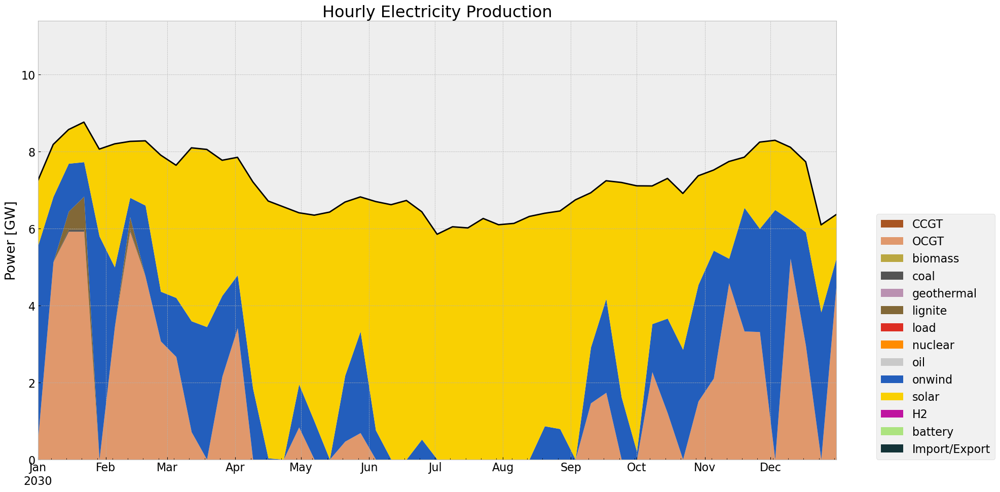

In [32]:
# winter
gen_curve(n, '2030-01-01', '2030-12-31', colors_gen,'CZ')

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\923320227.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\923320227.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\923320227.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\923320227.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Users\

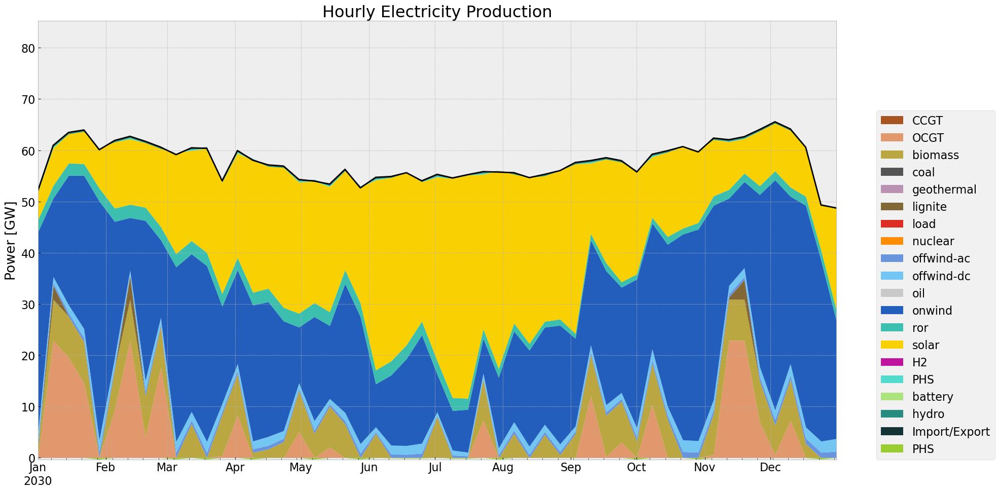

In [33]:
#summer
gen_curve(n, '2030-01-01', '2030-12-31', colors_gen,'DE')

In [34]:
def gen_curve_tot(n, start, end, colors):

    plt.rcParams.update({'font.size': 16})

    p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
    
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='168H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    loads = n.loads_t.p_set.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    ax.set_ylim(-50,370)
    fig.tight_layout()

    # Adjust the spacing around the plot (add extra space at the top)
    fig.subplots_adjust(top=0.95, right=0.85, left = 0.05)
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")

    filename = f"{n.name}_gen_{start}_to_{end}_total.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    
    plt.savefig(output_path)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\2732365766.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\2732365766.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\2732365766.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\2732365766.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, 

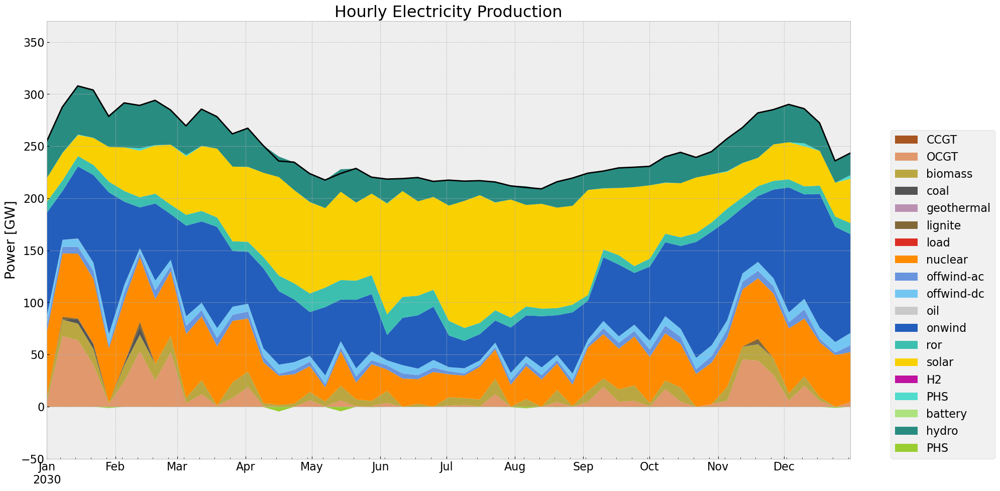

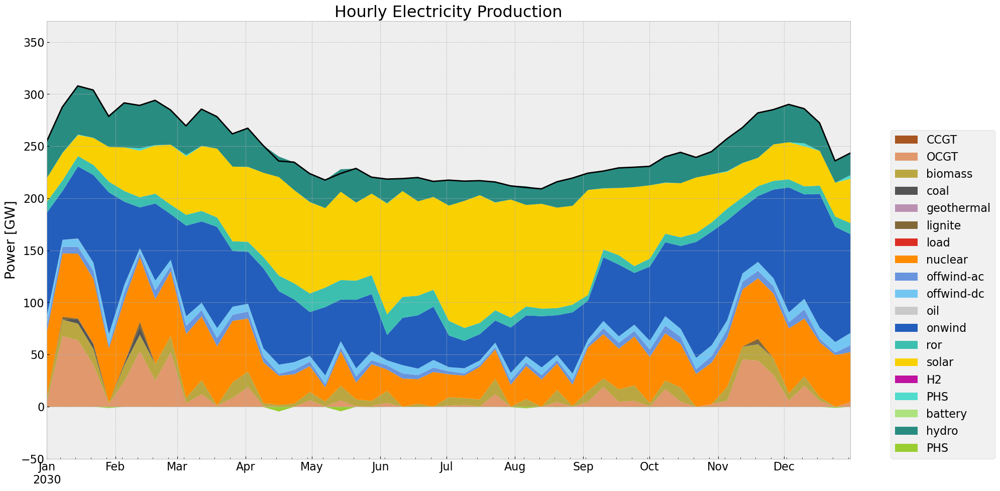

In [35]:
#generation curve all countries
#winter
gen_curve_tot(n, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n, '2030-01-01', '2030-12-31', colors_gen)

## Storage

In [36]:
def inst_store_table(n):
    
    plt.rcParams.update({'font.size': 16})
    storage = n.storage_units
    storage['country'] = storage['bus'].str[:2]

    (storage.groupby(['country','carrier']).p_nom_opt.sum().unstack()/1000).plot.bar(figsize=(17,10),
                                stacked=True,
                                color=["#bf13a0","#51dbcc","#ace37f","#298c81"],
                                grid=True,
                                xlabel="",
                                ylabel="Installed capacity [GW]",
                                title=f"Installed Power Capacity of Storage Systems By Country",
                                #ylim=[0,20]
    )
    store = storage.groupby(['country','carrier']).p_nom_opt.sum()/1000 #GW
    store.fillna(0, inplace=True)

    plt.tight_layout()

    filename = f"{n.name}_installed_storage.png" if hasattr(n, 'name') else "installed_storage.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    return store

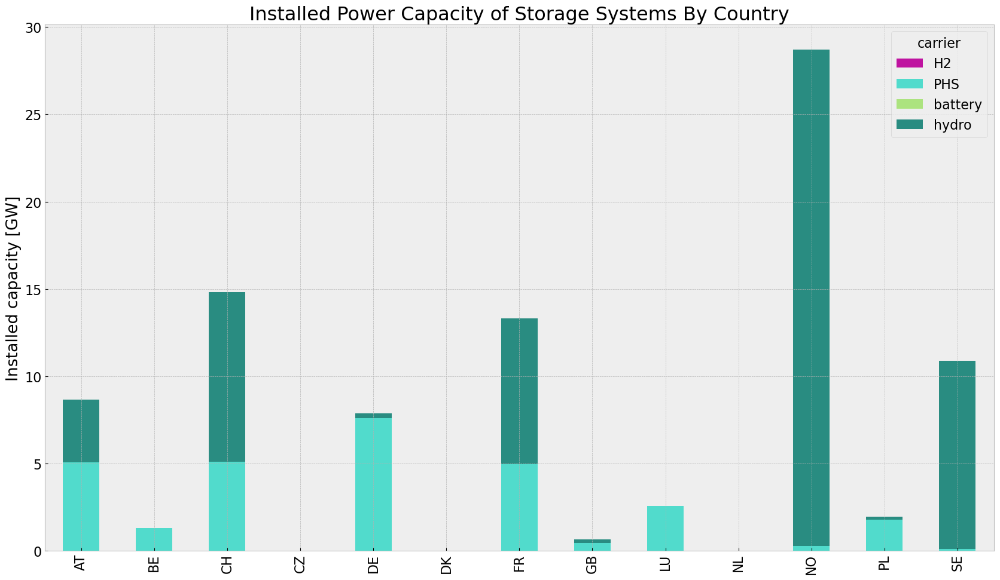

In [37]:
store_base = inst_store_table(n)

In [38]:
def state_of_charge_plot(n, start_date, end_date):
    
    soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)

    soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    time = pd.date_range(start= start_date , end= end_date, freq='168H')

    soc.loc[time].plot(ax=ax,
        grid=True,
        ylabel="State of charge [GWh]",
        xlabel="Time",
        title=f"State of charge of Storage Systems",
        linewidth=1.5,
    )
    plt.tight_layout()
    filename = f"{n.name}_soc.png" if hasattr(n, 'name') else "soc.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)



plt.show(n)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\4184885543.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\4184885543.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\4184885543.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='168H')


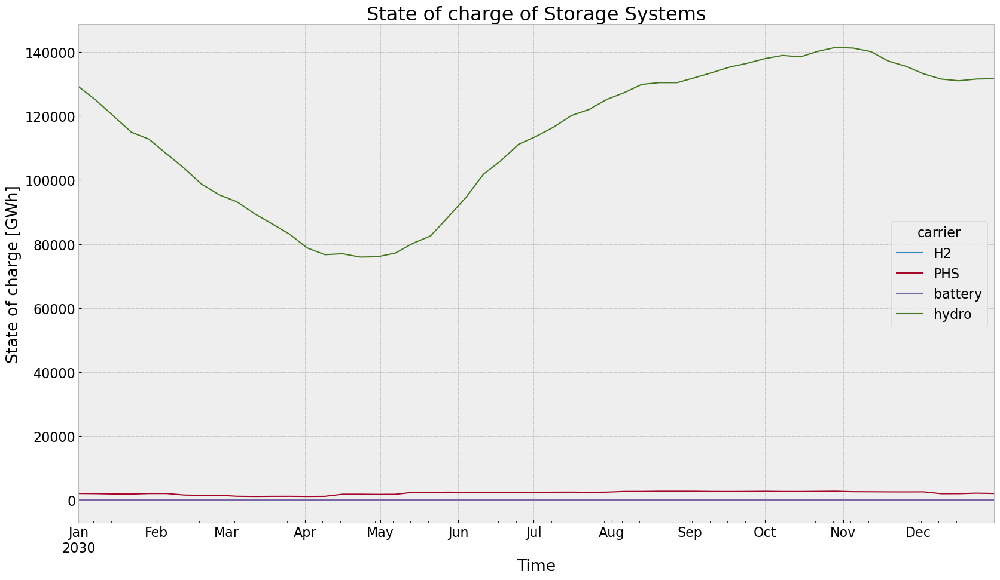

In [39]:
state_of_charge_plot(n, '2030-01-01', '2030-12-31')

## Electricity Price

In [40]:
def price_dur_curve_plot(n):

    #buses without store
    columns_to_keep =[]

    for i in n.buses_t.marginal_price.columns.tolist():
        if not i.endswith('H2'):
            columns_to_keep.append(i)
    
    price_dur_curve = pd.DataFrame()
    for region in columns_to_keep:
        price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    price_dur_curve.plot(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Time steps",
                    title=f"Duration curves of the marginal price",
                    linewidth=3,
)
    plt.tight_layout()
    filename = f"{n.name}_pd_curve.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
plt.show()

In [41]:
#columns_to_keep =[]

#for i in n.buses_t.marginal_price.columns.tolist():
    #if not i.endswith('H2'):
        #columns_to_keep.append(i)

#buses without store
#columns_to_keep =[]

#price_dur_curve = pd.DataFrame()
#for region in columns_to_keep:
    #price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)


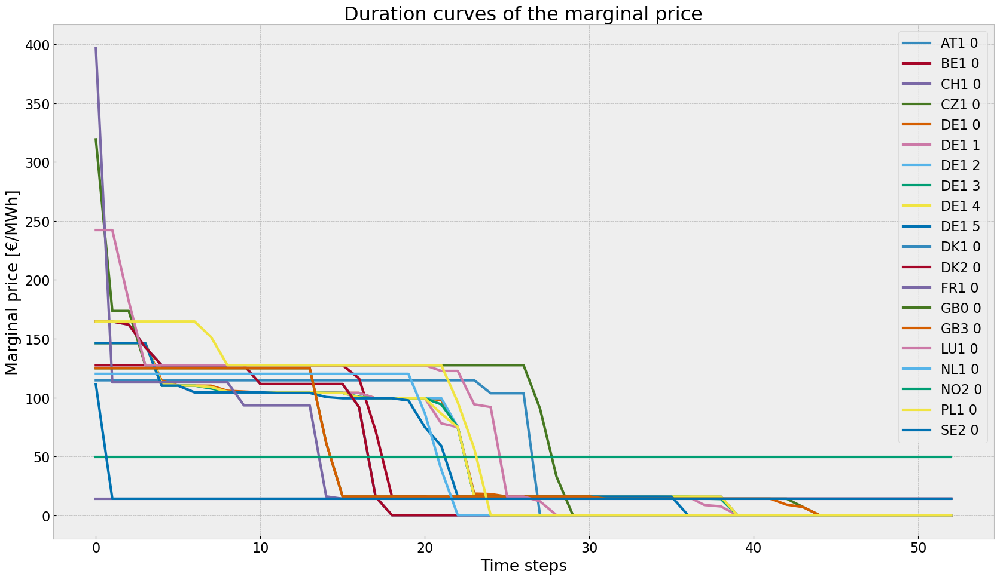

In [42]:
price_dur_curve_plot(n)

In [43]:
#demand weighted average electricity price
def price_regions_table(n):

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))
    
    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    
    price_df.plot.bar(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Region",
                    title=f"Demand-Weighted Average Marginal Price",
                    linewidth=3,
    )
    fig.tight_layout()                
    filename = f"{n.name}_average_eprice.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)                                    
    


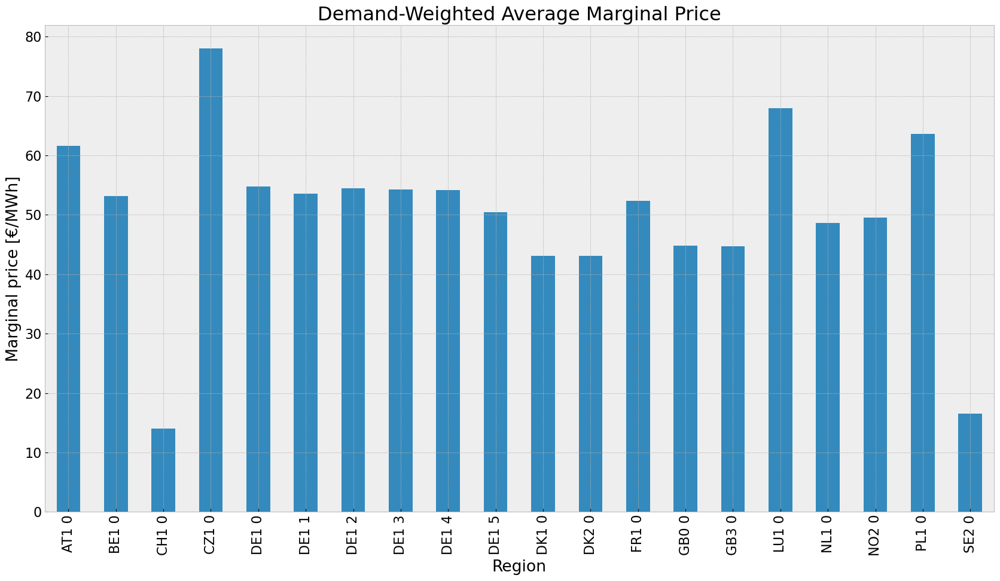

In [44]:
price_regions_table(n)

In [45]:
def price_regions(n):
    # Assuming 'n.buses_t.marginal_price' returns a DataFrame or similar structure with 'mean()' method

    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    #hprice = mean_p.filter(like='H2')
    #eprice = mean_p.drop(hprice.index)

    # Setup figure and subplots with 1 row and 2 columns
    fig, ax = plt.subplots(subplot_kw={"projection": ccrs.PlateCarree()}, figsize=(8, 8))

    # Plot for eprice
    hb= plt.hexbin(
        n.buses.x,
        n.buses.y,
        gridsize=20,
        C=price_df,
        cmap=plt.cm.jet,
        zorder=3,
    )

    n.plot(ax=ax, line_widths=pd.Series(0.5, n.lines.index), bus_sizes=0)  # Plot network on the second subplot

    ax.set_title("Demand-Weighted Average Marginal Price")
    
    cb = fig.colorbar(hb, ax=ax, location='bottom')
    cb.set_label("Mean Electricity Marginal Price (EUR/MWh)")

    fig.tight_layout()
    filename = f"{n.name}_price_map.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


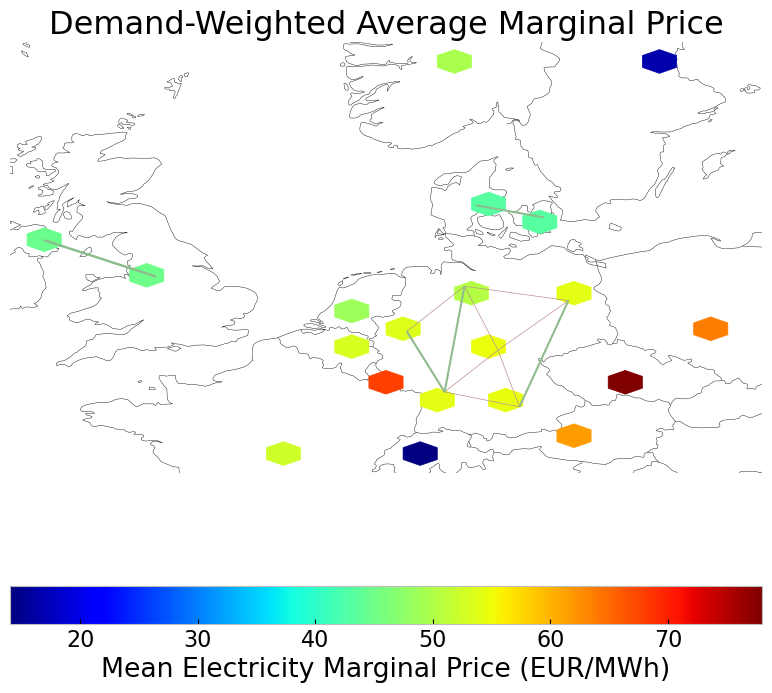

In [46]:
price_regions(n)

## Emission

In [47]:
def em_table(n):
    carrier = n.generators.carrier.unique()
    df_tot_generation = n.generators_t.p.sum()

    generations = pd.Series(index = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    for r in region:
        for tech in carrier:
            key = f"{r} {tech}"
            if key in df_tot_generation.index:
                try:
                    generations.loc[r, tech] = df_tot_generation[key]
                    #print(generations.loc[r, tech])
                except KeyError:
                    print('error')
    generations.fillna(0, inplace=True)

    generations = (generations.unstack())#MWh

    #mean efficiency of each carrier
    eff = n.generators.groupby('carrier').efficiency.mean()

    e = generations.sum()
    emission = []

    for index in e.index:
        for index_c in n.carriers.index:
            for index_eff in eff.index:
                if index == index_c == index_eff:
                    em = n.carriers.loc[index_c,"co2_emissions"]
                    emission.append(em)

    df = e.to_frame()
    df.rename(columns={0: 'Generation in MWh'}, inplace=True)
    df['efficiency'] = eff
    df['emissions in Tonnes CO2/MWh'] = emission
    df['emissions in Tonnes CO2']= df['Generation in MWh']/df['efficiency']*df['emissions in Tonnes CO2/MWh']
    df['emissions in Tonnes CO2'].sum() 
    return df

em_base =em_table(n)
em_base

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,6.397721e+05,0.451621,0.1980,280489.463097
biomass,4.275040e+05,0.468000,0.0000,0.000000
coal,1.938180e+04,0.329908,0.3361,19745.571853
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,1.312300e+04,0.337285,0.4069,15831.572723
load,0.000000e+00,1.000000,0.0000,0.000000
nuclear,2.250254e+06,0.326600,0.0000,0.000000
offwind-ac,2.751598e+05,1.000000,0.0000,0.000000


# PV Cut Scenario



In [48]:
def extract_carriers(column_names, carriers):
    """
    Filters columns that match the specified carrier names.
    
    Parameters:
    - column_names: List of column names in the DataFrame.
    - carriers: List of carrier names to match.
    
    Returns:
    - List of column names that match the carriers.
    """
    return [col for col in column_names if any(carrier in col for carrier in carriers)]

def max_generation_period(df, num_days, carriers):
    """
    Iterates through the DataFrame and finds the start date with the maximum generation sum for specified carriers over a given number of days.
    
    Parameters:
    - df: DataFrame containing the data.
    - num_days: The total number of days over which to sum the generation.
    - carriers: List of carrier names to be summed (e.g., ['CCGT', 'OCGT', 'biomass']).

    Returns:
    - Start date with the highest generation and the corresponding sum.
    """
    # Determine the timestep in days based on the DataFrame's index
    timestep = (df.index[1] - df.index[0]).total_seconds() / 86400  # Convert seconds to days
    num_rows = round(num_days / timestep)  # Calculate number of rows needed, round to nearest whole number
    
    # Extract column names matching the specified carriers
    relevant_columns = extract_carriers(df.columns, carriers)
    
    max_generation = 0
    start_date_with_max_generation = None

    # Iterate over each row in the DataFrame
    for start_idx in range(len(df)):
        #print(start_idx)
        # Ensure we do not exceed the DataFrame's length
        if start_idx + num_rows <= len(df):
            # Sum the generation for specified carriers over the period
            current_sum = df.iloc[start_idx:start_idx + num_rows][relevant_columns].sum().sum()
            #print(df.index[start_idx],current_sum)
            # Check if the current sum is the highest found so far
            if current_sum > max_generation:
                max_generation = current_sum
                start_date_with_max_generation = df.index[start_idx]

    return start_date_with_max_generation

def allow_inv(n1,n,country):
    #delete line expansion global constraint
    if 'lv_limit' in n1.global_constraints.index:
        n1.global_constraints = n1.global_constraints.drop('lv_limit')

    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, row in n1.generators.iterrows():
        if row['p_nom_extendable'] == True:  
            n1.generators.at[index, 'p_nom_min'] = n.generators.at[index, 'p_nom_opt']
            n1.generators.at[index, 'p_nom_extendable'] = True
        else:
            n1.generators.at[index, 'p_nom'] = n.generators.at[index, 'p_nom_opt']
            n1.generators.at[index, 'p_nom_extendable'] = False

    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, row in n1.storage_units.iterrows():
        if row['p_nom_extendable'] == True:
            n1.storage_units.at[index, 'p_nom_min'] = n.storage_units.at[index, 'p_nom_opt'] 
            n1.storage_units.at[index, 'p_nom_extendable'] = True
        else:
            n1.storage_units.at[index, 'p_nom'] = n.storage_units.at[index, 'p_nom_opt']
            n1.storage_units.at[index, 'p_nom_extendable'] = False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, row in n1.lines.iterrows():
        if row['carrier'] == 'AC':
            n1.lines.at[index, 's_nom_min'] = n.lines.at[index, 's_nom_opt']
            n1.lines.at[index, 's_nom_extendable'] = True 
        else:
            n1.lines.at[index, 's_nom'] = n.lines.at[index, 's_nom_opt']
            n1.lines.at[index, 's_nom_extendable'] = False 
    
    #set the optimal capacity of links from the base scenario as the new minimum capacity 
    for index, row in n1.links.iterrows():
        if row['carrier'] == 'DC':
            n1.links.at[index, 'p_nom_min'] = n.links.at[index, 'p_nom_opt']
            n1.links.at[index, 'p_nom_extendable'] = True 
        else:
            n1.links.at[index, 'p_nom'] = n.links.at[index, 'p_nom_opt']
            n1.links.at[index, 'p_nom_extendable'] = False 
            
def no_inv(n2,n):
    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, value in n2.generators.p_nom_extendable.items():
        if value:  
            n2.generators.at[index, 'p_nom'] = n.generators.at[index, 'p_nom_opt']
            #n2.generators.at[index, 'p_nom_max'] = n.generators.at[index, 'p_nom_opt']
            n2.generators.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, value in n2.storage_units.p_nom_extendable.items():
        if value:  
            n2.storage_units.at[index, 'p_nom'] = n.storage_units.at[index, 'p_nom_opt']
            #n2.storage_units.at[index, 'p_nom_max'] = n.storage_units.at[index, 'p_nom_opt']
            n2.storage_units.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of stores from the base scenario as the new minimum capacity 
    for index, value in n2.stores.e_nom_extendable.items():
        if value:  
            n2.stores.at[index, 'e_nom'] = n.stores.at[index, 'e_nom_opt']
            #n2.stores.at[index, 'e_nom_max'] = n.stores.at[index, 'e_nom_opt']
            n2.stores.at[index, 'e_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.lines.s_nom_extendable.items():
        if value:  
            n2.lines.at[index, 's_nom'] = n.lines.at[index, 's_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.lines.at[index, 's_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.links.p_nom_extendable.items():
        if value:  
            n2.links.at[index, 'p_nom'] = n.links.at[index, 'p_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.links.at[index, 'p_nom_extendable'] =False

In [49]:
#p_max_pu of offwind generators across all regions are subtracted by 10% from 01.06.2013 to 31.12.13
#cut_start=pd.to_datetime('2013-02-01 00:00:00')
duration = 180 #days
#cut_end = pd.to_datetime('2013-12-31 21:00:00')
reductionto = 0.25


def pvscenario(n, carriers_to_cut, duration, reductionto):
    #copy network
    n_new=n.copy()

    #define cut start based on the period with max generation of the chosen carrier    
    cut_start = max_generation_period(n.generators_t.p, duration, carriers_to_cut)
    print(f'cut_start: {cut_start}')
    cut_end = cut_start + pd.Timedelta(days= duration)
    #implement pv cut
    for column in n_new.generators_t.p_max_pu.columns:
            if column.endswith('solar'):
                    for index,row in n_new.generators_t.p_max_pu[column].items():
                            if index >= cut_start and index <= cut_end:
                                    new_p_max_pu = n_new.generators_t.p_max_pu.at[index, column] * reductionto #0.9
                                    n_new.generators_t.p_max_pu.at[index, column] = new_p_max_pu
                                    if new_p_max_pu<0:
                                        n_new.generators_t.p_max_pu.at[index, column] = 0
    return n_new
        

## 1. Model: perfect foresight with allowed additional investment

In [50]:
carriers_to_cut= ['solar']
n1 = pvscenario(n, carriers_to_cut, duration, reductionto)
n1.name = f'inv_{contingency}'  

cut_start: 2013-03-12 00:00:00


In [51]:
country = 'DE'

### Allow investment

In [52]:
allow_inv(n1,n, country)

In [53]:
n1.optimize.create_model()
add_EQ_constraints(n1, o)
n1.optimize.solve_model(solver_name='gurobi')

Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\3994677034.py:37: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  @ n.loads_t.p_set.groupby(lgrouper, axis=1).sum()
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\3994677034.py:41: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  @ n.storage_units_t.inflow.groupby(sgrouper, axis=1).sum()
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 101.69it/s]
INFO:linopy.io: Writing time: 0.88s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fwkq6ytn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fwkq6ytn.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 54717 rows, 25581 columns, 113307 nonzeros


INFO:gurobipy:obj: 54717 rows, 25581 columns, 113307 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 54717 rows, 25581 columns and 113307 nonzeros


INFO:gurobipy:Optimize a model with 54717 rows, 25581 columns and 113307 nonzeros


Model fingerprint: 0x49274975


INFO:gurobipy:Model fingerprint: 0x49274975


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 3e+02]


INFO:gurobipy:  Matrix range     [1e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 38130 rows and 5852 columns


INFO:gurobipy:Presolve removed 38130 rows and 5852 columns


Presolve time: 0.09s


INFO:gurobipy:Presolve time: 0.09s


Presolved: 16587 rows, 19729 columns, 64494 nonzeros


INFO:gurobipy:Presolved: 16587 rows, 19729 columns, 64494 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.05s


INFO:gurobipy:Ordering time: 0.05s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 54


INFO:gurobipy: Dense cols : 54


 AA' NZ     : 1.563e+05


INFO:gurobipy: AA' NZ     : 1.563e+05


 Factor NZ  : 5.406e+05 (roughly 20 MB of memory)


INFO:gurobipy: Factor NZ  : 5.406e+05 (roughly 20 MB of memory)


 Factor Ops : 3.792e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.792e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.33700109e+17 -6.87401855e+17  1.25e+10 1.63e+05  3.57e+14     0s


INFO:gurobipy:   0   5.33700109e+17 -6.87401855e+17  1.25e+10 1.63e+05  3.57e+14     0s


   1   3.86670875e+17 -5.68909459e+17  8.48e+09 1.34e+05  2.70e+14     0s


INFO:gurobipy:   1   3.86670875e+17 -5.68909459e+17  8.48e+09 1.34e+05  2.70e+14     0s


   2   2.48281987e+17 -1.66235312e+17  4.37e+09 2.77e+04  1.09e+14     0s


INFO:gurobipy:   2   2.48281987e+17 -1.66235312e+17  4.37e+09 2.77e+04  1.09e+14     0s


   3   9.76113293e+16 -3.00460240e+16  6.44e+08 5.15e+03  1.85e+13     0s


INFO:gurobipy:   3   9.76113293e+16 -3.00460240e+16  6.44e+08 5.15e+03  1.85e+13     0s


   4   2.03334523e+16 -3.36396593e+15  2.84e+07 5.36e+02  1.41e+12     0s


INFO:gurobipy:   4   2.03334523e+16 -3.36396593e+15  2.84e+07 5.36e+02  1.41e+12     0s


   5   6.48185774e+15 -1.49874340e+14  4.95e+06 7.45e-01  2.46e+11     0s


INFO:gurobipy:   5   6.48185774e+15 -1.49874340e+14  4.95e+06 7.45e-01  2.46e+11     0s


   6   2.14481843e+14 -6.43681892e+13  1.63e+05 1.36e-04  9.39e+09     0s


INFO:gurobipy:   6   2.14481843e+14 -6.43681892e+13  1.63e+05 1.36e-04  9.39e+09     0s


   7   9.62559088e+12 -1.50697545e+13  6.20e+03 2.48e-06  6.50e+08     0s


INFO:gurobipy:   7   9.62559088e+12 -1.50697545e+13  6.20e+03 2.48e-06  6.50e+08     0s


   8   2.83579867e+12 -4.74234074e+12  1.26e+03 7.27e-07  1.85e+08     0s


INFO:gurobipy:   8   2.83579867e+12 -4.74234074e+12  1.26e+03 7.27e-07  1.85e+08     0s


   9   1.26933000e+12 -1.77195627e+12  4.46e+02 2.68e-07  7.26e+07     0s


INFO:gurobipy:   9   1.26933000e+12 -1.77195627e+12  4.46e+02 2.68e-07  7.26e+07     0s


  10   7.50284097e+11 -8.11574946e+11  2.15e+02 1.31e-07  3.69e+07     1s


INFO:gurobipy:  10   7.50284097e+11 -8.11574946e+11  2.15e+02 1.31e-07  3.69e+07     1s


  11   4.33958216e+11 -3.28458760e+11  1.06e+02 5.91e-08  1.79e+07     1s


INFO:gurobipy:  11   4.33958216e+11 -3.28458760e+11  1.06e+02 5.91e-08  1.79e+07     1s


  12   2.65737997e+11 -1.09648338e+11  5.21e+01 2.63e-08  8.80e+06     1s


INFO:gurobipy:  12   2.65737997e+11 -1.09648338e+11  5.21e+01 2.63e-08  8.80e+06     1s


  13   1.86354360e+11 -6.19237860e+10  2.83e+01 1.95e-08  5.81e+06     1s


INFO:gurobipy:  13   1.86354360e+11 -6.19237860e+10  2.83e+01 1.95e-08  5.81e+06     1s


  14   1.38243876e+11  5.88487020e+09  1.49e+01 9.84e-09  3.09e+06     1s


INFO:gurobipy:  14   1.38243876e+11  5.88487020e+09  1.49e+01 9.84e-09  3.09e+06     1s


  15   1.11655267e+11  4.07268666e+10  8.08e+00 4.89e-09  1.66e+06     1s


INFO:gurobipy:  15   1.11655267e+11  4.07268666e+10  8.08e+00 4.89e-09  1.66e+06     1s


  16   9.70260590e+10  6.19633843e+10  4.37e+00 1.91e-09  8.18e+05     1s


INFO:gurobipy:  16   9.70260590e+10  6.19633843e+10  4.37e+00 1.91e-09  8.18e+05     1s


  17   8.87325849e+10  6.80545288e+10  2.54e+00 1.08e-09  4.82e+05     1s


INFO:gurobipy:  17   8.87325849e+10  6.80545288e+10  2.54e+00 1.08e-09  4.82e+05     1s


  18   8.49721372e+10  7.09366132e+10  1.72e+00 7.12e-10  3.27e+05     1s


INFO:gurobipy:  18   8.49721372e+10  7.09366132e+10  1.72e+00 7.12e-10  3.27e+05     1s


  19   8.08137590e+10  7.41073195e+10  7.95e-01 3.13e-10  1.56e+05     1s


INFO:gurobipy:  19   8.08137590e+10  7.41073195e+10  7.95e-01 3.13e-10  1.56e+05     1s


  20   7.93204715e+10  7.53041178e+10  4.88e-01 1.69e-10  9.37e+04     1s


INFO:gurobipy:  20   7.93204715e+10  7.53041178e+10  4.88e-01 1.69e-10  9.37e+04     1s


  21   7.82892580e+10  7.59766165e+10  2.75e-01 9.24e-11  5.39e+04     1s


INFO:gurobipy:  21   7.82892580e+10  7.59766165e+10  2.75e-01 9.24e-11  5.39e+04     1s


  22   7.76859240e+10  7.65505117e+10  1.56e-01 6.62e-11  2.65e+04     1s


INFO:gurobipy:  22   7.76859240e+10  7.65505117e+10  1.56e-01 6.62e-11  2.65e+04     1s


  23   7.71440005e+10  7.67476287e+10  5.13e-02 7.60e-11  9.24e+03     1s


INFO:gurobipy:  23   7.71440005e+10  7.67476287e+10  5.13e-02 7.60e-11  9.24e+03     1s


  24   7.69435887e+10  7.68122676e+10  1.59e-02 6.24e-11  3.06e+03     1s


INFO:gurobipy:  24   7.69435887e+10  7.68122676e+10  1.59e-02 6.24e-11  3.06e+03     1s


  25   7.68629969e+10  7.68378309e+10  2.60e-03 1.11e-10  5.87e+02     1s


INFO:gurobipy:  25   7.68629969e+10  7.68378309e+10  2.60e-03 1.11e-10  5.87e+02     1s


  26   7.68496239e+10  7.68439359e+10  6.38e-04 6.69e-11  1.33e+02     1s


INFO:gurobipy:  26   7.68496239e+10  7.68439359e+10  6.38e-04 6.69e-11  1.33e+02     1s


  27   7.68471073e+10  7.68446897e+10  2.86e-04 9.54e-11  5.64e+01     1s


INFO:gurobipy:  27   7.68471073e+10  7.68446897e+10  2.86e-04 9.54e-11  5.64e+01     1s


  28   7.68451532e+10  7.68448924e+10  3.03e-05 6.13e-11  6.08e+00     1s


INFO:gurobipy:  28   7.68451532e+10  7.68448924e+10  3.03e-05 6.13e-11  6.08e+00     1s


  29   7.68449587e+10  7.68449351e+10  3.02e-05 6.39e-11  5.48e-01     1s


INFO:gurobipy:  29   7.68449587e+10  7.68449351e+10  3.02e-05 6.39e-11  5.48e-01     1s


  30   7.68449451e+10  7.68449410e+10  1.33e-05 1.97e-10  9.53e-02     1s


INFO:gurobipy:  30   7.68449451e+10  7.68449410e+10  1.33e-05 1.97e-10  9.53e-02     1s


  31   7.68449424e+10  7.68449419e+10  1.58e-06 8.63e-11  1.18e-02     1s


INFO:gurobipy:  31   7.68449424e+10  7.68449419e+10  1.58e-06 8.63e-11  1.18e-02     1s


  32   7.68449420e+10  7.68449420e+10  3.28e-07 5.31e-11  7.36e-05     1s


INFO:gurobipy:  32   7.68449420e+10  7.68449420e+10  3.28e-07 5.31e-11  7.36e-05     1s


  33   7.68449420e+10  7.68449420e+10  4.81e-09 1.14e-10  6.67e-07     1s


INFO:gurobipy:  33   7.68449420e+10  7.68449420e+10  4.81e-09 1.14e-10  6.67e-07     1s


  34   7.68449420e+10  7.68449420e+10  1.96e-10 1.05e-09  8.91e-09     1s


INFO:gurobipy:  34   7.68449420e+10  7.68449420e+10  1.96e-10 1.05e-09  8.91e-09     1s


INFO:gurobipy:


Barrier solved model in 34 iterations and 1.01 seconds (0.44 work units)


INFO:gurobipy:Barrier solved model in 34 iterations and 1.01 seconds (0.44 work units)


Optimal objective 7.68449420e+10


INFO:gurobipy:Optimal objective 7.68449420e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    9453 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:    9453 DPushes remaining with DInf 0.0000000e+00                 1s


       0 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:Warning: Markowitz tolerance tightened to 0.5


INFO:gurobipy:


     537 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:     537 PPushes remaining with PInf 0.0000000e+00                 1s


       0 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 1s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 3.9805326e-10      1s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 3.9805326e-10      1s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    5012    7.6844942e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    5012    7.6844942e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 5012 iterations and 1.19 seconds (0.47 work units)


INFO:gurobipy:Solved in 5012 iterations and 1.19 seconds (0.47 work units)


Optimal objective  7.684494197e+10


INFO:gurobipy:Optimal objective  7.684494197e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 25581 primals, 54717 duals
Objective: 7.68e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

('ok', 'optimal')

In [54]:
#n1.optimize(solver_name= "gurobi")
#filename = f'inv_{contingency}.nc'
#n1 = import_nc_file(directory, filename)
n1.name = f'inv_{contingency}'

### Export model for later use

In [55]:
file = f"{n1.name}.nc"
output_path = os.path.join(os.getcwd(), file)
n1.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network inv_pv.nc has lines, links, generators, carriers, loads, storage_units, buses


<xarray.Dataset> Size: 233kB
Dimensions:                               (snapshots: 53,
                                           investment_periods: 0, lines_i: 8,
                                           lines_t_p0_i: 8, lines_t_p1_i: 8,
                                           lines_t_loss_i: 8, links_i: 6,
                                           links_t_p0_i: 3, links_t_p1_i: 3,
                                           generators_i: 261,
                                           ...
                                           storage_units_t_p_dispatch_i: 23,
                                           storage_units_t_p_store_i: 13,
                                           storage_units_t_state_of_charge_i: 65,
                                           buses_i: 20, buses_t_p_i: 20,
                                           buses_t_v_ang_i: 6,
                                           buses_t_marginal_price_i: 20)
Coordinates: (12/26)
  * snapshots                             (snapshots) int64 424B 0 1 2 ... 51 52
  * investment_periods                    (investment_periods) int64 0B 
  * lines_i                               (lines_i) object 64B '12' ... '22'
  * lines_t_p0_i                          (lines_t_p0_i) object 64B '12' ... ...
  * lines_t_p1_i                          (lines_t_p1_i) object 64B '12' ... ...
  * lines_t_loss_i                        (lines_t_loss_i) object 64B '12' .....
    ...                                    ...
  * storage_units_t_p_store_i             (storage_units_t_p_store_i) object 104B ...
  * storage_units_t_state_of_charge_i     (storage_units_t_state_of_charge_i) object 520B ...
  * buses_i                               (buses_i) object 160B 'AT1 0' ... '...
  * buses_t_p_i                           (buses_t_p_i) object 160B 'AT1 0' ....
  * buses_t_v_ang_i                       (buses_t_v_ang_i) object 48B 'DE1 0...
  * buses_t_marginal_price_i              (buses_t_marginal_price_i) object 160B ...
Data variables: (12/100)
    snapshots_snapshot                    (snapshots) datetime64[ns] 424B 201...
    snapshots_objective                   (snapshots) float64 424B 168.0 ... ...
    snapshots_generators                  (snapshots) float64 424B 168.0 ... ...
    snapshots_stores                      (snapshots) float64 424B 168.0 ... ...
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    buses_country                         (buses_i) object 160B 'AT' ... 'SE'
    buses_control                         (buses_i) object 160B 'Slack' ... 'PQ'
    buses_generator                       (buses_i) object 160B 'AT1 0 CCGT' ...
    buses_t_p                             (snapshots, buses_t_p_i) float64 8kB ...
    buses_t_v_ang                         (snapshots, buses_t_v_ang_i) float64 3kB ...
    buses_t_marginal_price                (snapshots, buses_t_marginal_price_i) float64 8kB ...
Attributes:
    network__linearized_uc:      0
    network__multi_invest:       0
    network_name:                inv_pv
    network_objective:           76844941967.29019
    network_objective_constant:  20091148459.202404
    network_pypsa_version:       0.27.0
    network_srid:                4326
    crs:                         {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"Worl...
    meta:                        {}

In [56]:
tot_cos_inv=n1.objective/1e9 # billion €
system_cost_inv = system_cost(n1) #million€/a
marg_price_region_inv = n1.buses_t.marginal_price.mean()
stat_inv = n1.statistics()

<Figure size 640x480 with 0 Axes>

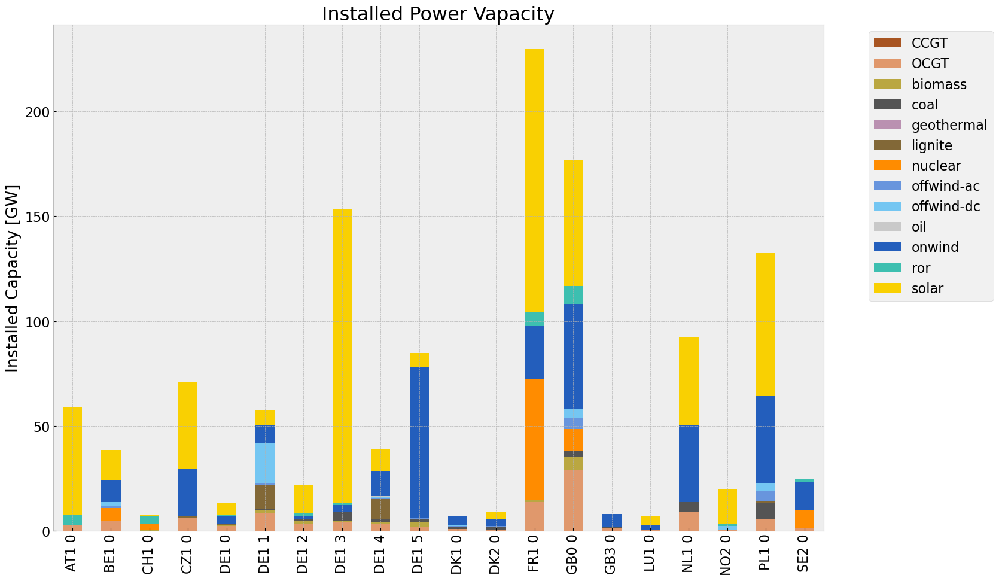

<Figure size 640x480 with 0 Axes>

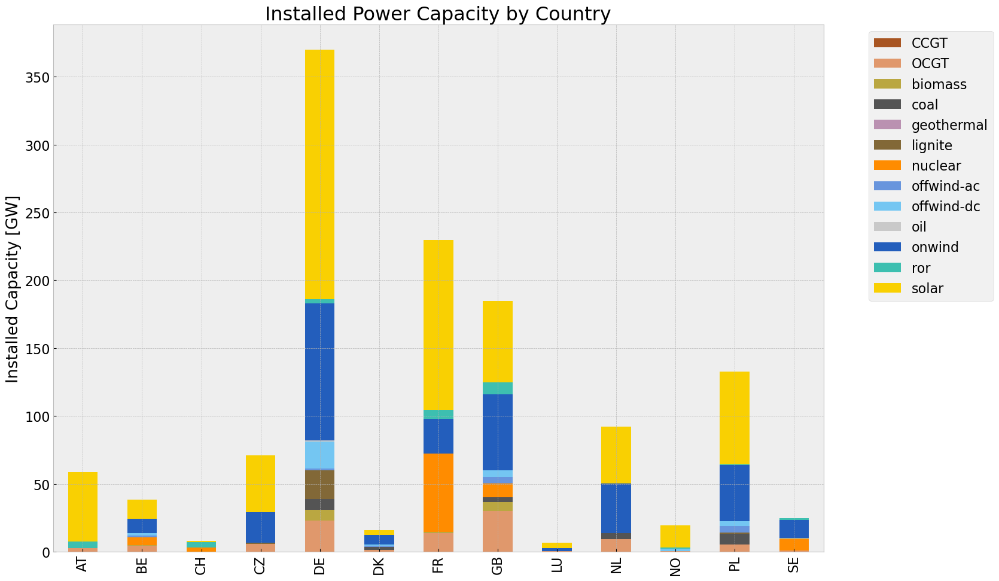

In [57]:
# consolidated istalled cap without load_shedding

#capacities_inv = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_inv.fillna(0, inplace=True)
#gen_1 = (capacities_inv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv = inst_cap_table(n1, color_cap)
cap_inv_country= inst_cap_table_country(n1, color_cap)


### Generation

<Figure size 640x480 with 0 Axes>

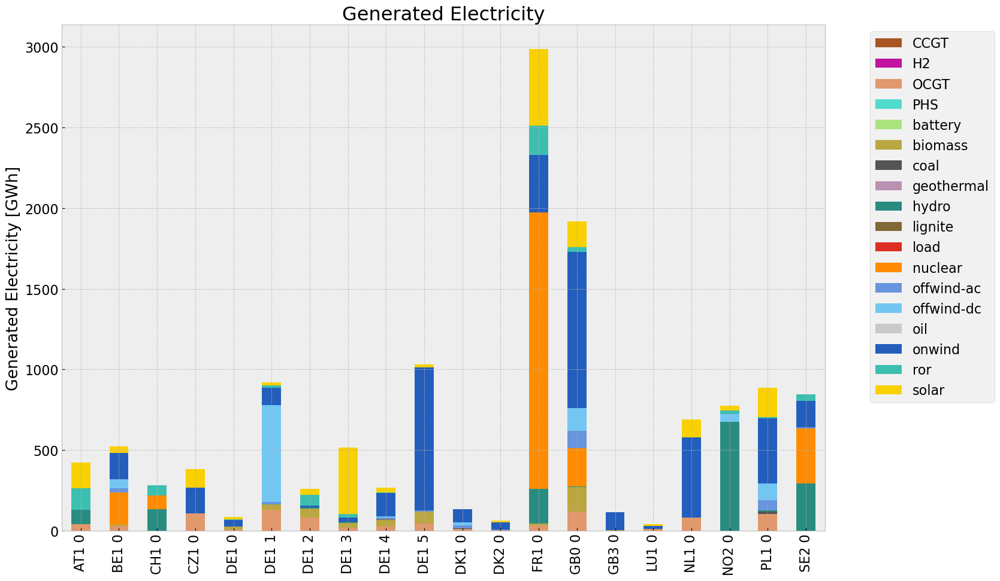

<Figure size 640x480 with 0 Axes>

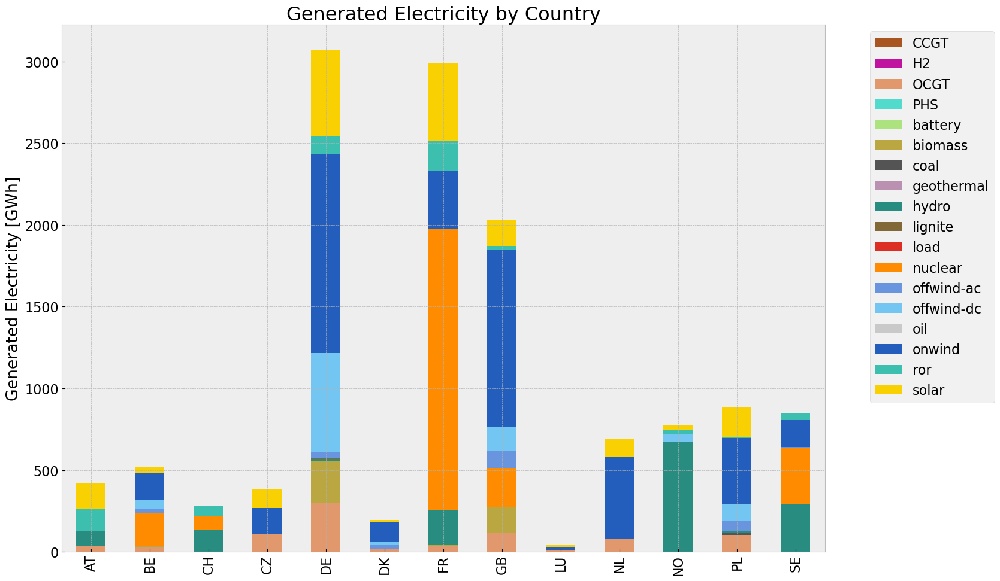

In [58]:
# consolidated generation table
#carrier = n1.generators.carrier.unique()
#df_tot_generation = n1.generators_t.p.sum()

#generations = pd.Series(index = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
           # except KeyError:
               # print('error')
                
#generations.fillna(0, inplace=True)
#gen_inv = generations.unstack()/1000#Gwh


gen_inv = gen_power_table(n1)
gen_inv_country = gen_power_table_country(n1)

### Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\923320227.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\923320227.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\923320227.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\923320227.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Users\

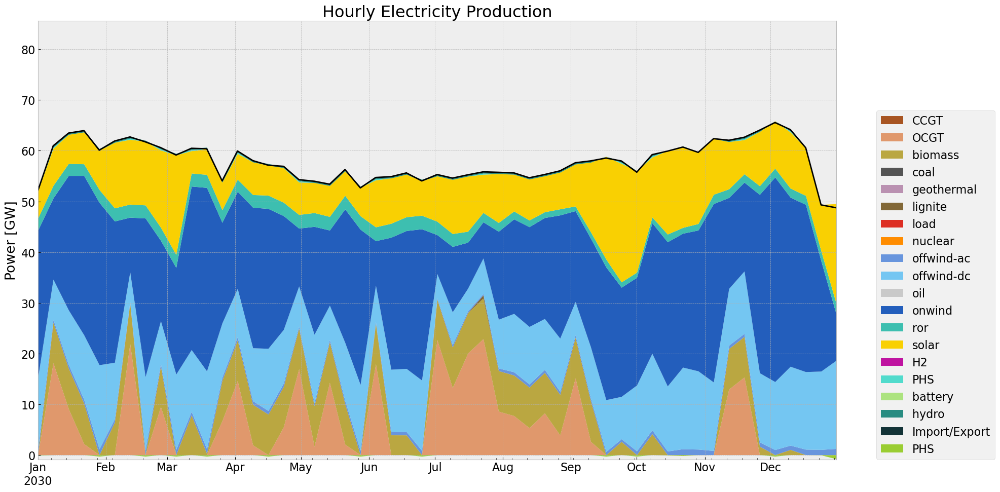

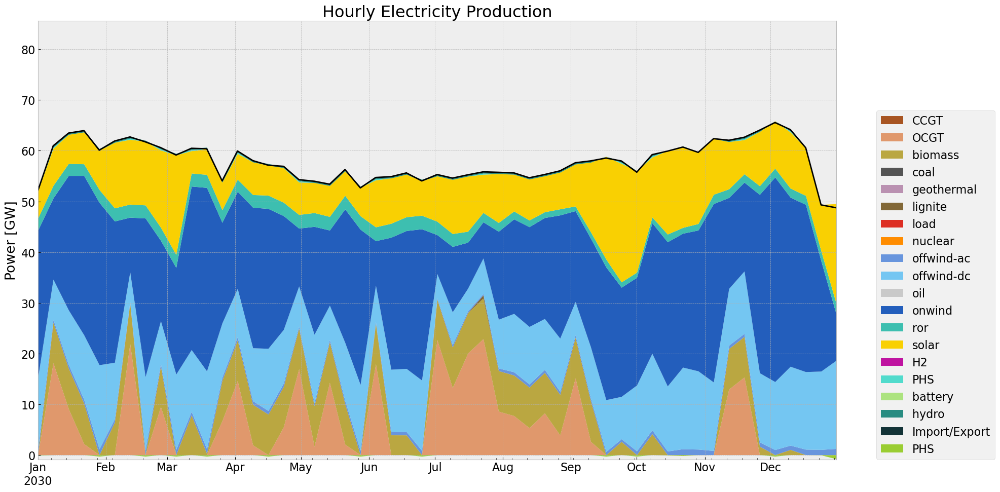

In [59]:
gen_curve(n1, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n1, '2030-01-01', '2030-12-31', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\2732365766.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\2732365766.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\2732365766.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\2732365766.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, 

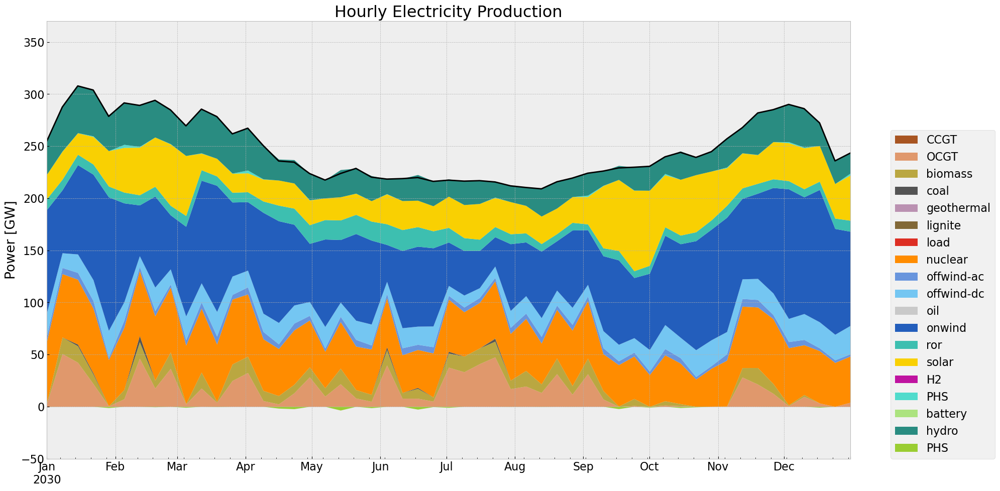

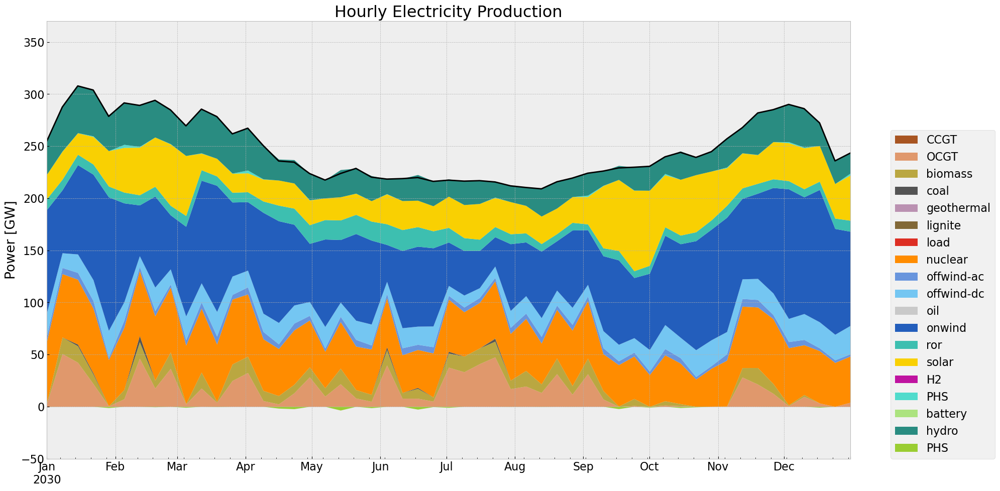

In [60]:
#generation curve all countries
#winter
gen_curve_tot(n1, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n1, '2030-01-01', '2030-12-31', colors_gen)

### Storage

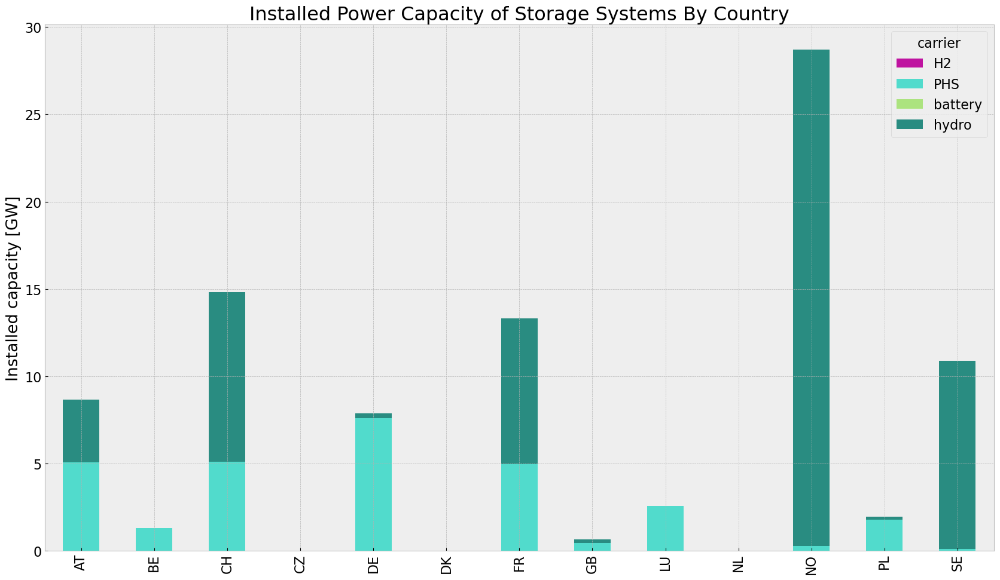

In [61]:
store_inv = inst_store_table(n1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\4184885543.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\4184885543.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\4184885543.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='168H')


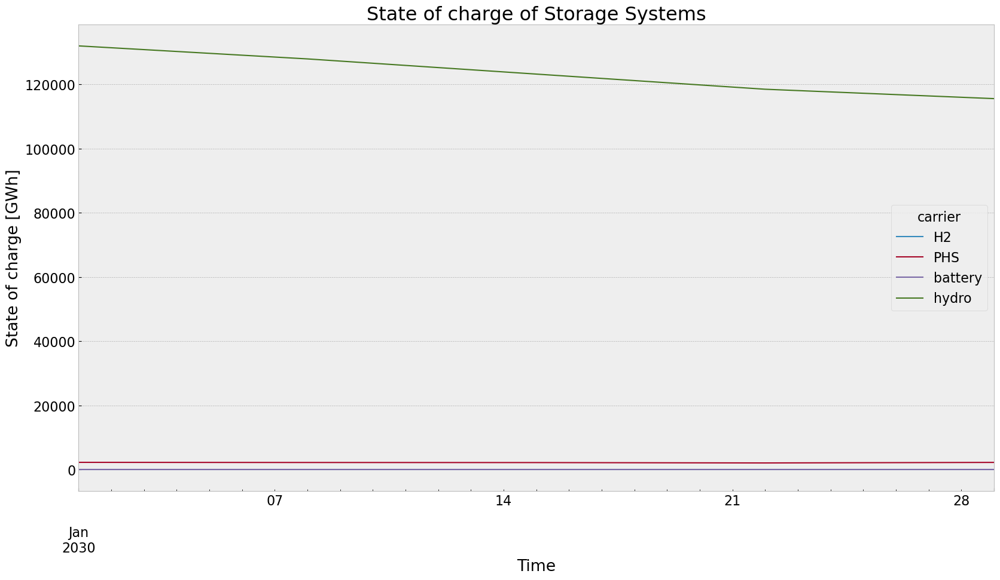

In [62]:
state_of_charge_plot(n1, '2030-01-01 00:00', '2030-02-02 21:00')

### Electricity Price


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


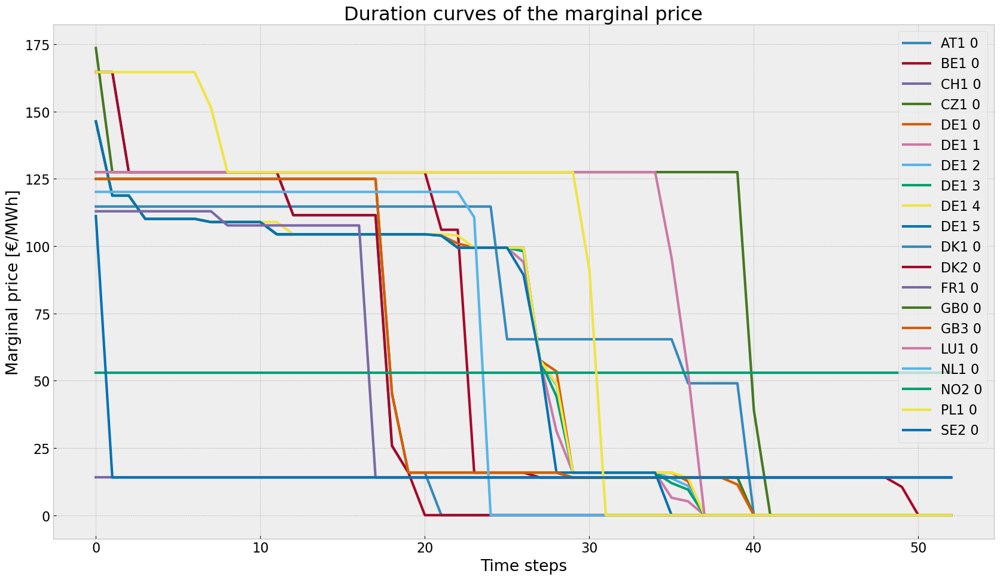

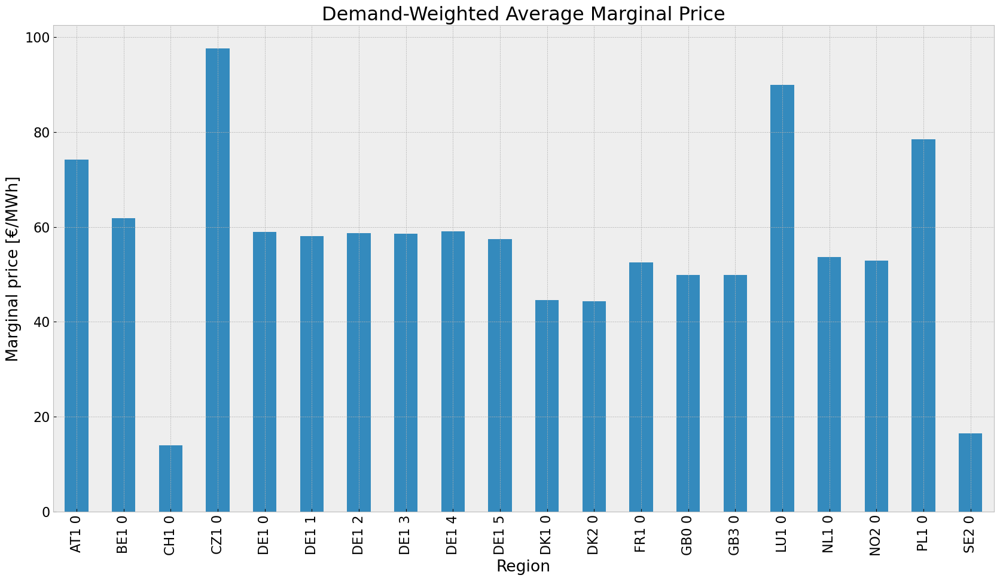

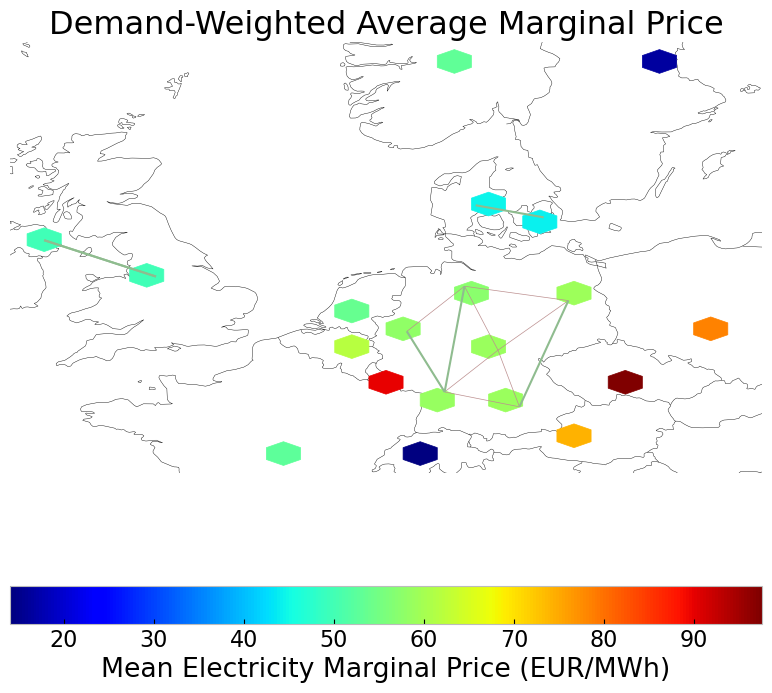

In [63]:
price_dur_curve_plot(n1)
price_regions_table(n1)
price_regions(n1)


### Emission

In [64]:
em_inv =em_table(n1)
em_inv

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,8.325700e+05,0.451621,0.1980,365016.054244
biomass,4.327219e+05,0.468000,0.0000,0.000000
coal,1.616281e+04,0.329908,0.3361,16466.163386
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,7.310021e+02,0.337285,0.4069,881.880249
load,0.000000e+00,1.000000,0.0000,0.000000
nuclear,2.581744e+06,0.326600,0.0000,0.000000
offwind-ac,2.623084e+05,1.000000,0.0000,0.000000


## Base RH

In [65]:
#BAse RH
n_roll = n.copy()
no_inv(n_roll,n)
n_roll.storage_units['cylic_state_of_charge'] = False
n_roll.storage_units['cylic_state_of_charge_per_period'] = False

#_roll.optimize.create_model()
#add_EQ_constraints(n_roll, o)
#n_roll.optimize.solve_model(solver_name='gurobi')

horizon = 4

optimize.optimize_with_rolling_horizon(n_roll, horizon=int(horizon), overlap=0, solver_name='gurobi')
#filename = f"base_{contingency}_roll.nc"
#n_roll = import_nc_file(directory, filename)
n_roll.name = f'base_{contingency}_roll'

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5qfeh9h3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5qfeh9h3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4112 rows, 1920 columns, 6516 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6516 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6516 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6516 nonzeros


Model fingerprint: 0xdccaabf6


INFO:gurobipy:Model fingerprint: 0xdccaabf6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3921 rows and 1161 columns


INFO:gurobipy:Presolve removed 3921 rows and 1161 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 191 rows, 759 columns, 1103 nonzeros


INFO:gurobipy:Presolved: 191 rows, 759 columns, 1103 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4187233e+09   3.548330e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.4187233e+09   3.548330e+06   0.000000e+00      0s


     217    3.6443396e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    3.6443396e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.644339570e+10


INFO:gurobipy:Optimal objective  3.644339570e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 3.64e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fo_vuoyf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fo_vuoyf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4112 rows, 1920 columns, 6516 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6516 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6516 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6516 nonzeros


Model fingerprint: 0x50ee9cf2


INFO:gurobipy:Model fingerprint: 0x50ee9cf2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3921 rows and 1153 columns


INFO:gurobipy:Presolve removed 3921 rows and 1153 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 191 rows, 767 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 191 rows, 767 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.7235708e+08   3.768017e+06   0.000000e+00      0s


INFO:gurobipy:       0    7.7235708e+08   3.768017e+06   0.000000e+00      0s


     199    3.8183790e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    3.8183790e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.07 seconds (0.00 work units)


Optimal objective  3.818378972e+10


INFO:gurobipy:Optimal objective  3.818378972e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 3.82e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hlwoejjg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hlwoejjg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4112 rows, 1920 columns, 6516 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6516 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6516 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6516 nonzeros


Model fingerprint: 0x245203b5


INFO:gurobipy:Model fingerprint: 0x245203b5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3921 rows and 1164 columns


INFO:gurobipy:Presolve removed 3921 rows and 1164 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 191 rows, 756 columns, 1100 nonzeros


INFO:gurobipy:Presolved: 191 rows, 756 columns, 1100 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.5169832e+08   3.621731e+06   0.000000e+00      0s


INFO:gurobipy:       0    6.5169832e+08   3.621731e+06   0.000000e+00      0s


     195    3.4997569e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    3.4997569e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.499756928e+10


INFO:gurobipy:Optimal objective  3.499756928e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 3.50e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_m9bclr0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_m9bclr0.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4112 rows, 1920 columns, 6516 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6516 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6516 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6516 nonzeros


Model fingerprint: 0xaafef88d


INFO:gurobipy:Model fingerprint: 0xaafef88d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3920 rows and 1143 columns


INFO:gurobipy:Presolve removed 3920 rows and 1143 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 192 rows, 777 columns, 1121 nonzeros


INFO:gurobipy:Presolved: 192 rows, 777 columns, 1121 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0657292e+08   3.421117e+06   0.000000e+00      0s


INFO:gurobipy:       0    2.0657292e+08   3.421117e+06   0.000000e+00      0s


     226    2.3406356e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    2.3406356e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.07 seconds (0.00 work units)


Optimal objective  2.340635570e+10


INFO:gurobipy:Optimal objective  2.340635570e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 2.34e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a697fgd_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a697fgd_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4112 rows, 1920 columns, 6516 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6516 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6516 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6516 nonzeros


Model fingerprint: 0x34011542


INFO:gurobipy:Model fingerprint: 0x34011542


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3922 rows and 1152 columns


INFO:gurobipy:Presolve removed 3922 rows and 1152 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 190 rows, 768 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 190 rows, 768 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.9773570e+07   3.127897e+06   0.000000e+00      0s


INFO:gurobipy:       0    7.9773570e+07   3.127897e+06   0.000000e+00      0s


     191    6.7317835e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     191    6.7317835e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 191 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 191 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.731783451e+09


INFO:gurobipy:Optimal objective  6.731783451e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 6.73e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7srr4un8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7srr4un8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4112 rows, 1920 columns, 6516 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6516 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6516 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6516 nonzeros


Model fingerprint: 0x4e432384


INFO:gurobipy:Model fingerprint: 0x4e432384


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3921 rows and 1144 columns


INFO:gurobipy:Presolve removed 3921 rows and 1144 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 191 rows, 776 columns, 1120 nonzeros


INFO:gurobipy:Presolved: 191 rows, 776 columns, 1120 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.1839188e+07   2.993374e+06   0.000000e+00      0s


INFO:gurobipy:       0    8.1839188e+07   2.993374e+06   0.000000e+00      0s


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


     179    3.1628711e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     179    3.1628711e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 179 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 179 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.162871074e+08


INFO:gurobipy:Optimal objective  3.162871074e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 3.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dsa_3aia.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dsa_3aia.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4112 rows, 1920 columns, 6516 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6516 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6516 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6516 nonzeros


Model fingerprint: 0x785b4408


INFO:gurobipy:Model fingerprint: 0x785b4408


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3923 rows and 1150 columns


INFO:gurobipy:Presolve removed 3923 rows and 1150 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 189 rows, 770 columns, 1114 nonzeros


INFO:gurobipy:Presolved: 189 rows, 770 columns, 1114 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2440113e+07   2.940033e+06   0.000000e+00      0s


INFO:gurobipy:       0    4.2440113e+07   2.940033e+06   0.000000e+00      0s


     179    3.0334192e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     179    3.0334192e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 179 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 179 iterations and 0.06 seconds (0.00 work units)


Optimal objective  3.033419214e+08


INFO:gurobipy:Optimal objective  3.033419214e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 3.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pwsoidi2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pwsoidi2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4112 rows, 1920 columns, 6516 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6516 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6516 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6516 nonzeros


Model fingerprint: 0x1b32b8cf


INFO:gurobipy:Model fingerprint: 0x1b32b8cf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3924 rows and 1149 columns


INFO:gurobipy:Presolve removed 3924 rows and 1149 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 188 rows, 771 columns, 1115 nonzeros


INFO:gurobipy:Presolved: 188 rows, 771 columns, 1115 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.0382018e+07   3.009960e+06   0.000000e+00      0s


INFO:gurobipy:       0    5.0382018e+07   3.009960e+06   0.000000e+00      0s


     203    5.2488078e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     203    5.2488078e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 203 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 203 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.248807792e+08


INFO:gurobipy:Optimal objective  5.248807792e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 5.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lat_1pcu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lat_1pcu.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4112 rows, 1920 columns, 6516 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6516 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6516 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6516 nonzeros


Model fingerprint: 0x98f309e9


INFO:gurobipy:Model fingerprint: 0x98f309e9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3922 rows and 1151 columns


INFO:gurobipy:Presolve removed 3922 rows and 1151 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 190 rows, 769 columns, 1113 nonzeros


INFO:gurobipy:Presolved: 190 rows, 769 columns, 1113 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.5866044e+07   2.991656e+06   0.000000e+00      0s


INFO:gurobipy:       0    6.5866044e+07   2.991656e+06   0.000000e+00      0s


     231    5.4476922e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    5.4476922e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.447692179e+08


INFO:gurobipy:Optimal objective  5.447692179e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 5.45e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v3wxhnsu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v3wxhnsu.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4112 rows, 1920 columns, 6516 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6516 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6516 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6516 nonzeros


Model fingerprint: 0x967e377b


INFO:gurobipy:Model fingerprint: 0x967e377b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3920 rows and 1143 columns


INFO:gurobipy:Presolve removed 3920 rows and 1143 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 192 rows, 777 columns, 1121 nonzeros


INFO:gurobipy:Presolved: 192 rows, 777 columns, 1121 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3695424e+08   3.052131e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.3695424e+08   3.052131e+06   0.000000e+00      0s


     223    1.0517689e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    1.0517689e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.051768877e+09


INFO:gurobipy:Optimal objective  1.051768877e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 1.05e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oepbq2kn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oepbq2kn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4112 rows, 1920 columns, 6516 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6516 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6516 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6516 nonzeros


Model fingerprint: 0xfece7273


INFO:gurobipy:Model fingerprint: 0xfece7273


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3923 rows and 1166 columns


INFO:gurobipy:Presolve removed 3923 rows and 1166 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 189 rows, 754 columns, 1097 nonzeros


INFO:gurobipy:Presolved: 189 rows, 754 columns, 1097 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8045176e+08   3.153743e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.8045176e+08   3.153743e+06   0.000000e+00      0s


     191    8.8271662e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     191    8.8271662e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 191 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 191 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.827166238e+08


INFO:gurobipy:Optimal objective  8.827166238e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 8.83e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9ou45_lr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9ou45_lr.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4112 rows, 1920 columns, 6516 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6516 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6516 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6516 nonzeros


Model fingerprint: 0x1827cea3


INFO:gurobipy:Model fingerprint: 0x1827cea3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3920 rows and 1140 columns


INFO:gurobipy:Presolve removed 3920 rows and 1140 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 192 rows, 780 columns, 1124 nonzeros


INFO:gurobipy:Presolved: 192 rows, 780 columns, 1124 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0289380e+08   3.711381e+06   0.000000e+00      0s


INFO:gurobipy:       0    4.0289380e+08   3.711381e+06   0.000000e+00      0s


     206    5.6799980e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     206    5.6799980e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 206 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 206 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.679997970e+09


INFO:gurobipy:Optimal objective  5.679997970e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 5.68e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4gcl79vk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4gcl79vk.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4112 rows, 1920 columns, 6516 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6516 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6516 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6516 nonzeros


Model fingerprint: 0xf4b3026b


INFO:gurobipy:Model fingerprint: 0xf4b3026b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3924 rows and 1185 columns


INFO:gurobipy:Presolve removed 3924 rows and 1185 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 188 rows, 735 columns, 1078 nonzeros


INFO:gurobipy:Presolved: 188 rows, 735 columns, 1078 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.2689350e+07   3.424319e+06   0.000000e+00      0s


INFO:gurobipy:       0    6.2689350e+07   3.424319e+06   0.000000e+00      0s


     195    9.2517291e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    9.2517291e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.07 seconds (0.00 work units)


Optimal objective  9.251729137e+09


INFO:gurobipy:Optimal objective  9.251729137e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 9.25e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lwqcw2jq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lwqcw2jq.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 1028 rows, 480 columns, 1499 nonzeros


INFO:gurobipy:obj: 1028 rows, 480 columns, 1499 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1028 rows, 480 columns and 1499 nonzeros


INFO:gurobipy:Optimize a model with 1028 rows, 480 columns and 1499 nonzeros


Model fingerprint: 0xc3208de1


INFO:gurobipy:Model fingerprint: 0xc3208de1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 5e+01]


INFO:gurobipy:  Matrix range     [1e+00, 5e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1010 rows and 346 columns


INFO:gurobipy:Presolve removed 1010 rows and 346 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 18 rows, 134 columns, 154 nonzeros


INFO:gurobipy:Presolved: 18 rows, 134 columns, 154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9679745e+08   3.570111e+04   0.000000e+00      0s


INFO:gurobipy:       0    1.9679745e+08   3.570111e+04   0.000000e+00      0s


      16    2.3071054e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      16    2.3071054e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 16 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 16 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.307105396e+08


INFO:gurobipy:Optimal objective  2.307105396e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 480 primals, 1028 duals
Objective: 2.31e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


INFO:pypsa.io:Exported network DE_20_1.0_base_roll_solved_168h.nc has lines, links, generators, global_constraints, carriers, loads, storage_units, buses


<Figure size 640x480 with 0 Axes>

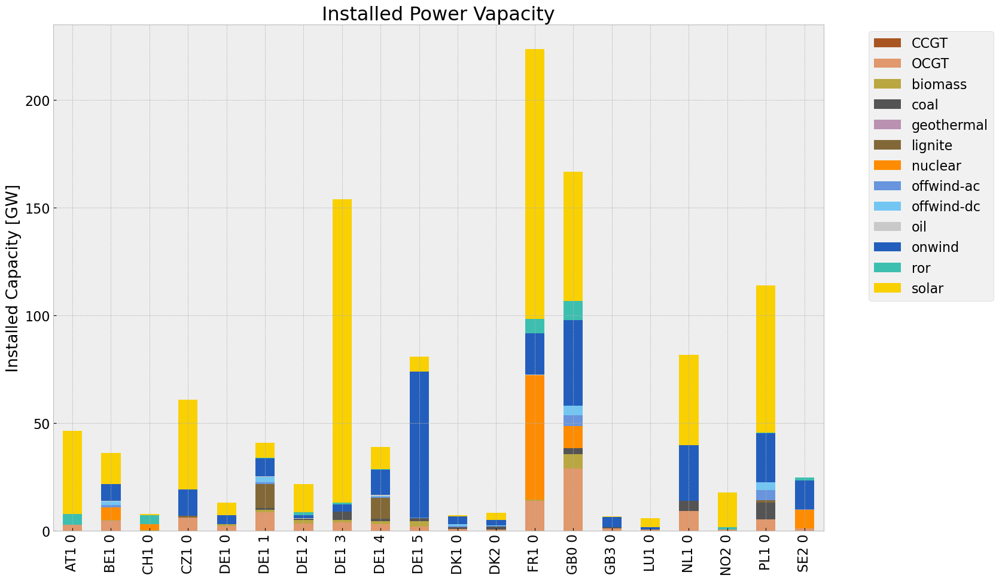

<Figure size 640x480 with 0 Axes>

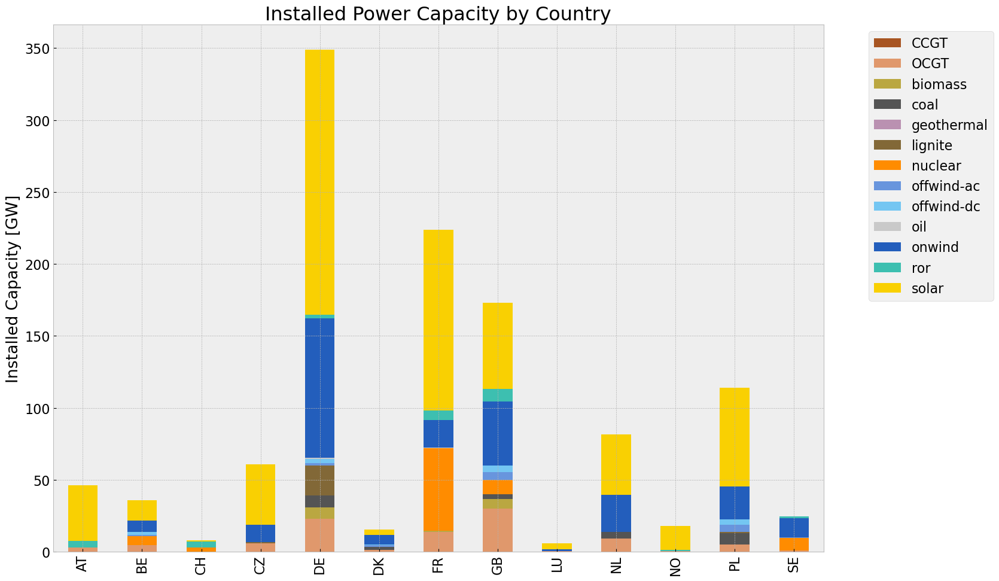

<Figure size 640x480 with 0 Axes>

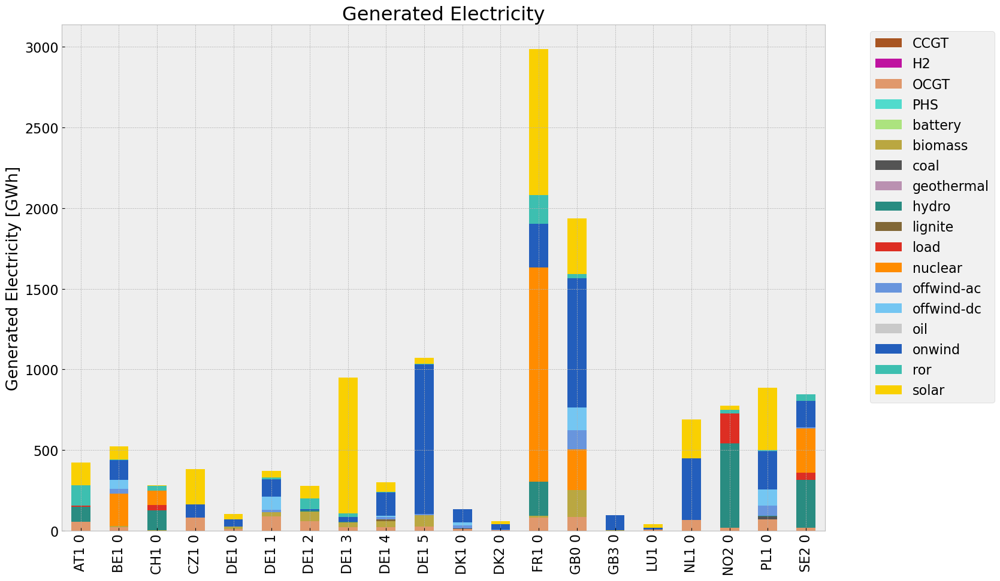

<Figure size 640x480 with 0 Axes>

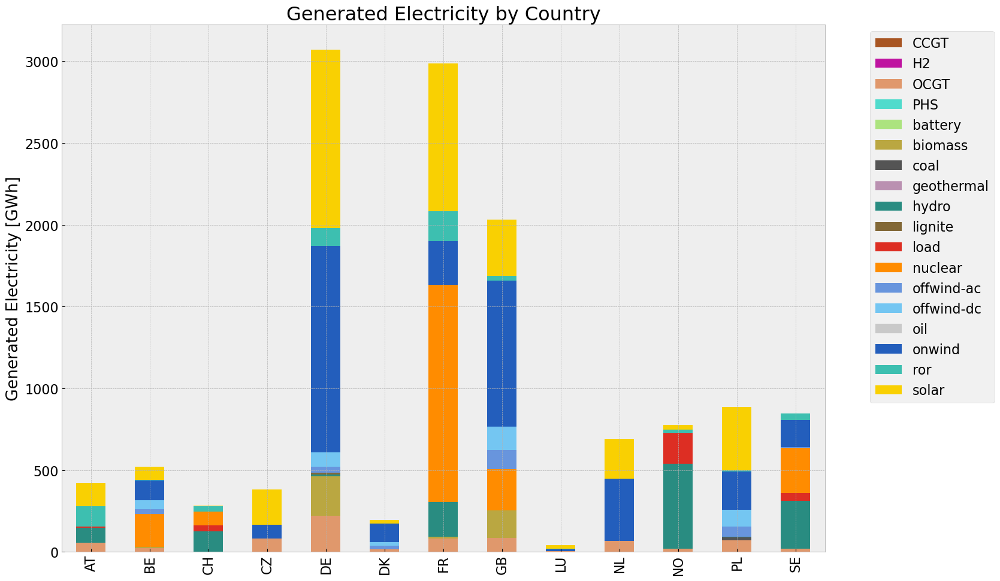

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\923320227.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\923320227.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\923320227.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\923320227.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Users\

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,7.350287e+05,0.451621,0.1980,322251.917602
biomass,4.291389e+05,0.468000,0.0000,0.000000
coal,1.958208e+04,0.329908,0.3361,19949.608565
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,1.312300e+04,0.337285,0.4069,15831.572723
load,2.746897e+05,1.000000,0.0000,0.000000
nuclear,2.146531e+06,0.326600,0.0000,0.000000
offwind-ac,2.754956e+05,1.000000,0.0000,0.000000


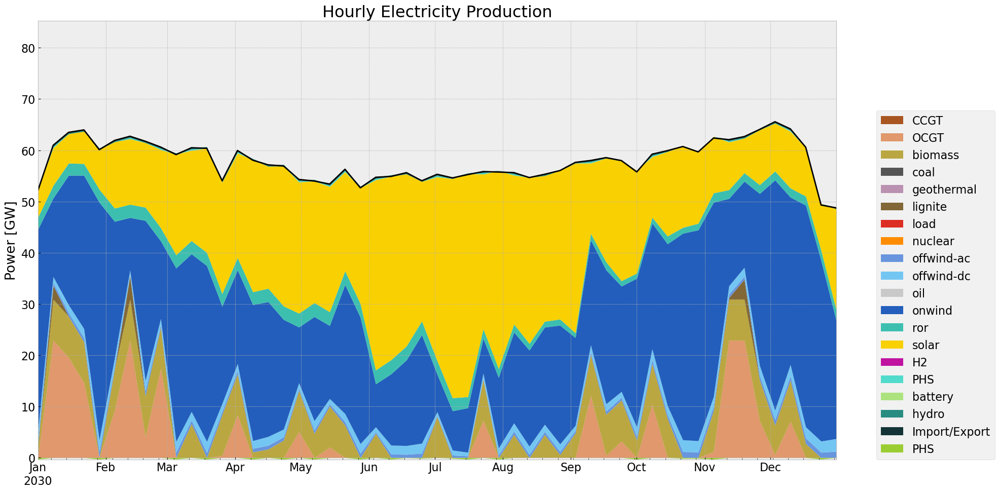

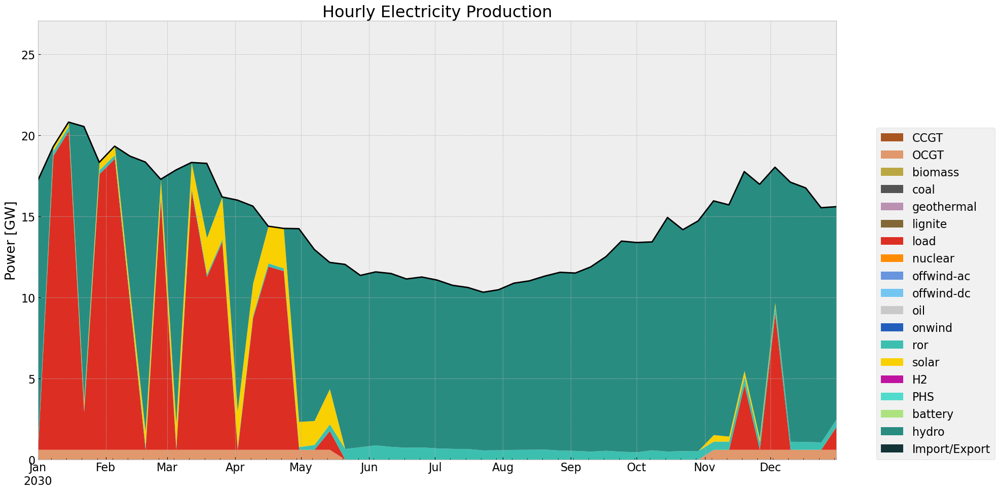

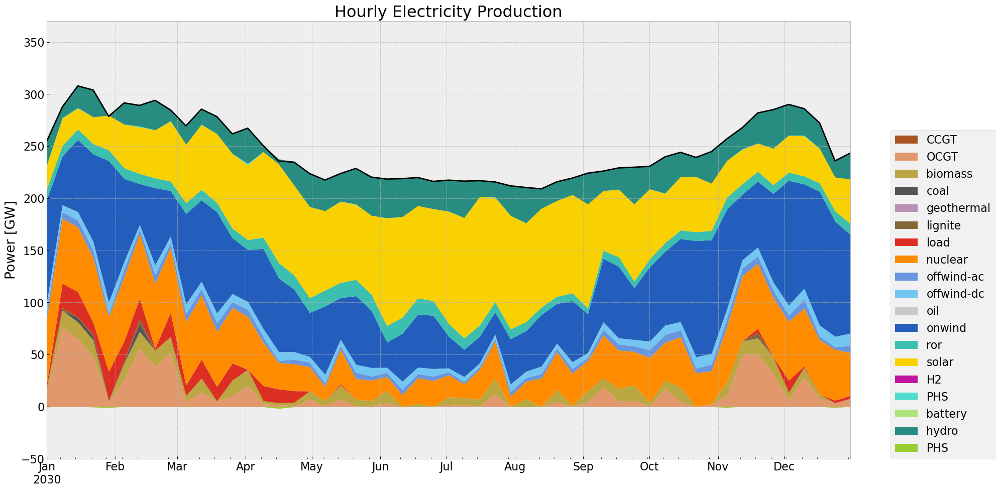

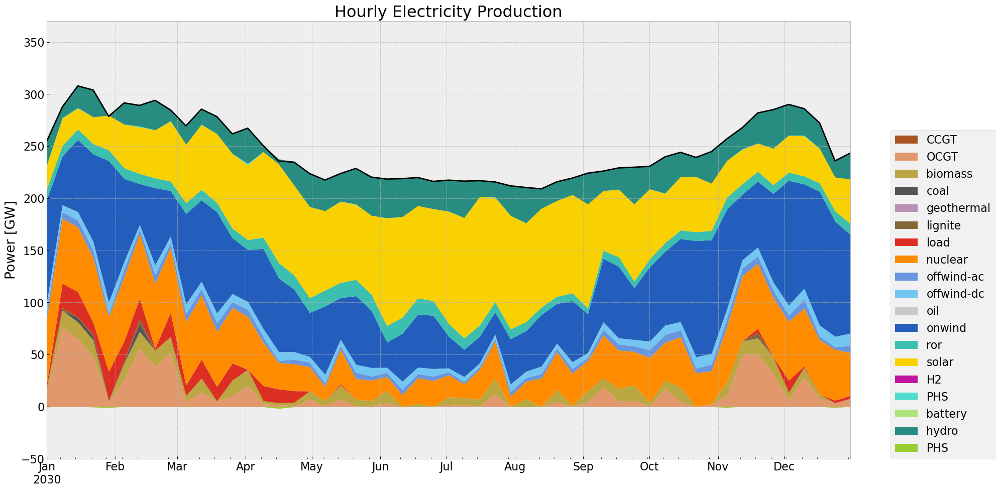

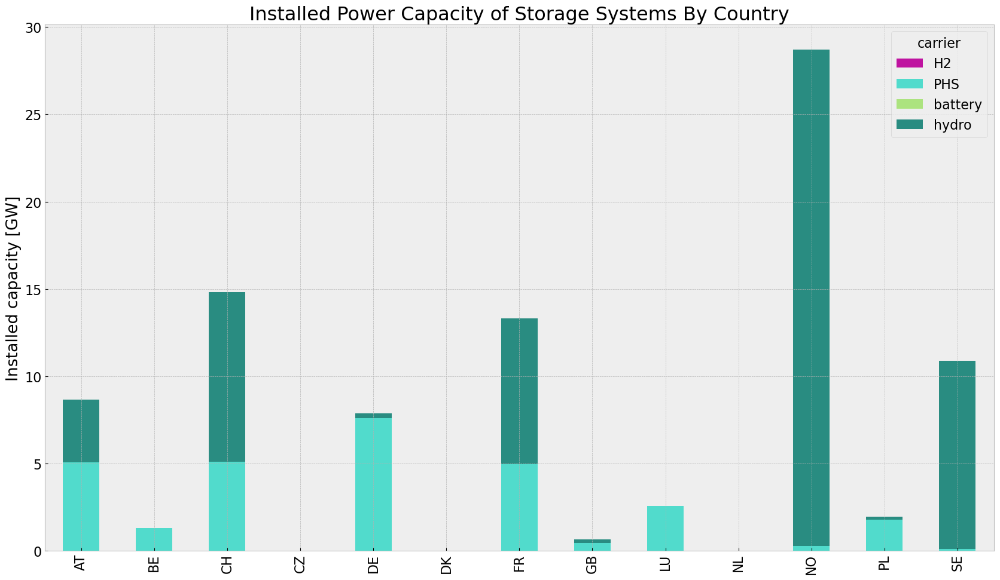

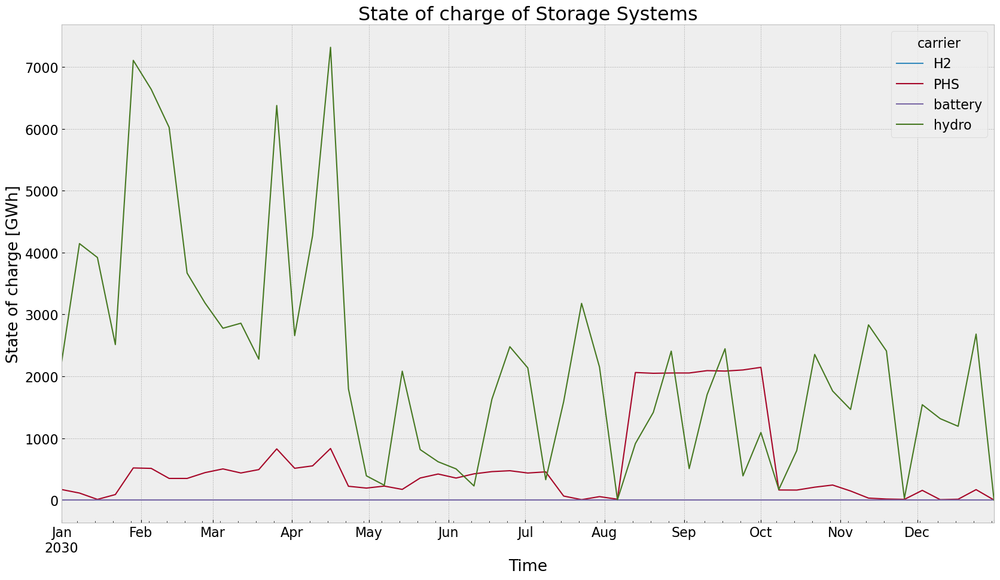

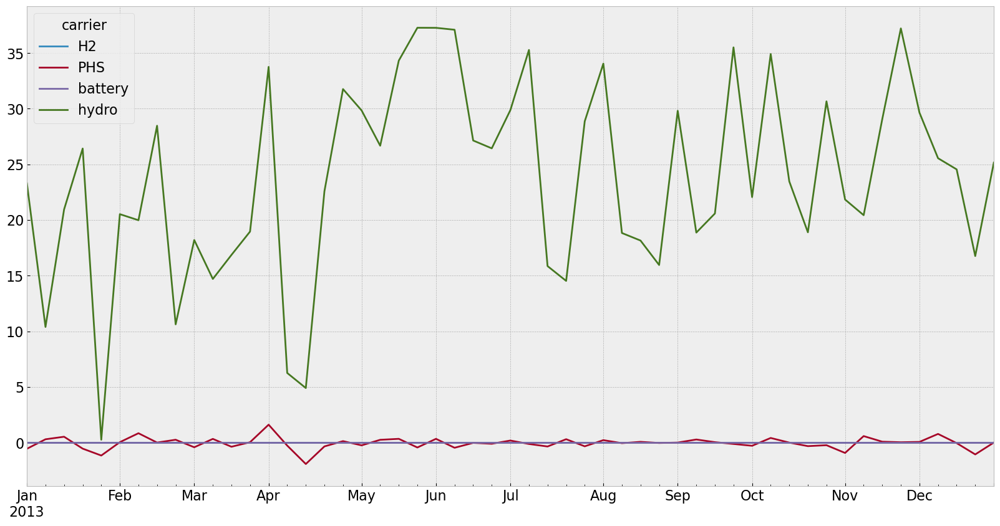

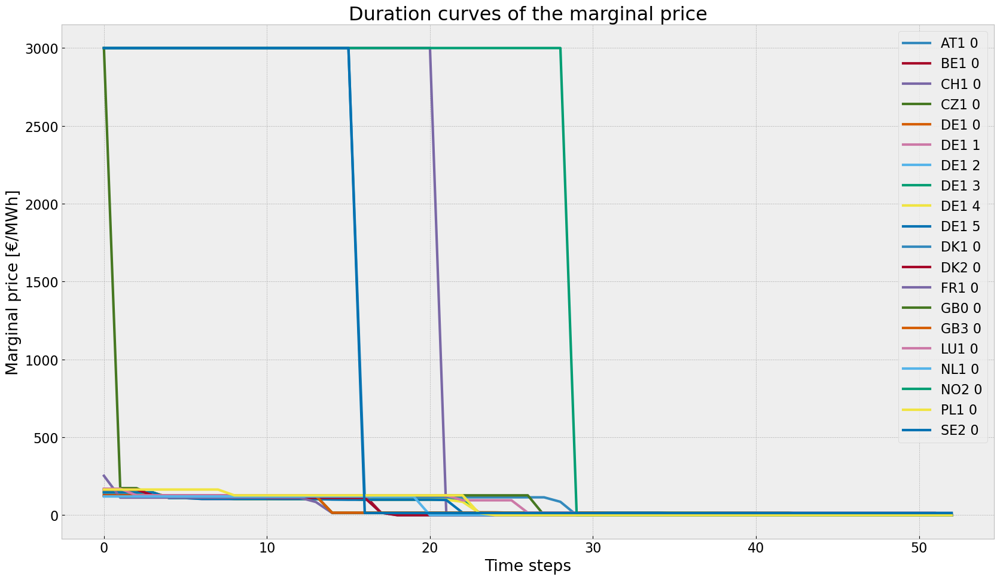

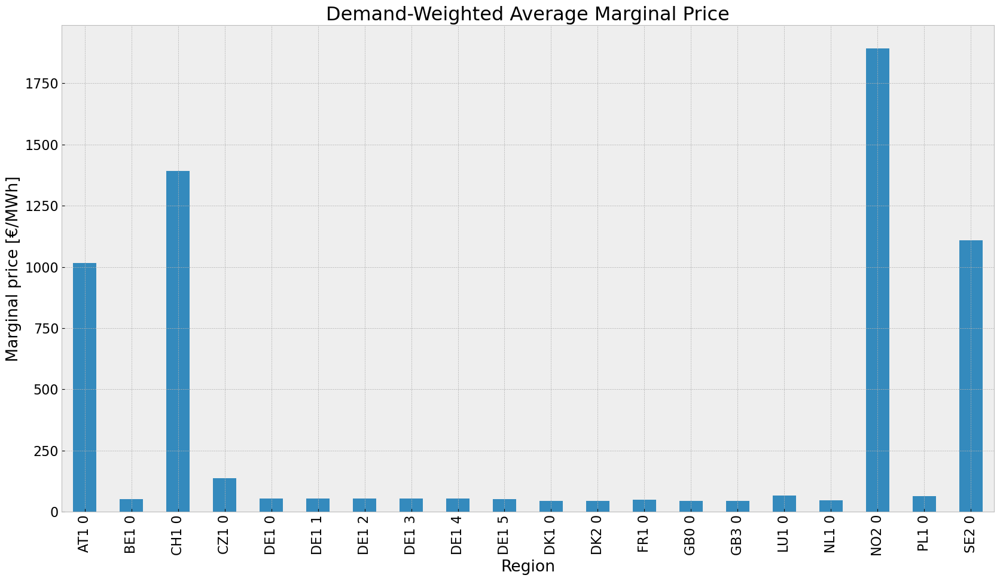

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


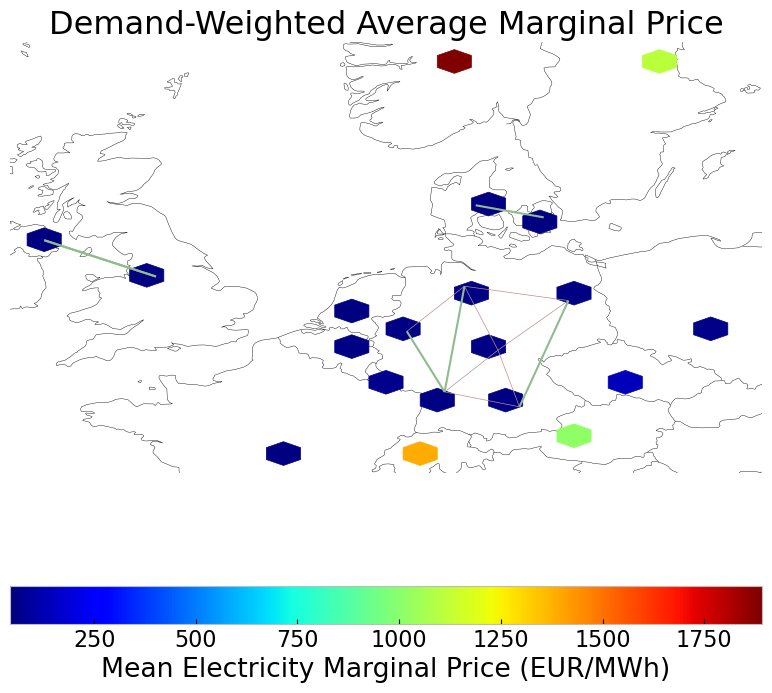

In [66]:
file = f"{country}_{buses}_{le}_base_roll_solved_168h.nc"
output_path = os.path.join(dir, file)
n_roll.export_to_netcdf(output_path)

tot_cos_base_roll=n_roll.objective/1e9 #billion €
system_cost_base_roll = system_cost(n_roll) #million €/a
marg_price_region_base_roll = n_roll.buses_t.marginal_price.mean()
stat_base_roll = n_roll.statistics()

# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_base_roll = inst_cap_table(n_roll, color_cap)
cap_base_roll_country = inst_cap_table_country(n_roll, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_base_roll  = gen_power_table(n_roll)
gen_base_roll_country = gen_power_table_country(n_roll)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n_roll, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n_roll, '2030-01-01', '2030-12-31', colors_gen,'NO')
#generation curve all countries
#winter
gen_curve_tot(n_roll, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n_roll, '2030-01-01', '2030-12-31', colors_gen)

#installed storage unit & stores
store_base_roll = inst_store_table(n_roll)

#State of Charge Storage unit
state_of_charge_plot(n_roll, '2030-01-01 00:00', '2030-12-31 21:00')
n_roll.storage_units_t.p.groupby(n_roll.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n_roll)

#avg electricity price
price_regions_table(n_roll)
price_regions(n_roll)

#Emission
em_base_roll =em_table(n_roll)
em_base_roll

## 2. Noinv

In [67]:
n2 = pvscenario(n, carriers_to_cut, duration, reductionto)

cut_start: 2013-03-12 00:00:00


### No Investment

In [68]:
no_inv(n2,n)

In [69]:
#n2.optimize.create_model()
#add_EQ_constraints(n2, o)
#n2.optimize.solve_model(solver_name='gurobi')
n2.optimize(solver_name='gurobi')

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 61.40it/s]
INFO:linopy.io: Writing time: 0.72s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uxj2443n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uxj2443n.lp


Reading time = 0.17 seconds


INFO:gurobipy:Reading time = 0.17 seconds


obj: 54484 rows, 25440 columns, 86337 nonzeros


INFO:gurobipy:obj: 54484 rows, 25440 columns, 86337 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 54484 rows, 25440 columns and 86337 nonzeros


INFO:gurobipy:Optimize a model with 54484 rows, 25440 columns and 86337 nonzeros


Model fingerprint: 0x33f733dd


INFO:gurobipy:Model fingerprint: 0x33f733dd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 51954 rows and 15266 columns


INFO:gurobipy:Presolve removed 51954 rows and 15266 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 2530 rows, 10174 columns, 14729 nonzeros


INFO:gurobipy:Presolved: 2530 rows, 10174 columns, 14729 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.813e+03


INFO:gurobipy: AA' NZ     : 3.813e+03


 Factor NZ  : 3.039e+04 (roughly 5 MB of memory)


INFO:gurobipy: Factor NZ  : 3.039e+04 (roughly 5 MB of memory)


 Factor Ops : 4.543e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.543e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.92767979e+13 -1.18792943e+14  9.16e+05 4.80e+04  3.99e+10     0s


INFO:gurobipy:   0   1.92767979e+13 -1.18792943e+14  9.16e+05 4.80e+04  3.99e+10     0s


   1   3.93345151e+12 -3.09901850e+13  7.72e+04 1.44e+04  4.22e+09     0s


INFO:gurobipy:   1   3.93345151e+12 -3.09901850e+13  7.72e+04 1.44e+04  4.22e+09     0s


   2   1.00366866e+12 -7.44811733e+12  5.93e+03 8.34e+02  5.50e+08     0s


INFO:gurobipy:   2   1.00366866e+12 -7.44811733e+12  5.93e+03 8.34e+02  5.50e+08     0s


   3   2.79674268e+11 -1.25959024e+12  5.88e+02 2.91e-10  8.22e+07     0s


INFO:gurobipy:   3   2.79674268e+11 -1.25959024e+12  5.88e+02 2.91e-10  8.22e+07     0s


   4   1.15639092e+11 -2.38619451e+11  1.02e+02 2.33e-10  1.79e+07     0s


INFO:gurobipy:   4   1.15639092e+11 -2.38619451e+11  1.02e+02 2.33e-10  1.79e+07     0s


   5   8.38900776e+10 -5.38708677e+10  4.83e+01 1.75e-10  6.87e+06     0s


INFO:gurobipy:   5   8.38900776e+10 -5.38708677e+10  4.83e+01 1.75e-10  6.87e+06     0s


   6   6.16268916e+10  1.00472393e+10  1.58e+01 1.16e-10  2.55e+06     0s


INFO:gurobipy:   6   6.16268916e+10  1.00472393e+10  1.58e+01 1.16e-10  2.55e+06     0s


   7   5.46264319e+10  2.76758928e+10  7.56e+00 8.73e-11  1.33e+06     0s


INFO:gurobipy:   7   5.46264319e+10  2.76758928e+10  7.56e+00 8.73e-11  1.33e+06     0s


   8   4.88904789e+10  3.85086531e+10  1.62e+00 6.40e-11  5.11e+05     0s


INFO:gurobipy:   8   4.88904789e+10  3.85086531e+10  1.62e+00 6.40e-11  5.11e+05     0s


   9   4.75640660e+10  4.27262797e+10  6.66e-01 6.12e-11  2.38e+05     0s


INFO:gurobipy:   9   4.75640660e+10  4.27262797e+10  6.66e-01 6.12e-11  2.38e+05     0s


  10   4.68703531e+10  4.52890322e+10  2.61e-01 5.82e-11  7.78e+04     0s


INFO:gurobipy:  10   4.68703531e+10  4.52890322e+10  2.61e-01 5.82e-11  7.78e+04     0s


  11   4.66256758e+10  4.59766807e+10  1.38e-01 5.82e-11  3.19e+04     0s


INFO:gurobipy:  11   4.66256758e+10  4.59766807e+10  1.38e-01 5.82e-11  3.19e+04     0s


  12   4.64065731e+10  4.61984017e+10  3.19e-02 5.42e-11  1.02e+04     0s


INFO:gurobipy:  12   4.64065731e+10  4.61984017e+10  3.19e-02 5.42e-11  1.02e+04     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.23 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.23 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2962    4.6326765e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2962    4.6326765e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2962 iterations and 0.29 seconds (0.05 work units)


INFO:gurobipy:Solved in 2962 iterations and 0.29 seconds (0.05 work units)


Optimal objective  4.632676531e+10


INFO:gurobipy:Optimal objective  4.632676531e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 25440 primals, 54484 duals
Objective: 4.63e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


('ok', 'optimal')

In [70]:
#n2.optimize(solver_name ='gurobi')
#filename = f"noinv_{contingency}.nc"
#n2 = import_nc_file(directory, filename)
n2.name = f'noinv_{contingency}'    

### Export model for later use

In [71]:
file = f"{n2.name}.nc"
output_path = os.path.join(os.getcwd(), file)
n2.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network noinv_pv.nc has lines, links, generators, global_constraints, carriers, loads, storage_units, buses


<xarray.Dataset> Size: 234kB
Dimensions:                               (snapshots: 53,
                                           investment_periods: 0, lines_i: 8,
                                           lines_t_p0_i: 8, lines_t_p1_i: 8,
                                           lines_t_loss_i: 8, links_i: 6,
                                           links_t_p0_i: 3, links_t_p1_i: 3,
                                           generators_i: 261,
                                           ...
                                           storage_units_t_p_dispatch_i: 23,
                                           storage_units_t_p_store_i: 13,
                                           storage_units_t_state_of_charge_i: 65,
                                           buses_i: 20, buses_t_p_i: 20,
                                           buses_t_v_ang_i: 6,
                                           buses_t_marginal_price_i: 20)
Coordinates: (12/27)
  * snapshots                             (snapshots) int64 424B 0 1 2 ... 51 52
  * investment_periods                    (investment_periods) int64 0B 
  * lines_i                               (lines_i) object 64B '12' ... '22'
  * lines_t_p0_i                          (lines_t_p0_i) object 64B '12' ... ...
  * lines_t_p1_i                          (lines_t_p1_i) object 64B '12' ... ...
  * lines_t_loss_i                        (lines_t_loss_i) object 64B '12' .....
    ...                                    ...
  * storage_units_t_p_store_i             (storage_units_t_p_store_i) object 104B ...
  * storage_units_t_state_of_charge_i     (storage_units_t_state_of_charge_i) object 520B ...
  * buses_i                               (buses_i) object 160B 'AT1 0' ... '...
  * buses_t_p_i                           (buses_t_p_i) object 160B 'AT1 0' ....
  * buses_t_v_ang_i                       (buses_t_v_ang_i) object 48B 'DE1 0...
  * buses_t_marginal_price_i              (buses_t_marginal_price_i) object 160B ...
Data variables: (12/98)
    snapshots_snapshot                    (snapshots) datetime64[ns] 424B 201...
    snapshots_objective                   (snapshots) float64 424B 168.0 ... ...
    snapshots_generators                  (snapshots) float64 424B 168.0 ... ...
    snapshots_stores                      (snapshots) float64 424B 168.0 ... ...
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    buses_country                         (buses_i) object 160B 'AT' ... 'SE'
    buses_control                         (buses_i) object 160B 'Slack' ... 'PQ'
    buses_generator                       (buses_i) object 160B 'AT1 0 CCGT' ...
    buses_t_p                             (snapshots, buses_t_p_i) float64 8kB ...
    buses_t_v_ang                         (snapshots, buses_t_v_ang_i) float64 3kB ...
    buses_t_marginal_price                (snapshots, buses_t_marginal_price_i) float64 8kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            noinv_pv
    network_objective:       46326765314.52056
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [72]:
tot_cos_noinv=n2.objective/1e9 #billion €
system_cost_noinv = system_cost(n2) #million €/a
marg_price_region_noinv = n2.buses_t.marginal_price.mean()
stat_noinv = n2.statistics()

### Installed Capacity

Since expansion is not allowed in this scenario, the installed capacity will equal to that of the base scenario.

<Figure size 640x480 with 0 Axes>

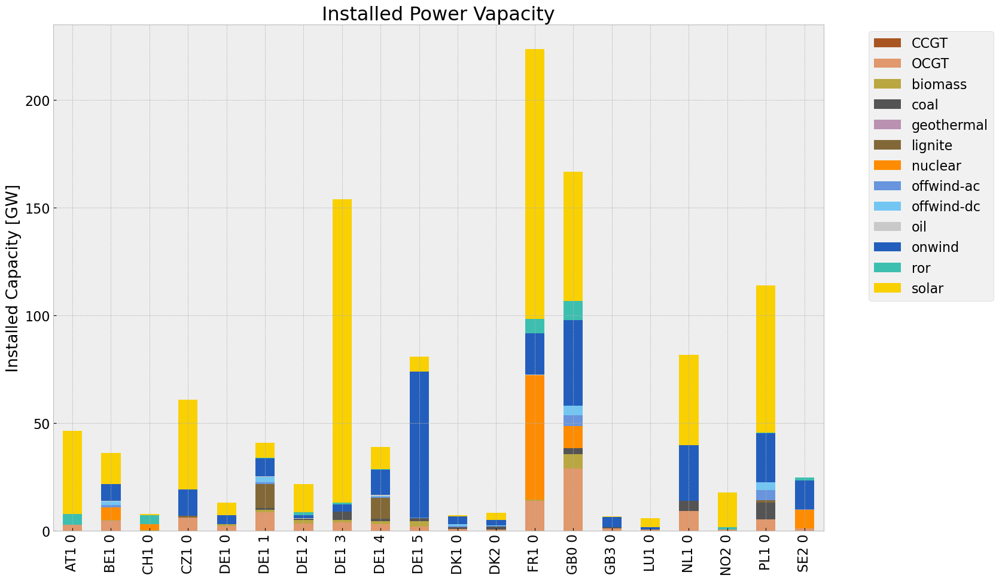

<Figure size 640x480 with 0 Axes>

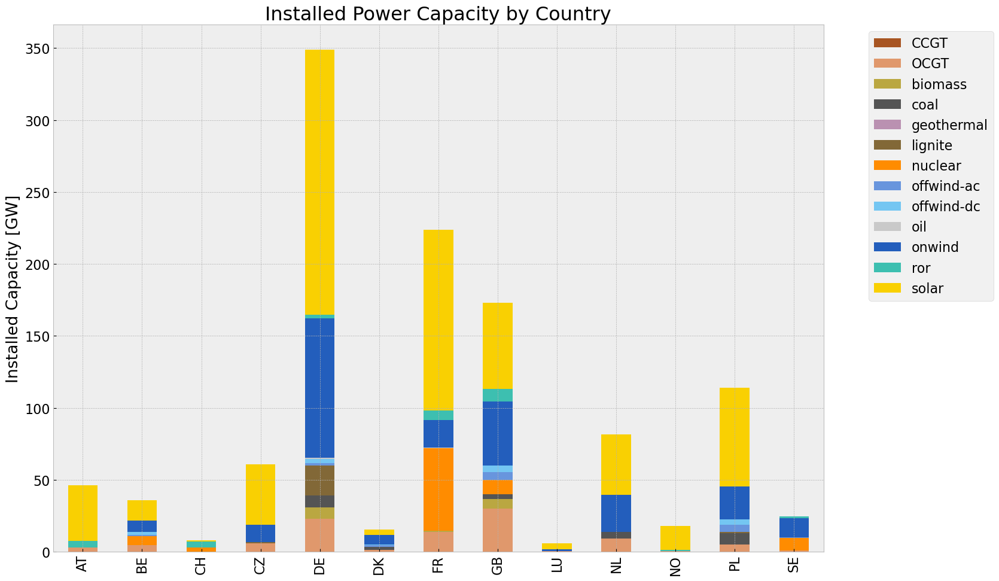

In [73]:
# consolidated istalled cap without load_shedding

#capacities_noinv = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv.fillna(0, inplace=True)
#gen = (capacities_noinv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv = inst_cap_table(n2, color_cap)
cap_noinv_country= inst_cap_table_country(n2, color_cap)



### Generation

<Figure size 640x480 with 0 Axes>

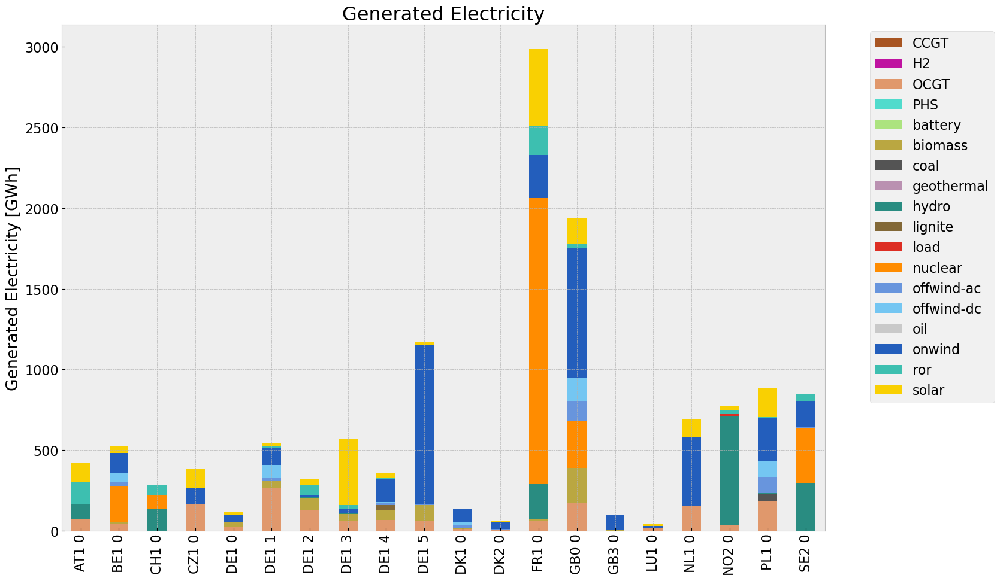

<Figure size 640x480 with 0 Axes>

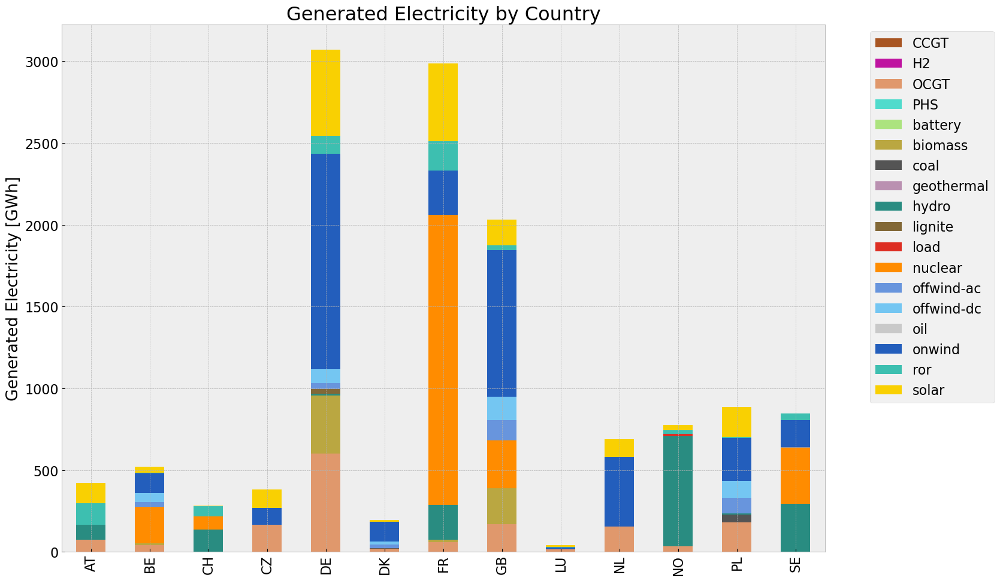

In [74]:
# consolidated generation table
#carrier = n2.generators.carrier.unique()
#df_tot_generation = n2.generators_t.p.sum()

#generations = pd.Series(index = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
                #generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')

#generations.fillna(0, inplace=True)
#gen_noinv = generations.unstack()/1000#GWh

gen_noinv= gen_power_table(n2)
gen_noinv_country = gen_power_table_country(n2)


### Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\1295948682.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\1295948682.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\923320227.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\923320227.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).su

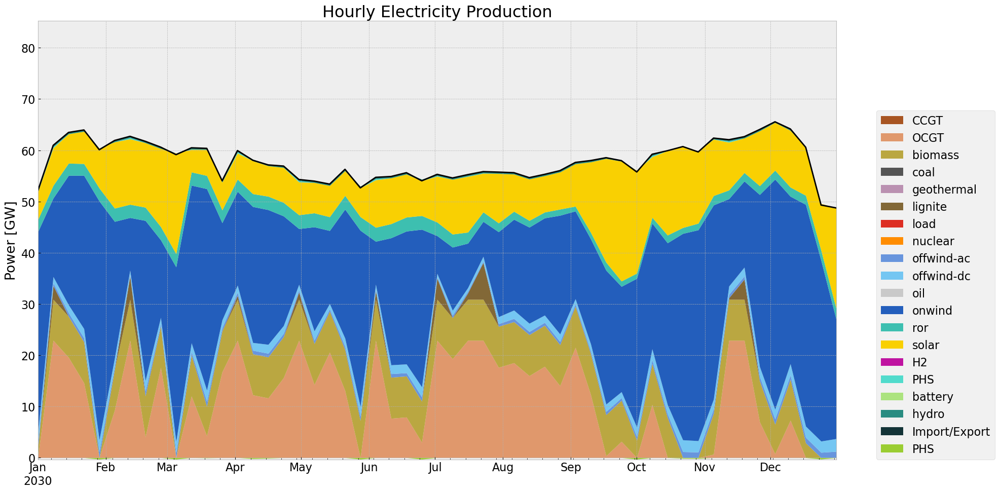

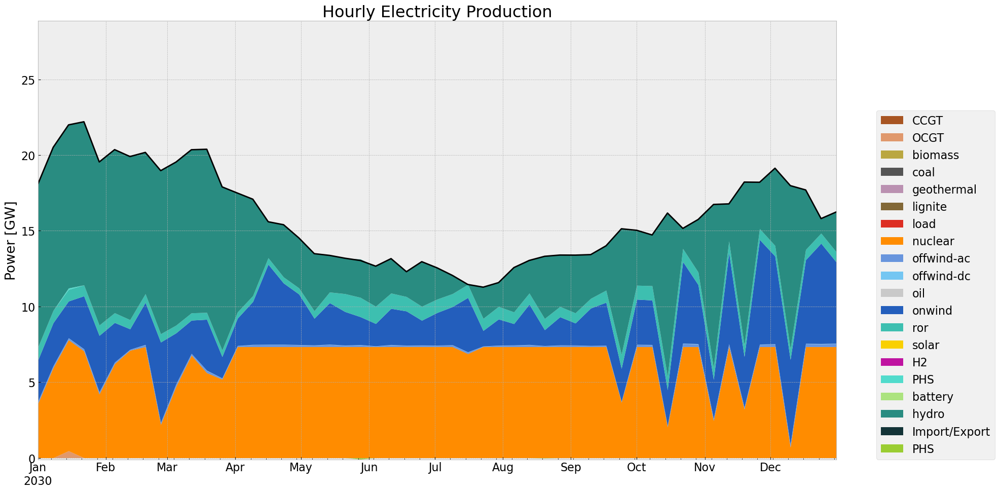

In [75]:
p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n2, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n2, '2030-01-01', '2030-12-31', colors_gen,'SE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\2732365766.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\2732365766.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\2732365766.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\2732365766.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, 

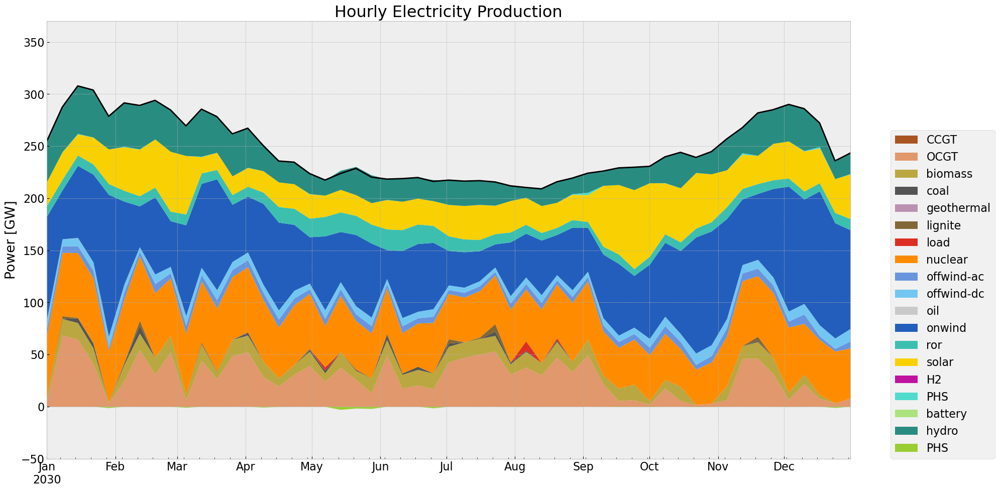

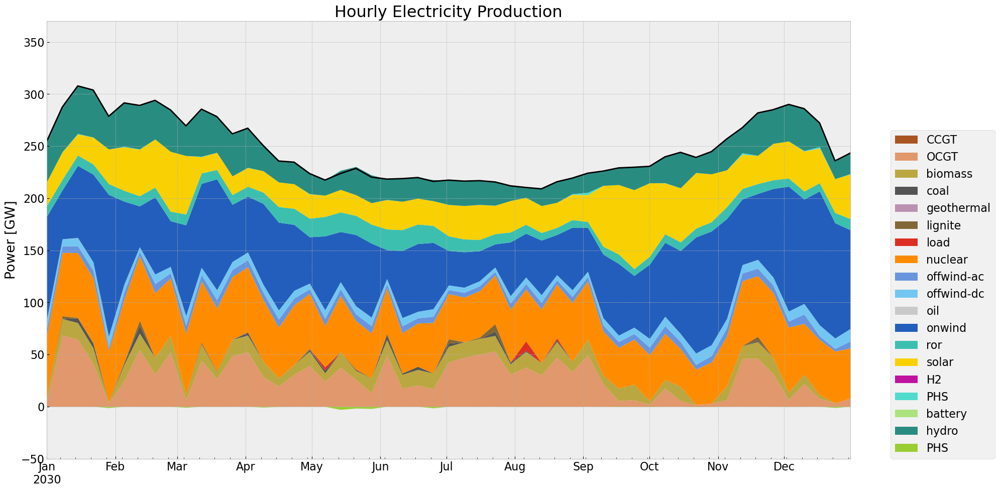

In [76]:
#generation curve all countries
#winter
gen_curve_tot(n2, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n2, '2030-01-01', '2030-12-31', colors_gen)

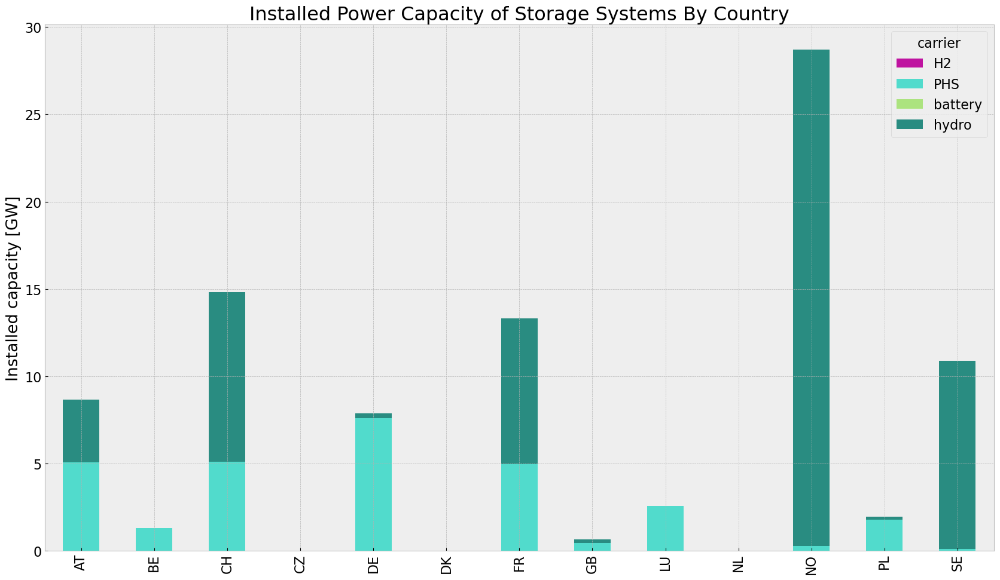

In [77]:
#storage unit capacities
store_noinv = inst_store_table(n2)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\4184885543.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\4184885543.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\4184885543.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\3064997258.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  n2.storage_units_t.p.groupby(n.storage_units.carri

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,1.508625e+06,0.451621,0.1980,661412.721063
biomass,5.995853e+05,0.468000,0.0000,0.000000
coal,4.888943e+04,0.329908,0.3361,49807.027098
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,2.944835e+04,0.337285,0.4069,35526.458423
load,1.393235e+04,1.000000,0.0000,0.000000
nuclear,2.714681e+06,0.326600,0.0000,0.000000
offwind-ac,3.175160e+05,1.000000,0.0000,0.000000


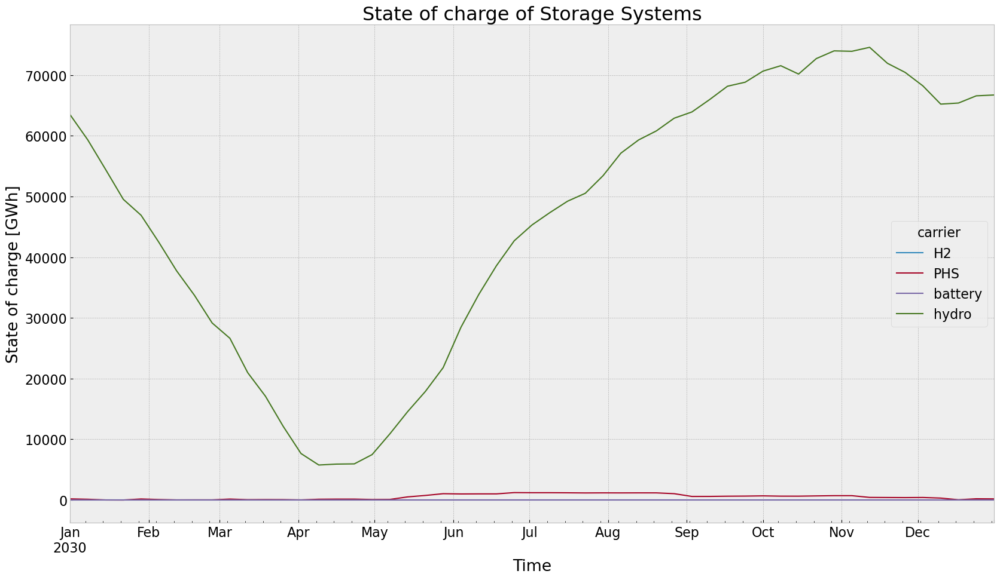

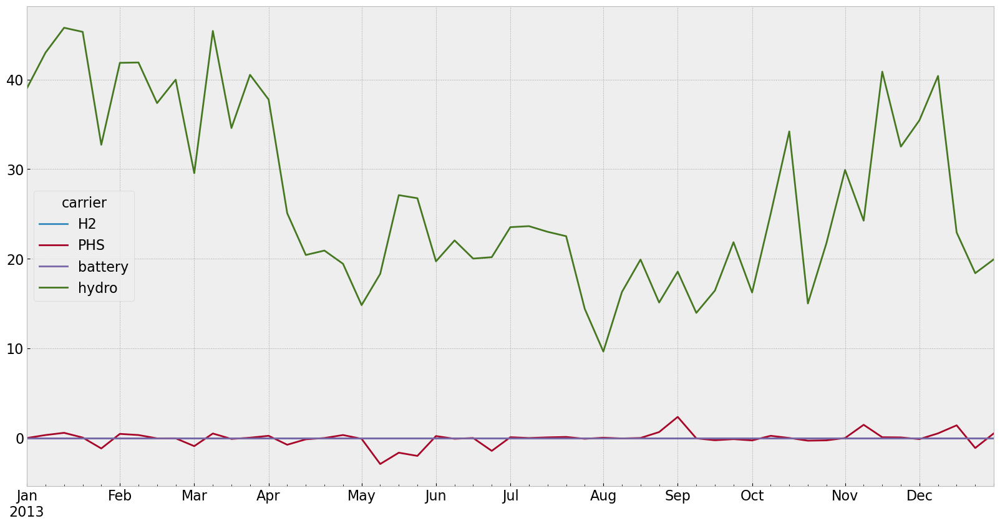

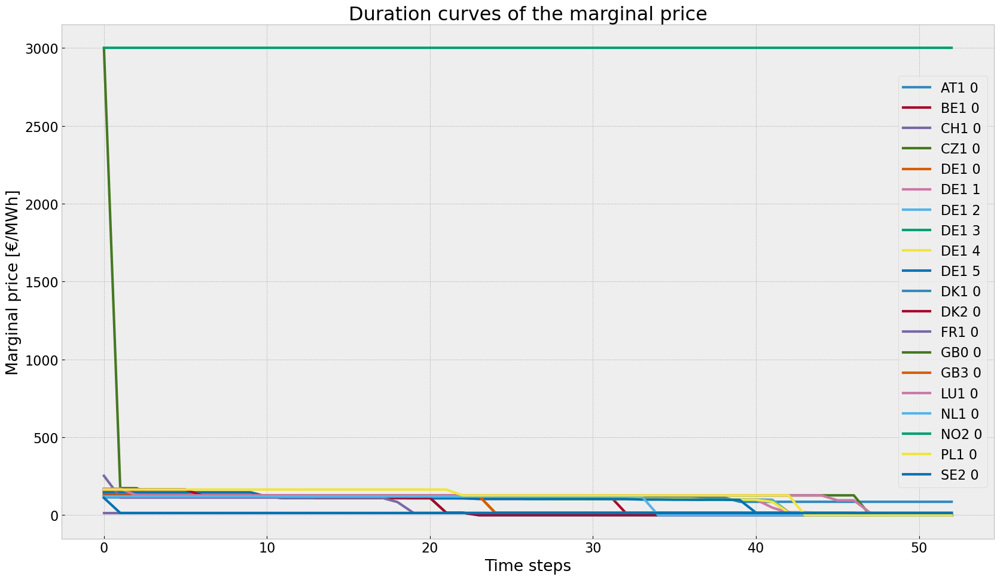

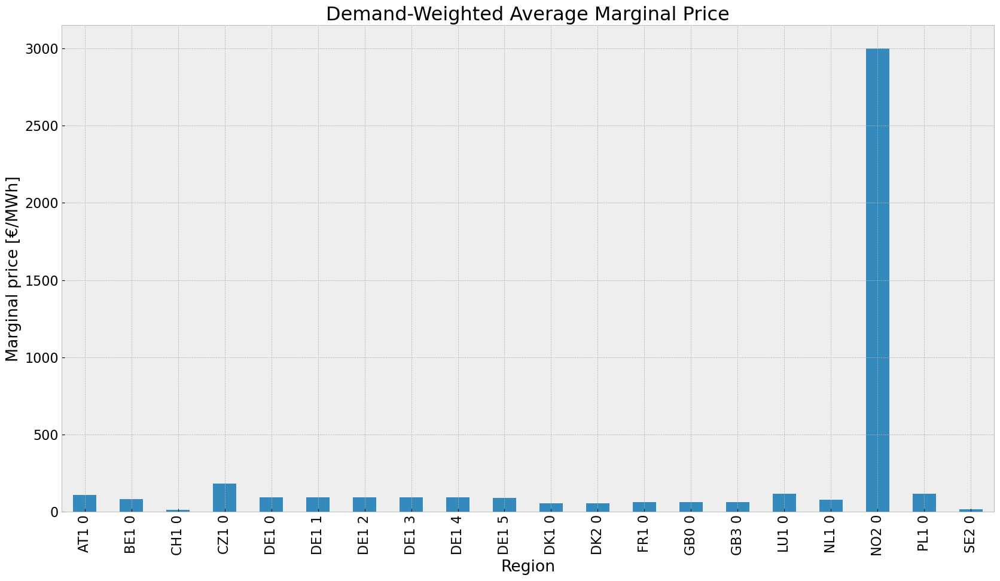

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


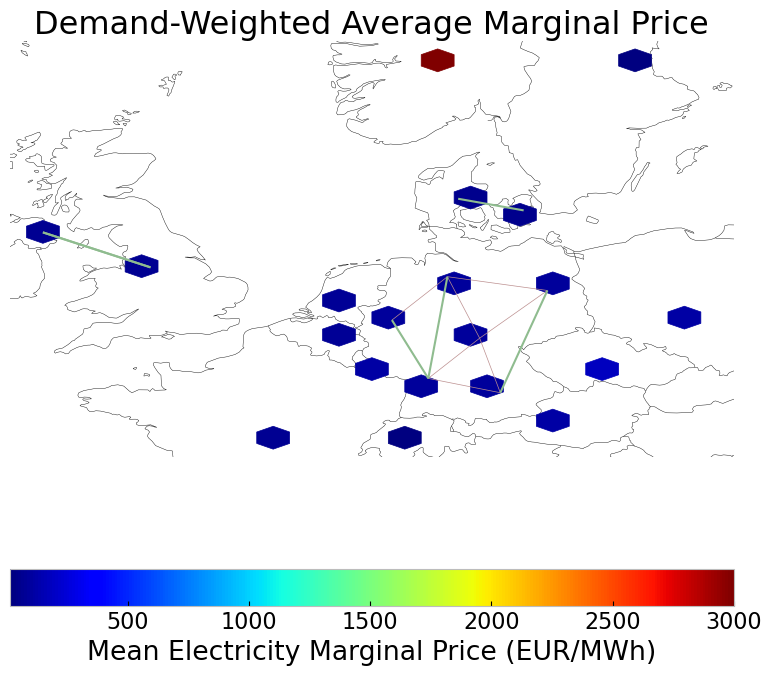

In [78]:
#state of charge
state_of_charge_plot(n2, '2030-01-01 00:00', '2030-12-31 21:00')
n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))
#price
price_dur_curve_plot(n2)
price_regions_table(n2)
price_regions(n2)
#emission
em_noinv =em_table(n2)
em_noinv

## 3. Scenario: rolling horizon foresight with no additional investment

In [79]:
#n3.optimize.create_model()
#add_EQ_constraints(n3, o)
#n2.optimize.solve_model()

In [80]:
n3 = n2.copy()
no_inv(n3,n)

n3.storage_units['cyclic_state_of_charge'] = False
n3.storage_units['cyclic_state_of_charge_per_period'] = False

#n3.optimize.create_model()
#add_EQ_constraints(n3, o)
#n3.optimize.solve_model(solver_name = 'gurobi')


optimize.optimize_with_rolling_horizon(n3, horizon=horizon, overlap=0, solver_name='gurobi')
#filename = f"noinv_roll_{contingency}.nc"
#n3 = import_nc_file(directory, filename)
n3.name = f'noinv_roll_{contingency}'

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g98g0prn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g98g0prn.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0x9b4a40c5


INFO:gurobipy:Model fingerprint: 0x9b4a40c5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3922 rows and 1188 columns


INFO:gurobipy:Presolve removed 3922 rows and 1188 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 190 rows, 732 columns, 1048 nonzeros


INFO:gurobipy:Presolved: 190 rows, 732 columns, 1048 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.0099355e+09   3.263535e+06   0.000000e+00      0s


INFO:gurobipy:       0    5.0099355e+09   3.263535e+06   0.000000e+00      0s


     196    3.6721708e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     196    3.6721708e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 196 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 196 iterations and 0.05 seconds (0.00 work units)


Optimal objective  3.672170751e+10


INFO:gurobipy:Optimal objective  3.672170751e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 3.67e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-785lb3ts.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-785lb3ts.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0x60bc87d7


INFO:gurobipy:Model fingerprint: 0x60bc87d7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3924 rows and 1190 columns


INFO:gurobipy:Presolve removed 3924 rows and 1190 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 188 rows, 730 columns, 1040 nonzeros


INFO:gurobipy:Presolved: 188 rows, 730 columns, 1040 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.8070544e+09   3.129893e+06   0.000000e+00      0s


INFO:gurobipy:       0    8.8070544e+09   3.129893e+06   0.000000e+00      0s


     202    3.8183790e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     202    3.8183790e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 202 iterations and 0.10 seconds (0.00 work units)


INFO:gurobipy:Solved in 202 iterations and 0.10 seconds (0.00 work units)


Optimal objective  3.818378972e+10


INFO:gurobipy:Optimal objective  3.818378972e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 3.82e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8io8suad.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8io8suad.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0xfd35b4f7


INFO:gurobipy:Model fingerprint: 0xfd35b4f7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3925 rows and 1203 columns


INFO:gurobipy:Presolve removed 3925 rows and 1203 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 187 rows, 717 columns, 1024 nonzeros


INFO:gurobipy:Presolved: 187 rows, 717 columns, 1024 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7621273e+09   2.990227e+06   0.000000e+00      0s


INFO:gurobipy:       0    8.7621273e+09   2.990227e+06   0.000000e+00      0s


     181    3.8620794e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     181    3.8620794e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 181 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 181 iterations and 0.06 seconds (0.00 work units)


Optimal objective  3.862079416e+10


INFO:gurobipy:Optimal objective  3.862079416e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 3.86e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8pam3oma.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8pam3oma.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0xcb44e1d9


INFO:gurobipy:Model fingerprint: 0xcb44e1d9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3931 rows and 1201 columns


INFO:gurobipy:Presolve removed 3931 rows and 1201 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 181 rows, 719 columns, 1012 nonzeros


INFO:gurobipy:Presolved: 181 rows, 719 columns, 1012 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2474381e+10   2.606387e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.2474381e+10   2.606387e+06   0.000000e+00      0s


     182    3.4053508e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     182    3.4053508e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 182 iterations and 0.08 seconds (0.00 work units)


INFO:gurobipy:Solved in 182 iterations and 0.08 seconds (0.00 work units)


Optimal objective  3.405350804e+10


INFO:gurobipy:Optimal objective  3.405350804e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 3.41e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w6e1_aie.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w6e1_aie.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0xa6982509


INFO:gurobipy:Model fingerprint: 0xa6982509


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3928 rows and 1192 columns


INFO:gurobipy:Presolve removed 3928 rows and 1192 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 184 rows, 728 columns, 1030 nonzeros


INFO:gurobipy:Presolved: 184 rows, 728 columns, 1030 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.9991100e+09   2.767059e+06   0.000000e+00      0s


INFO:gurobipy:       0    5.9991100e+09   2.767059e+06   0.000000e+00      0s


     205    1.2938043e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     205    1.2938043e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 205 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 205 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.293804261e+10


INFO:gurobipy:Optimal objective  1.293804261e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 1.29e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d0ns4sa3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d0ns4sa3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0xcf77a0a1


INFO:gurobipy:Model fingerprint: 0xcf77a0a1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3938 rows and 1203 columns


INFO:gurobipy:Presolve removed 3938 rows and 1203 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 174 rows, 717 columns, 1003 nonzeros


INFO:gurobipy:Presolved: 174 rows, 717 columns, 1003 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.3821829e+08   2.898422e+06   0.000000e+00      0s


INFO:gurobipy:       0    6.3821829e+08   2.898422e+06   0.000000e+00      0s


     168    2.7259458e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     168    2.7259458e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 168 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 168 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.725945755e+09


INFO:gurobipy:Optimal objective  2.725945755e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 2.73e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yz153iyx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yz153iyx.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0x52e382ad


INFO:gurobipy:Model fingerprint: 0x52e382ad


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3928 rows and 1189 columns


INFO:gurobipy:Presolve removed 3928 rows and 1189 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 184 rows, 731 columns, 1041 nonzeros


INFO:gurobipy:Presolved: 184 rows, 731 columns, 1041 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.8984108e+08   2.796823e+06   0.000000e+00      0s


INFO:gurobipy:       0    7.8984108e+08   2.796823e+06   0.000000e+00      0s


     190    3.2485685e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     190    3.2485685e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 190 iterations and 0.08 seconds (0.00 work units)


INFO:gurobipy:Solved in 190 iterations and 0.08 seconds (0.00 work units)


Optimal objective  3.248568497e+09


INFO:gurobipy:Optimal objective  3.248568497e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 3.25e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h4__jet2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h4__jet2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0x5ed87564


INFO:gurobipy:Model fingerprint: 0x5ed87564


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3928 rows and 1191 columns


INFO:gurobipy:Presolve removed 3928 rows and 1191 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 184 rows, 729 columns, 1033 nonzeros


INFO:gurobipy:Presolved: 184 rows, 729 columns, 1033 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.2485884e+08   2.610883e+06   0.000000e+00      0s


INFO:gurobipy:       0    7.2485884e+08   2.610883e+06   0.000000e+00      0s


     197    4.3309918e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     197    4.3309918e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 197 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 197 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.330991778e+09


INFO:gurobipy:Optimal objective  4.330991778e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 4.33e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q_j54504.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q_j54504.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0xcfe73f2e


INFO:gurobipy:Model fingerprint: 0xcfe73f2e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3928 rows and 1197 columns


INFO:gurobipy:Presolve removed 3928 rows and 1197 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 184 rows, 723 columns, 1027 nonzeros


INFO:gurobipy:Presolved: 184 rows, 723 columns, 1027 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.9706736e+08   2.641237e+06   0.000000e+00      0s


INFO:gurobipy:       0    4.9706736e+08   2.641237e+06   0.000000e+00      0s


     189    3.8454155e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     189    3.8454155e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 189 iterations and 0.11 seconds (0.00 work units)


INFO:gurobipy:Solved in 189 iterations and 0.11 seconds (0.00 work units)


Optimal objective  3.845415488e+09


INFO:gurobipy:Optimal objective  3.845415488e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 3.85e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ml2r5zzu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ml2r5zzu.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0x2a12b8ed


INFO:gurobipy:Model fingerprint: 0x2a12b8ed


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3928 rows and 1197 columns


INFO:gurobipy:Presolve removed 3928 rows and 1197 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 184 rows, 723 columns, 1027 nonzeros


INFO:gurobipy:Presolved: 184 rows, 723 columns, 1027 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3704626e+08   2.641346e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.3704626e+08   2.641346e+06   0.000000e+00      0s


     197    1.0632775e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     197    1.0632775e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 197 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 197 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.063277456e+09


INFO:gurobipy:Optimal objective  1.063277456e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 1.06e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jnlh8z5b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jnlh8z5b.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0x6444f1ac


INFO:gurobipy:Model fingerprint: 0x6444f1ac


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3931 rows and 1219 columns


INFO:gurobipy:Presolve removed 3931 rows and 1219 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 181 rows, 701 columns, 1004 nonzeros


INFO:gurobipy:Presolved: 181 rows, 701 columns, 1004 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8055456e+08   2.693125e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.8055456e+08   2.693125e+06   0.000000e+00      0s


     180    8.9636954e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     180    8.9636954e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 180 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 180 iterations and 0.05 seconds (0.00 work units)


Optimal objective  8.963695421e+08


INFO:gurobipy:Optimal objective  8.963695421e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 8.96e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-et0rjnw4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-et0rjnw4.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0x99a40f86


INFO:gurobipy:Model fingerprint: 0x99a40f86


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3928 rows and 1194 columns


INFO:gurobipy:Presolve removed 3928 rows and 1194 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 184 rows, 726 columns, 1030 nonzeros


INFO:gurobipy:Presolved: 184 rows, 726 columns, 1030 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0301316e+08   2.985238e+06   0.000000e+00      0s


INFO:gurobipy:       0    4.0301316e+08   2.985238e+06   0.000000e+00      0s


     203    3.6181328e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     203    3.6181328e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 203 iterations and 0.08 seconds (0.00 work units)


INFO:gurobipy:Solved in 203 iterations and 0.08 seconds (0.00 work units)


Optimal objective  3.618132773e+09


INFO:gurobipy:Optimal objective  3.618132773e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 3.62e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tawy66k7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tawy66k7.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0x134fe332


INFO:gurobipy:Model fingerprint: 0x134fe332


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3932 rows and 1235 columns


INFO:gurobipy:Presolve removed 3932 rows and 1235 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 180 rows, 685 columns, 988 nonzeros


INFO:gurobipy:Presolved: 180 rows, 685 columns, 988 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.2810574e+07   2.867255e+06   0.000000e+00      0s


INFO:gurobipy:       0    6.2810574e+07   2.867255e+06   0.000000e+00      0s


     190    5.4162404e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     190    5.4162404e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 190 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 190 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.416240367e+09


INFO:gurobipy:Optimal objective  5.416240367e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 5.42e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kw_oguzq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kw_oguzq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 1028 rows, 480 columns, 1564 nonzeros


INFO:gurobipy:obj: 1028 rows, 480 columns, 1564 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1028 rows, 480 columns and 1564 nonzeros


INFO:gurobipy:Optimize a model with 1028 rows, 480 columns and 1564 nonzeros


Model fingerprint: 0xfcd88755


INFO:gurobipy:Model fingerprint: 0xfcd88755


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 5e+01]


INFO:gurobipy:  Matrix range     [1e+00, 5e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 995 rows and 345 columns


INFO:gurobipy:Presolve removed 995 rows and 345 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 33 rows, 135 columns, 183 nonzeros


INFO:gurobipy:Presolved: 33 rows, 135 columns, 183 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1402133e+07   1.300562e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1402133e+07   1.300562e+05   0.000000e+00      0s


      33    1.2623505e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      33    1.2623505e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 33 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 33 iterations and 0.07 seconds (0.00 work units)


Optimal objective  1.262350454e+08


INFO:gurobipy:Optimal objective  1.262350454e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 480 primals, 1028 duals
Objective: 1.26e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Export Model for later use

In [81]:
filename = f"{n3.name}.nc"
output_path = os.path.join(os.getcwd(), filename)
n3.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network noinv_roll_pv.nc has lines, links, generators, global_constraints, carriers, loads, storage_units, buses


<xarray.Dataset> Size: 239kB
Dimensions:                                          (snapshots: 53,
                                                      investment_periods: 0,
                                                      lines_i: 8,
                                                      lines_t_p0_i: 8,
                                                      lines_t_p1_i: 8,
                                                      lines_t_loss_i: 8,
                                                      ...
                                                      storage_units_t_state_of_charge_i: 65,
                                                      storage_units_t_spill_i: 7,
                                                      buses_i: 20,
                                                      buses_t_p_i: 20,
                                                      buses_t_v_ang_i: 6,
                                                      buses_t_marginal_price_i: 20)
Coordinates: (12/28)
  * snapshots                                        (snapshots) int64 424B 0...
  * investment_periods                               (investment_periods) int64 0B ...
  * lines_i                                          (lines_i) object 64B '12...
  * lines_t_p0_i                                     (lines_t_p0_i) object 64B ...
  * lines_t_p1_i                                     (lines_t_p1_i) object 64B ...
  * lines_t_loss_i                                   (lines_t_loss_i) object 64B ...
    ...                                               ...
  * storage_units_t_state_of_charge_i                (storage_units_t_state_of_charge_i) object 520B ...
  * storage_units_t_spill_i                          (storage_units_t_spill_i) object 56B ...
  * buses_i                                          (buses_i) object 160B 'A...
  * buses_t_p_i                                      (buses_t_p_i) object 160B ...
  * buses_t_v_ang_i                                  (buses_t_v_ang_i) object 48B ...
  * buses_t_marginal_price_i                         (buses_t_marginal_price_i) object 160B ...
Data variables: (12/100)
    snapshots_snapshot                               (snapshots) datetime64[ns] 424B ...
    snapshots_objective                              (snapshots) float64 424B ...
    snapshots_generators                             (snapshots) float64 424B ...
    snapshots_stores                                 (snapshots) float64 424B ...
    investment_periods_objective                     (investment_periods) float64 0B ...
    investment_periods_years                         (investment_periods) float64 0B ...
    ...                                               ...
    buses_country                                    (buses_i) object 160B 'A...
    buses_control                                    (buses_i) object 160B 'S...
    buses_generator                                  (buses_i) object 160B 'A...
    buses_t_p                                        (snapshots, buses_t_p_i) float64 8kB ...
    buses_t_v_ang                                    (snapshots, buses_t_v_ang_i) float64 3kB ...
    buses_t_marginal_price                           (snapshots, buses_t_marginal_price_i) float64 8kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            noinv_roll_pv
    network_objective:       126235045.43656793
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [82]:
tot_cos_noinv_roll=n3.objective/1e9 #billion €
system_cost_noinv_roll = system_cost(n3) #million €/a
marg_price_region_noinv_roll = n3.buses_t.marginal_price.mean()
stat_noinv_roll = n3.statistics()

<Figure size 640x480 with 0 Axes>

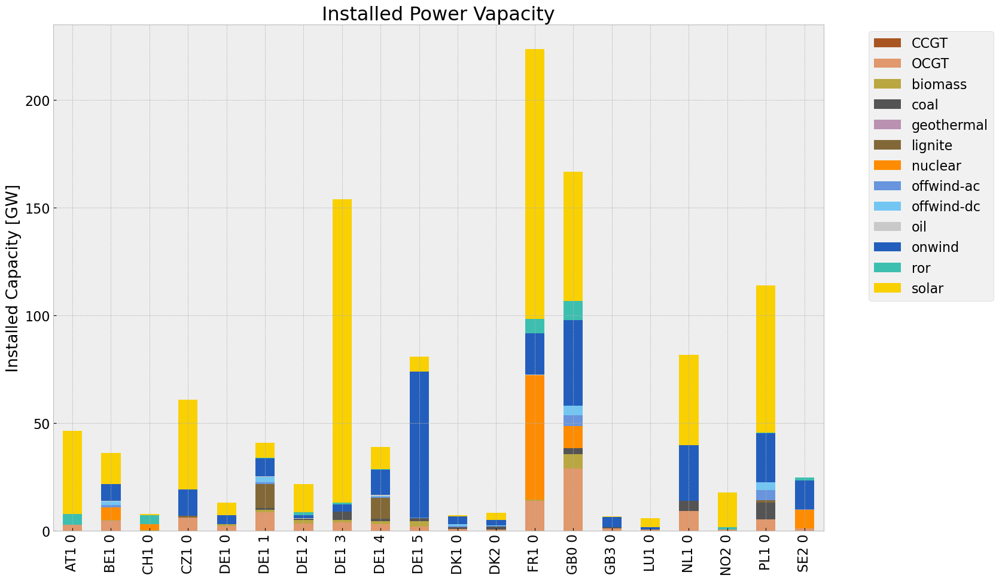

<Figure size 640x480 with 0 Axes>

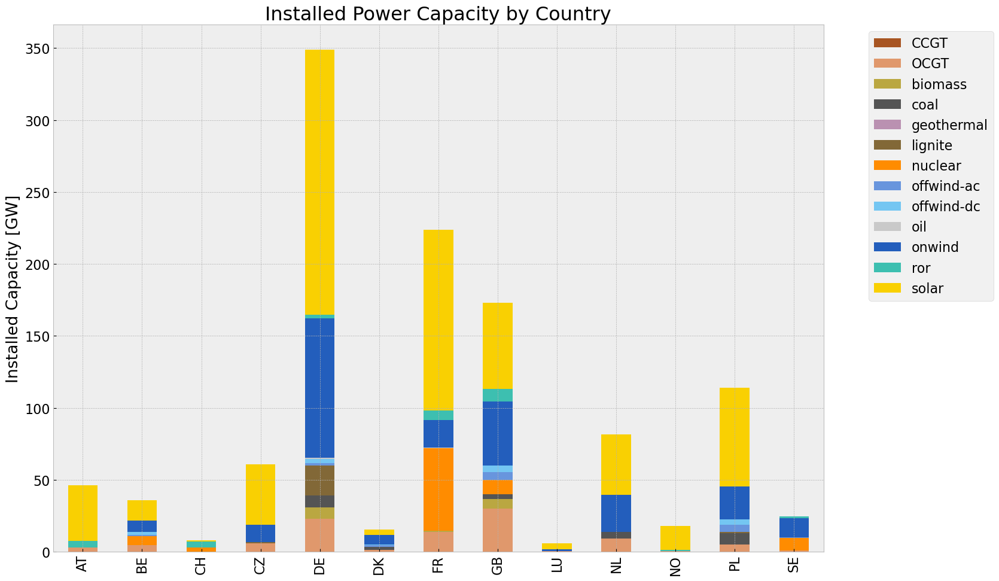

<Figure size 640x480 with 0 Axes>

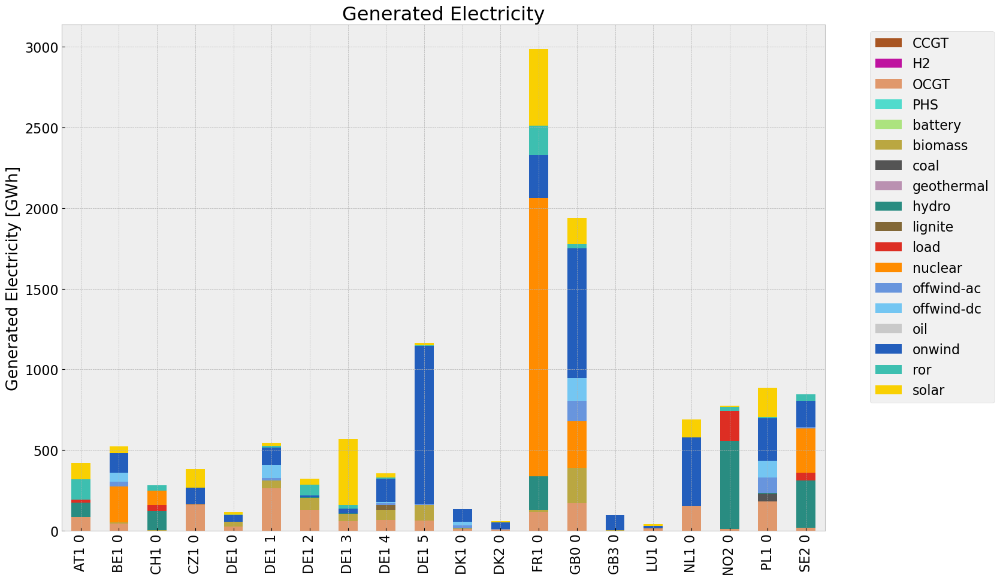

<Figure size 640x480 with 0 Axes>

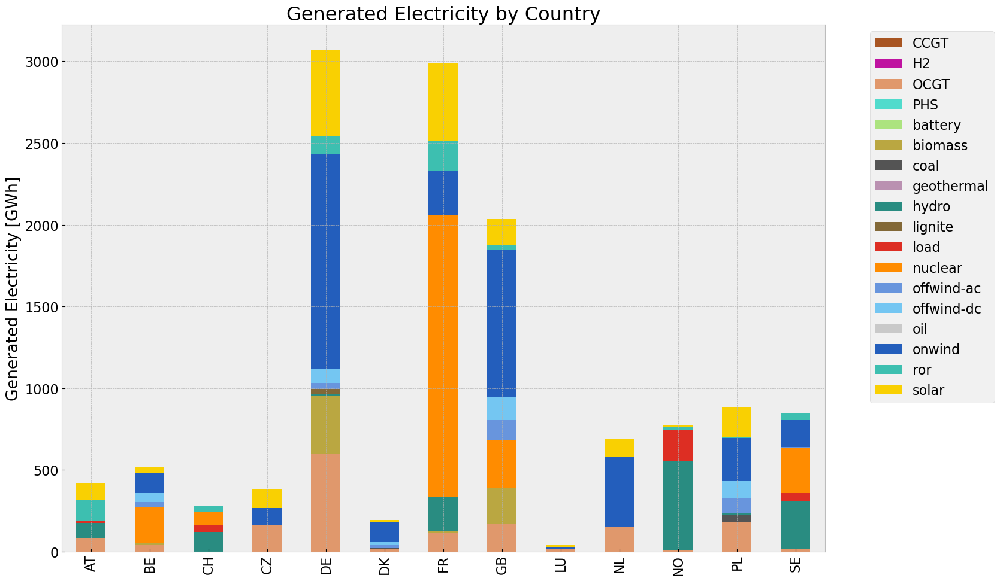

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\923320227.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\923320227.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\923320227.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\923320227.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Users\

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,1.570358e+06,0.451621,0.1980,688477.653944
biomass,6.001846e+05,0.468000,0.0000,0.000000
coal,4.919758e+04,0.329908,0.3361,50120.953883
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,2.991250e+04,0.337285,0.4069,36086.408155
load,2.899279e+05,1.000000,0.0000,0.000000
nuclear,2.599221e+06,0.326600,0.0000,0.000000
offwind-ac,3.171471e+05,1.000000,0.0000,0.000000


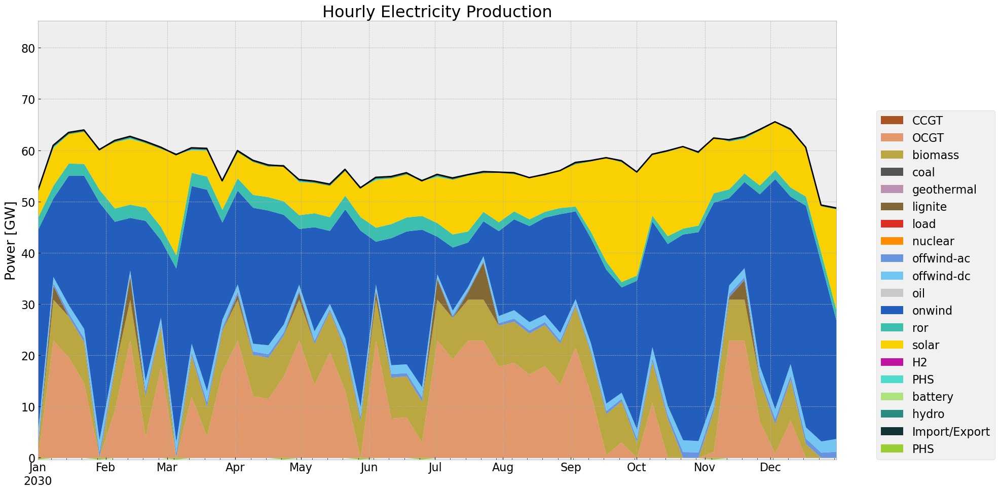

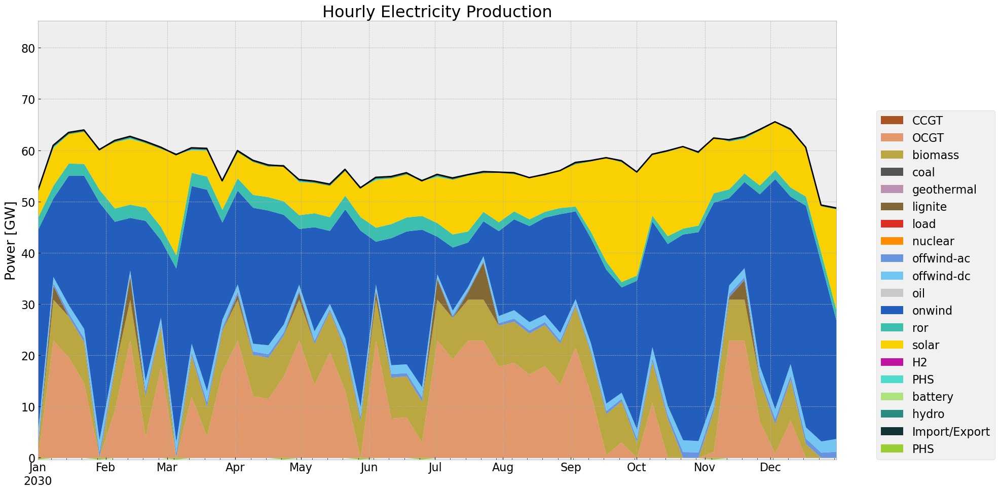

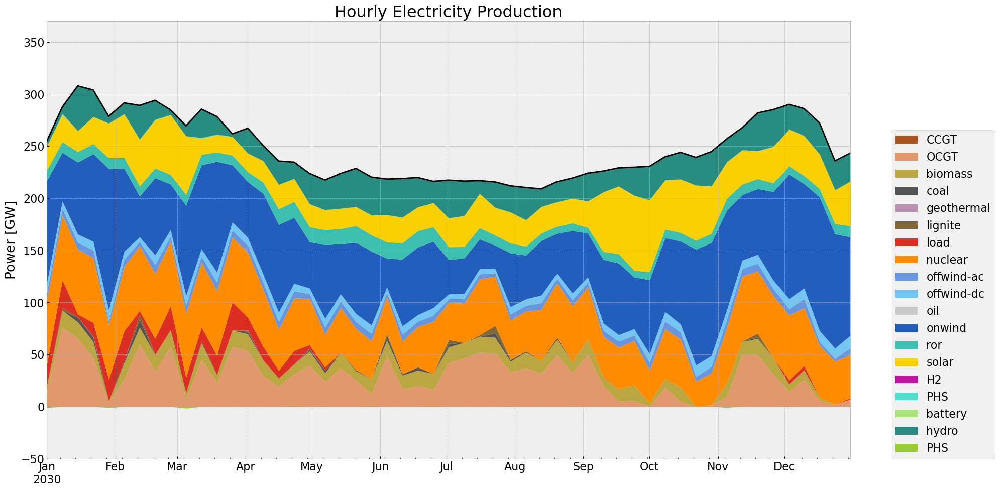

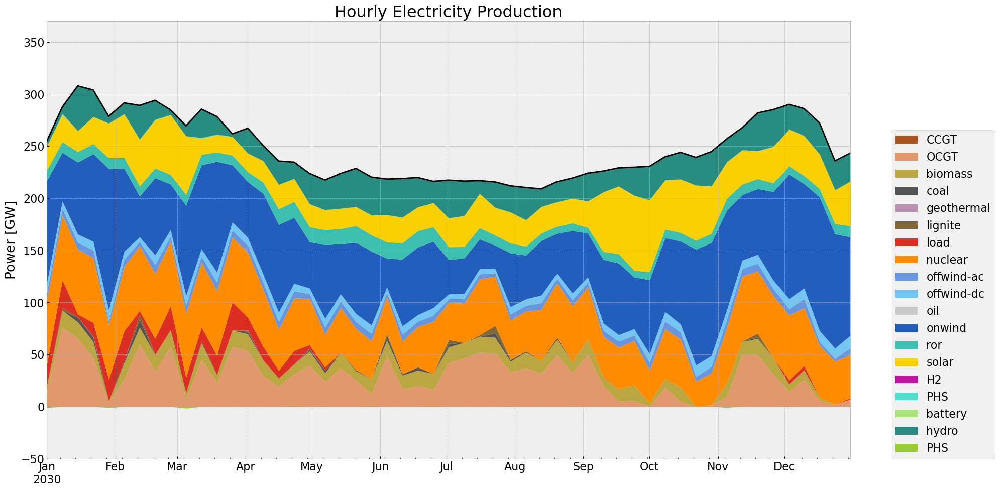

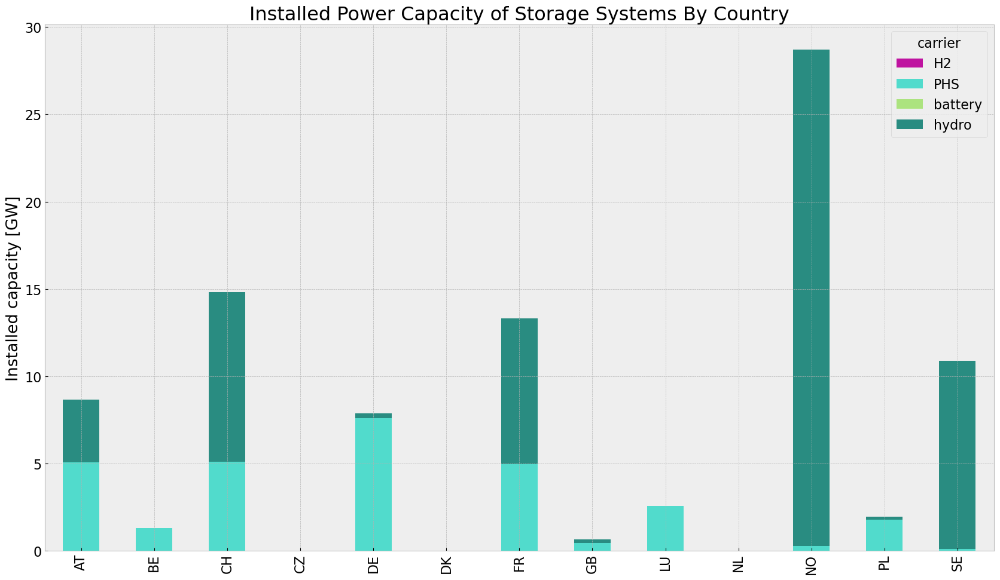

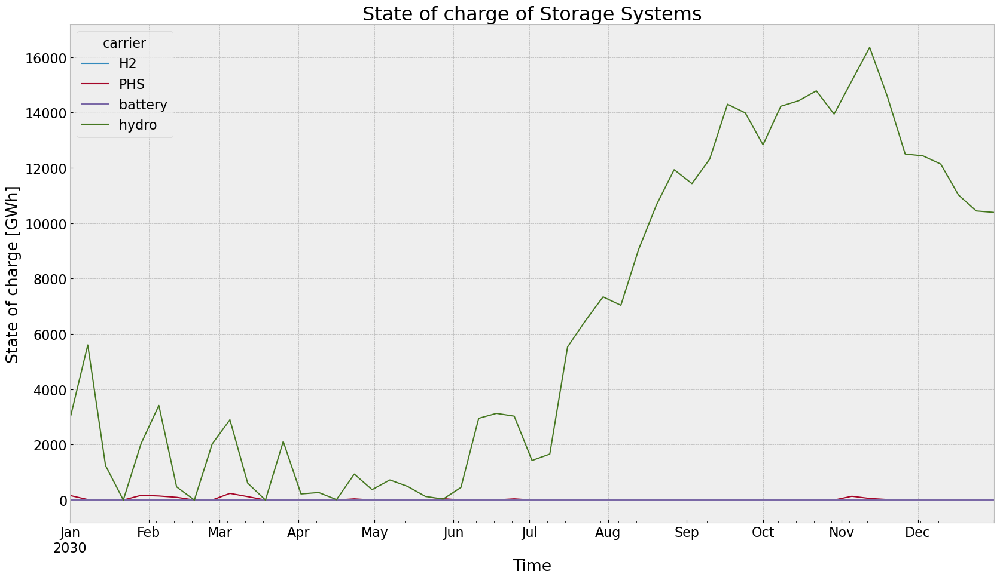

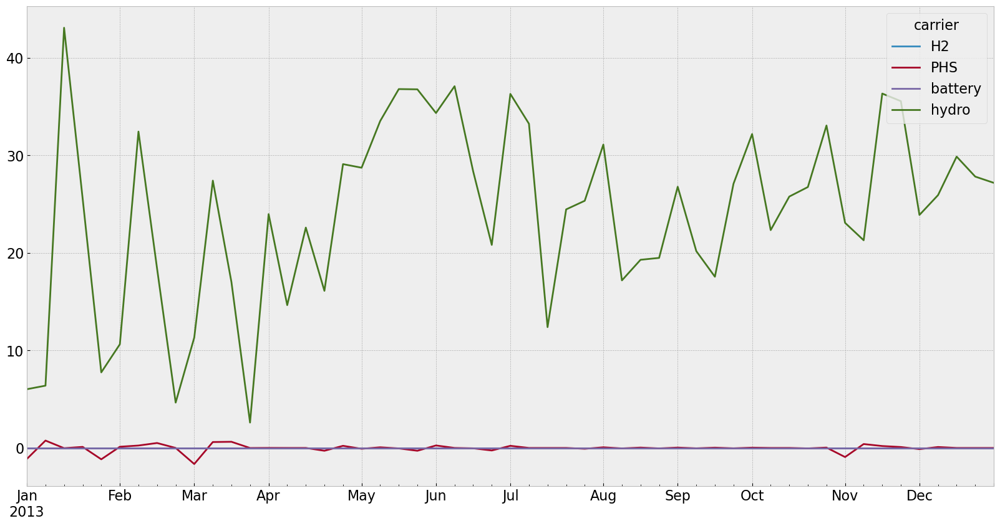

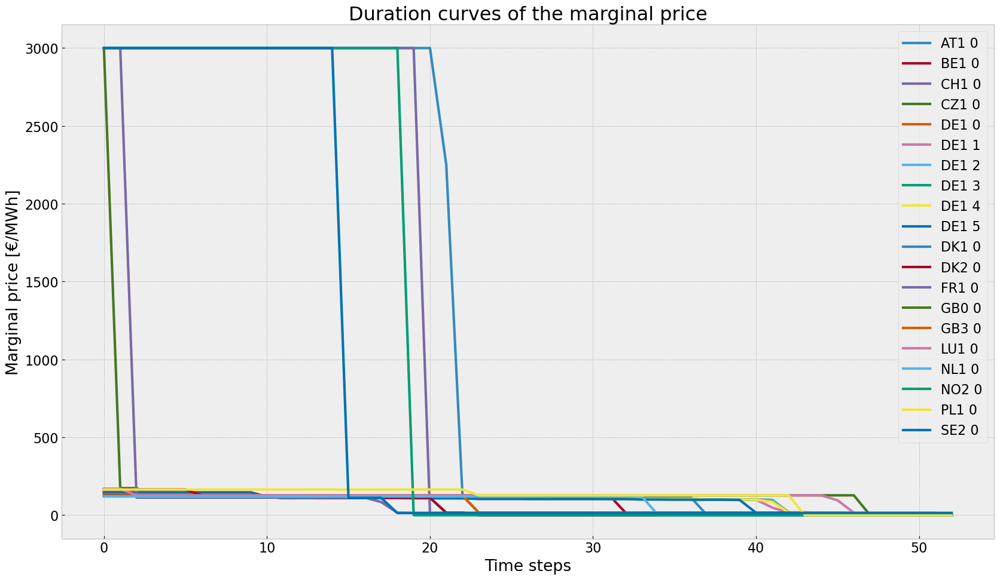

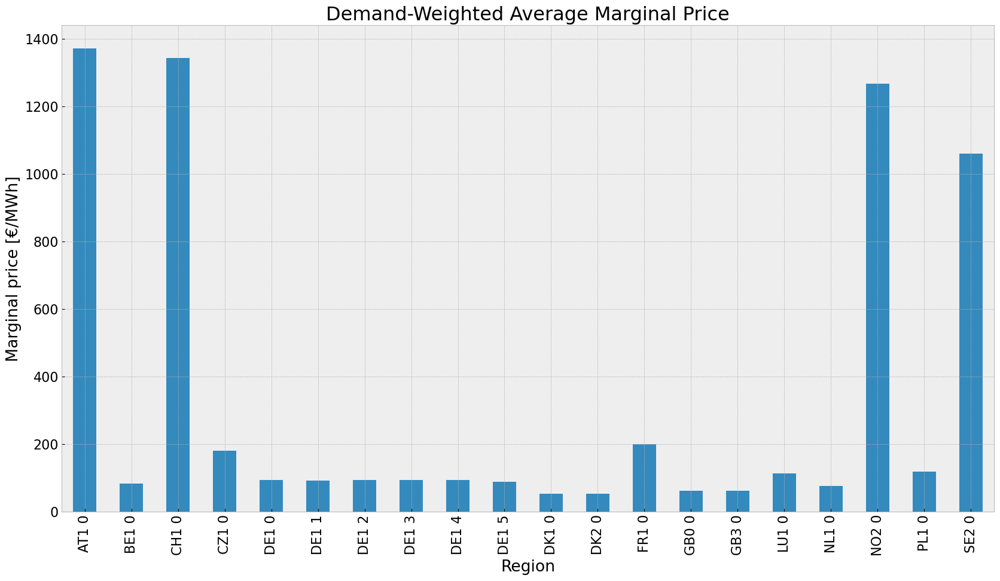

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


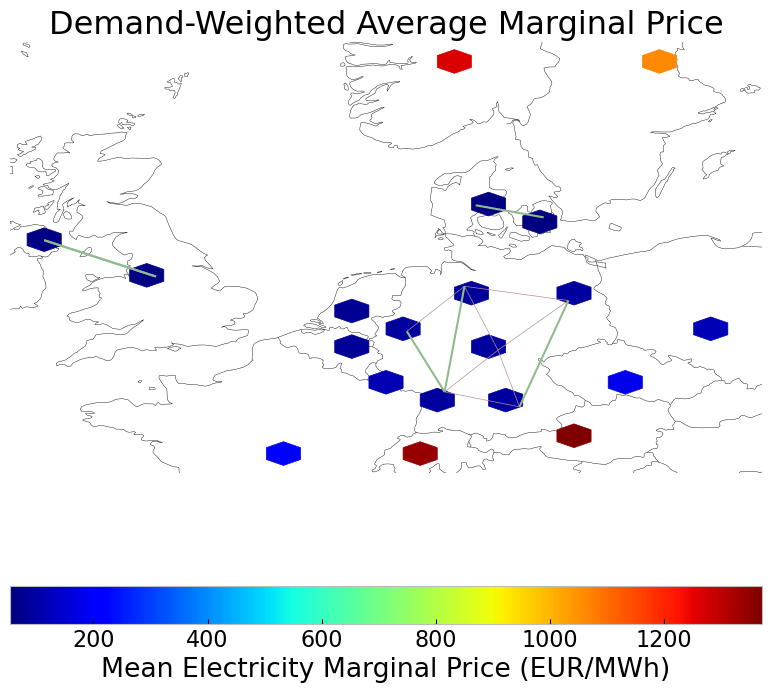

In [83]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv_roll = inst_cap_table(n3, color_cap)
cap_noinv_roll_country = inst_cap_table_country(n3, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_noinv_roll  = gen_power_table(n3)
gen_noinv_roll_country = gen_power_table_country(n3)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n3, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n3, '2030-01-01', '2030-12-31', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n3, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n3, '2030-01-01', '2030-12-31', colors_gen)

#installed storage unit & stores
store_noinv_roll = inst_store_table(n3)

#State of Charge Storage unit
state_of_charge_plot(n3, '2030-01-01 00:00', '2030-12-31 21:00')
n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n3)

#avg electricity price
price_regions_table(n3)
price_regions(n3)

#Emission
em_noinv_roll =em_table(n3)
em_noinv_roll

## 4. Allowed Investment scenario solved with Rolling Horizon

In [84]:
n4 = n1.copy()

no_inv(n4,n1)

n4.storage_units['cyclic_state_of_charge'] = False
n4.storage_units['cyclic_state_of_charge_per_period'] = False

#n4.optimize.create_model()
#add_EQ_constraints(n4, o)
#n4.optimize.solve_model(solver_name = 'gurobi')


optimize.optimize_with_rolling_horizon(n4, horizon=horizon, overlap=0, solver_name='gurobi')
#filename = f"inv_roll_{contingency}.nc"
#n4 = import_nc_file(directory, filename)
n4.name = f'inv_roll_{contingency}'

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).
Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a1ytqvso.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a1ytqvso.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0xcceb1cc7


INFO:gurobipy:Model fingerprint: 0xcceb1cc7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3926 rows and 1203 columns


INFO:gurobipy:Presolve removed 3926 rows and 1203 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 186 rows, 717 columns, 1029 nonzeros


INFO:gurobipy:Presolved: 186 rows, 717 columns, 1029 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8070021e+09   3.297632e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.8070021e+09   3.297632e+06   0.000000e+00      0s


     186    3.2147051e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     186    3.2147051e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 186 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 186 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.214705086e+10


INFO:gurobipy:Optimal objective  3.214705086e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 3.21e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', 'D

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qagqpaiw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qagqpaiw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0x6efb4069


INFO:gurobipy:Model fingerprint: 0x6efb4069


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3930 rows and 1219 columns


INFO:gurobipy:Presolve removed 3930 rows and 1219 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 182 rows, 701 columns, 1006 nonzeros


INFO:gurobipy:Presolved: 182 rows, 701 columns, 1006 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.9698814e+09   3.010257e+06   0.000000e+00      0s


INFO:gurobipy:       0    7.9698814e+09   3.010257e+06   0.000000e+00      0s


     182    3.4499732e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     182    3.4499732e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 182 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 182 iterations and 0.07 seconds (0.00 work units)


Optimal objective  3.449973154e+10


INFO:gurobipy:Optimal objective  3.449973154e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 3.45e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', 'D

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rm7z6brl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rm7z6brl.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0x2d460c36


INFO:gurobipy:Model fingerprint: 0x2d460c36


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3928 rows and 1216 columns


INFO:gurobipy:Presolve removed 3928 rows and 1216 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 184 rows, 704 columns, 1010 nonzeros


INFO:gurobipy:Presolved: 184 rows, 704 columns, 1010 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1590407e+09   2.910486e+06   0.000000e+00      0s


INFO:gurobipy:       0    7.1590407e+09   2.910486e+06   0.000000e+00      0s


     192    3.4603848e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     192    3.4603848e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 192 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 192 iterations and 0.05 seconds (0.00 work units)


Optimal objective  3.460384839e+10


INFO:gurobipy:Optimal objective  3.460384839e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 3.46e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', 'D

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4uuiljii.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4uuiljii.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0x14285a2b


INFO:gurobipy:Model fingerprint: 0x14285a2b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3933 rows and 1218 columns


INFO:gurobipy:Presolve removed 3933 rows and 1218 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 179 rows, 702 columns, 995 nonzeros


INFO:gurobipy:Presolved: 179 rows, 702 columns, 995 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1222221e+10   2.547275e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.1222221e+10   2.547275e+06   0.000000e+00      0s


     184    3.0354495e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     184    3.0354495e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 184 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 184 iterations and 0.05 seconds (0.00 work units)


Optimal objective  3.035449491e+10


INFO:gurobipy:Optimal objective  3.035449491e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 3.04e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', 'D

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-76xhpg18.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-76xhpg18.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0xfe11e521


INFO:gurobipy:Model fingerprint: 0xfe11e521


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3929 rows and 1194 columns


INFO:gurobipy:Presolve removed 3929 rows and 1194 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 183 rows, 726 columns, 1028 nonzeros


INFO:gurobipy:Presolved: 183 rows, 726 columns, 1028 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7776116e+09   2.886921e+06   0.000000e+00      0s


INFO:gurobipy:       0    4.7776116e+09   2.886921e+06   0.000000e+00      0s


     185    1.0306329e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     185    1.0306329e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 185 iterations and 0.09 seconds (0.00 work units)


INFO:gurobipy:Solved in 185 iterations and 0.09 seconds (0.00 work units)


Optimal objective  1.030632915e+10


INFO:gurobipy:Optimal objective  1.030632915e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 1.03e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', 'D

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-puv7bhge.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-puv7bhge.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0x094571ce


INFO:gurobipy:Model fingerprint: 0x094571ce


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3939 rows and 1211 columns


INFO:gurobipy:Presolve removed 3939 rows and 1211 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 173 rows, 709 columns, 995 nonzeros


INFO:gurobipy:Presolved: 173 rows, 709 columns, 995 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.5224138e+08   2.827692e+06   0.000000e+00      0s


INFO:gurobipy:       0    5.5224138e+08   2.827692e+06   0.000000e+00      0s


     162    1.6818704e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     162    1.6818704e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 162 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 162 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.681870429e+09


INFO:gurobipy:Optimal objective  1.681870429e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 1.68e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', 'D

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ndrkl9cl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ndrkl9cl.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0x3e44e7a0


INFO:gurobipy:Model fingerprint: 0x3e44e7a0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3929 rows and 1183 columns


INFO:gurobipy:Presolve removed 3929 rows and 1183 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 183 rows, 737 columns, 1047 nonzeros


INFO:gurobipy:Presolved: 183 rows, 737 columns, 1047 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.3469291e+08   2.871976e+06   0.000000e+00      0s


INFO:gurobipy:       0    4.3469291e+08   2.871976e+06   0.000000e+00      0s


     189    2.1826446e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     189    2.1826446e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 189 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 189 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.182644639e+09


INFO:gurobipy:Optimal objective  2.182644639e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 2.18e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', 'D

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9zl2qopl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9zl2qopl.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0x4555d4ef


INFO:gurobipy:Model fingerprint: 0x4555d4ef


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3928 rows and 1189 columns


INFO:gurobipy:Presolve removed 3928 rows and 1189 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 184 rows, 731 columns, 1035 nonzeros


INFO:gurobipy:Presolved: 184 rows, 731 columns, 1035 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.0262147e+08   2.581074e+06   0.000000e+00      0s


INFO:gurobipy:       0    6.0262147e+08   2.581074e+06   0.000000e+00      0s


     186    3.1298470e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     186    3.1298470e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 186 iterations and 0.08 seconds (0.00 work units)


INFO:gurobipy:Solved in 186 iterations and 0.08 seconds (0.00 work units)


Optimal objective  3.129847004e+09


INFO:gurobipy:Optimal objective  3.129847004e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 3.13e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', 'D

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q0t_h90o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q0t_h90o.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0x958205d7


INFO:gurobipy:Model fingerprint: 0x958205d7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3928 rows and 1206 columns


INFO:gurobipy:Presolve removed 3928 rows and 1206 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 184 rows, 714 columns, 1018 nonzeros


INFO:gurobipy:Presolved: 184 rows, 714 columns, 1018 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2861988e+08   2.563503e+06   0.000000e+00      0s


INFO:gurobipy:       0    4.2861988e+08   2.563503e+06   0.000000e+00      0s


     189    2.4887347e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     189    2.4887347e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 189 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 189 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.488734721e+09


INFO:gurobipy:Optimal objective  2.488734721e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 2.49e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', '

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8e0hckpj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8e0hckpj.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0xf70e49cc


INFO:gurobipy:Model fingerprint: 0xf70e49cc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3930 rows and 1211 columns


INFO:gurobipy:Presolve removed 3930 rows and 1211 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 182 rows, 709 columns, 1013 nonzeros


INFO:gurobipy:Presolved: 182 rows, 709 columns, 1013 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0813800e+08   2.662677e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.0813800e+08   2.662677e+06   0.000000e+00      0s


     177    5.2513016e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     177    5.2513016e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 177 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 177 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.251301560e+08


INFO:gurobipy:Optimal objective  5.251301560e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 5.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', '

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5nm0yzmk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5nm0yzmk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0xac731697


INFO:gurobipy:Model fingerprint: 0xac731697


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3933 rows and 1225 columns


INFO:gurobipy:Presolve removed 3933 rows and 1225 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 179 rows, 695 columns, 997 nonzeros


INFO:gurobipy:Presolved: 179 rows, 695 columns, 997 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2003612e+08   2.691499e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.2003612e+08   2.691499e+06   0.000000e+00      0s


     174    3.6199743e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     174    3.6199743e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 174 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 174 iterations and 0.07 seconds (0.00 work units)


Optimal objective  3.619974269e+08


INFO:gurobipy:Optimal objective  3.619974269e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 3.62e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', '

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ul9t4und.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ul9t4und.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0xd16fbdea


INFO:gurobipy:Model fingerprint: 0xd16fbdea


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3929 rows and 1207 columns


INFO:gurobipy:Presolve removed 3929 rows and 1207 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 183 rows, 713 columns, 1017 nonzeros


INFO:gurobipy:Presolved: 183 rows, 713 columns, 1017 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5636705e+08   2.950347e+06   0.000000e+00      0s


INFO:gurobipy:       0    2.5636705e+08   2.950347e+06   0.000000e+00      0s


     197    1.9711602e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     197    1.9711602e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 197 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 197 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.971160233e+09


INFO:gurobipy:Optimal objective  1.971160233e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 1.97e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', '

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.36s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1_v4dmcu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1_v4dmcu.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0x57223f16


INFO:gurobipy:Model fingerprint: 0x57223f16


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3941 rows and 1261 columns


INFO:gurobipy:Presolve removed 3941 rows and 1261 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 171 rows, 659 columns, 952 nonzeros


INFO:gurobipy:Presolved: 171 rows, 659 columns, 952 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3958643e+08   2.711694e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.3958643e+08   2.711694e+06   0.000000e+00      0s


     195    4.2609956e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    4.2609956e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.05 seconds (0.00 work units)


Optimal objective  4.260995630e+09


INFO:gurobipy:Optimal objective  4.260995630e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 4.26e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', '

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zrtckj8y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zrtckj8y.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 1028 rows, 480 columns, 1564 nonzeros


INFO:gurobipy:obj: 1028 rows, 480 columns, 1564 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1028 rows, 480 columns and 1564 nonzeros


INFO:gurobipy:Optimize a model with 1028 rows, 480 columns and 1564 nonzeros


Model fingerprint: 0x1577c291


INFO:gurobipy:Model fingerprint: 0x1577c291


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 5e+01]


INFO:gurobipy:  Matrix range     [1e+00, 5e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 995 rows and 349 columns


INFO:gurobipy:Presolve removed 995 rows and 349 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 33 rows, 131 columns, 179 nonzeros


INFO:gurobipy:Presolved: 33 rows, 131 columns, 179 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0193849e+07   1.366271e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0193849e+07   1.366271e+05   0.000000e+00      0s


      36    1.2138130e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      36    1.2138130e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 36 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 36 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.213812988e+08


INFO:gurobipy:Optimal objective  1.213812988e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 480 primals, 1028 duals
Objective: 1.21e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Export Model for later use

In [85]:
filename = f"{n4.name}.nc"
output_path = os.path.join(os.getcwd(), filename)
n4.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network inv_roll_pv.nc has lines, links, generators, carriers, loads, storage_units, buses


<xarray.Dataset> Size: 238kB
Dimensions:                                          (snapshots: 53,
                                                      investment_periods: 0,
                                                      lines_i: 8,
                                                      lines_t_p0_i: 8,
                                                      lines_t_p1_i: 8,
                                                      lines_t_loss_i: 8,
                                                      ...
                                                      storage_units_t_state_of_charge_i: 65,
                                                      storage_units_t_spill_i: 7,
                                                      buses_i: 20,
                                                      buses_t_p_i: 20,
                                                      buses_t_v_ang_i: 6,
                                                      buses_t_marginal_price_i: 20)
Coordinates: (12/27)
  * snapshots                                        (snapshots) int64 424B 0...
  * investment_periods                               (investment_periods) int64 0B ...
  * lines_i                                          (lines_i) object 64B '12...
  * lines_t_p0_i                                     (lines_t_p0_i) object 64B ...
  * lines_t_p1_i                                     (lines_t_p1_i) object 64B ...
  * lines_t_loss_i                                   (lines_t_loss_i) object 64B ...
    ...                                               ...
  * storage_units_t_state_of_charge_i                (storage_units_t_state_of_charge_i) object 520B ...
  * storage_units_t_spill_i                          (storage_units_t_spill_i) object 56B ...
  * buses_i                                          (buses_i) object 160B 'A...
  * buses_t_p_i                                      (buses_t_p_i) object 160B ...
  * buses_t_v_ang_i                                  (buses_t_v_ang_i) object 48B ...
  * buses_t_marginal_price_i                         (buses_t_marginal_price_i) object 160B ...
Data variables: (12/98)
    snapshots_snapshot                               (snapshots) datetime64[ns] 424B ...
    snapshots_objective                              (snapshots) float64 424B ...
    snapshots_generators                             (snapshots) float64 424B ...
    snapshots_stores                                 (snapshots) float64 424B ...
    investment_periods_objective                     (investment_periods) float64 0B ...
    investment_periods_years                         (investment_periods) float64 0B ...
    ...                                               ...
    buses_country                                    (buses_i) object 160B 'A...
    buses_control                                    (buses_i) object 160B 'S...
    buses_generator                                  (buses_i) object 160B 'A...
    buses_t_p                                        (snapshots, buses_t_p_i) float64 8kB ...
    buses_t_v_ang                                    (snapshots, buses_t_v_ang_i) float64 3kB ...
    buses_t_marginal_price                           (snapshots, buses_t_marginal_price_i) float64 8kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            inv_roll_pv
    network_objective:       121381298.75121634
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [86]:
tot_cos_inv_roll= n4.objective/1e9 #billion €
system_cost_inv_roll = system_cost(n4) #million €/a
marg_price_region_inv_roll = n4.buses_t.marginal_price.mean()
stat_inv_roll = n4.statistics()

<Figure size 640x480 with 0 Axes>

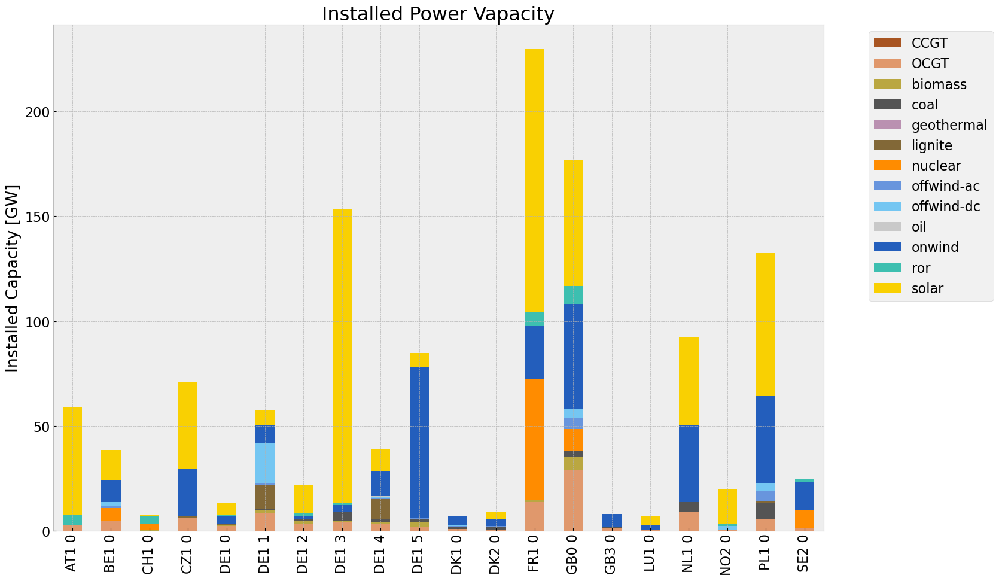

<Figure size 640x480 with 0 Axes>

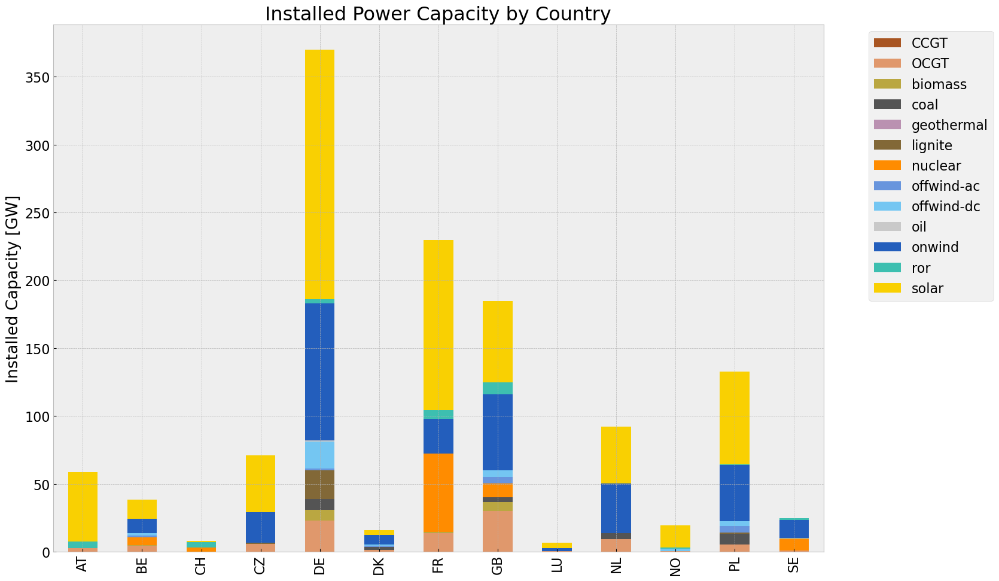

<Figure size 640x480 with 0 Axes>

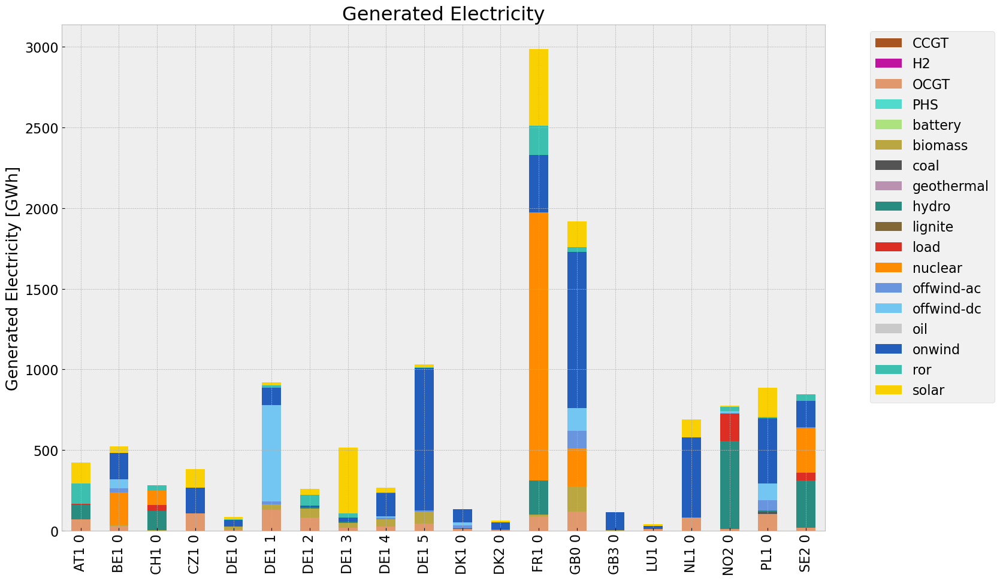

<Figure size 640x480 with 0 Axes>

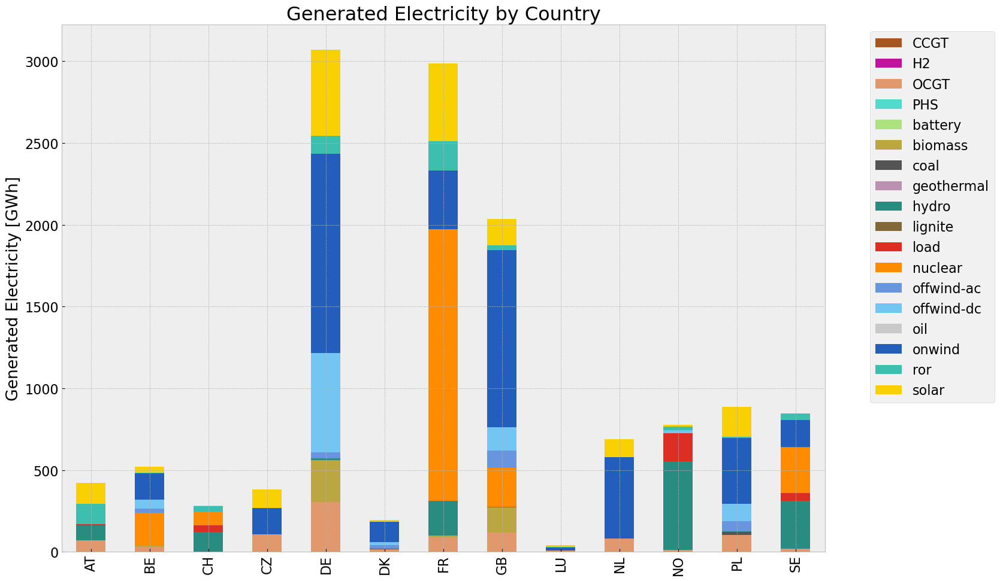

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\923320227.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\923320227.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\923320227.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\923320227.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Users\

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,9.500121e+05,0.451621,0.1980,416505.122590
biomass,4.344893e+05,0.468000,0.0000,0.000000
coal,1.624860e+04,0.329908,0.3361,16553.567012
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,9.482131e+02,0.337285,0.4069,1143.923408
load,2.645563e+05,1.000000,0.0000,0.000000
nuclear,2.463952e+06,0.326600,0.0000,0.000000
offwind-ac,2.625467e+05,1.000000,0.0000,0.000000


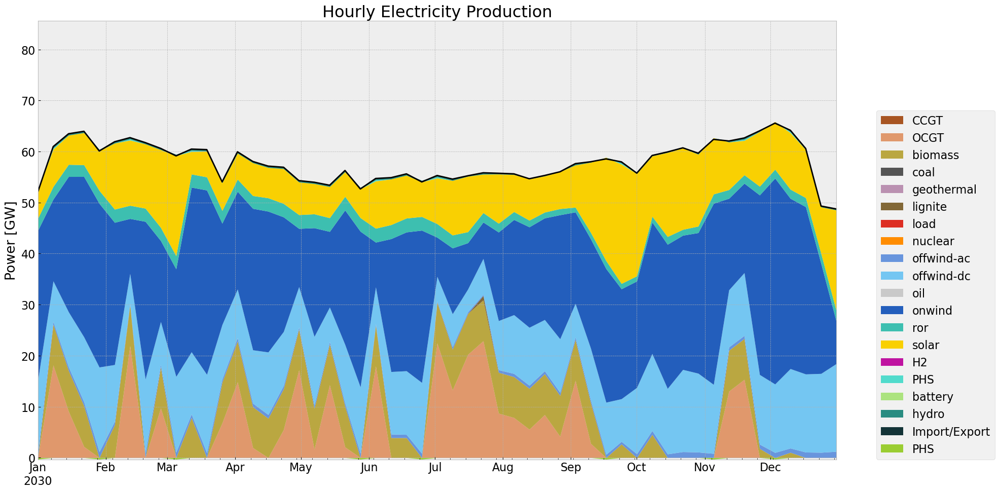

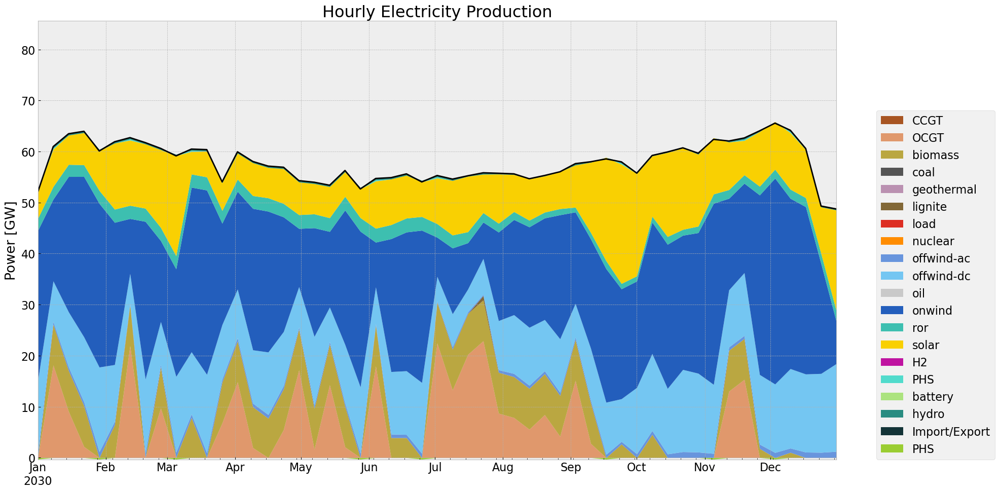

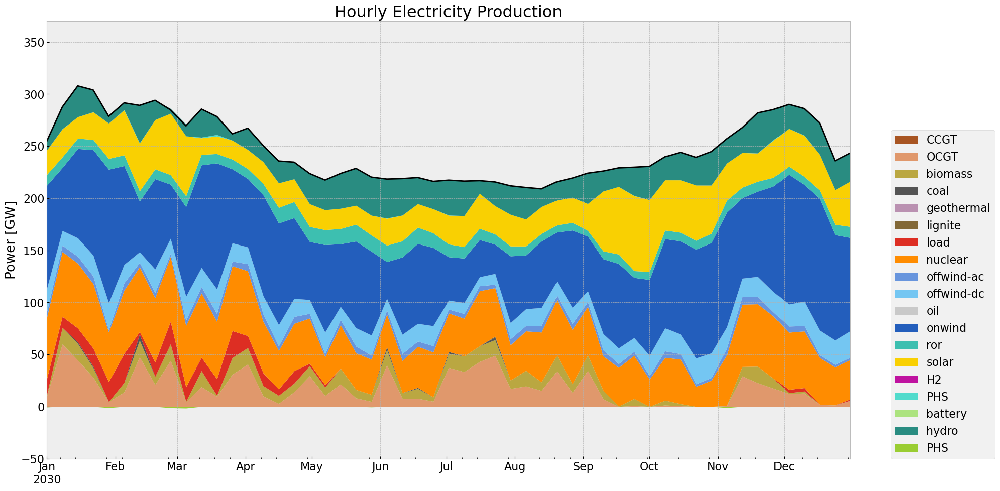

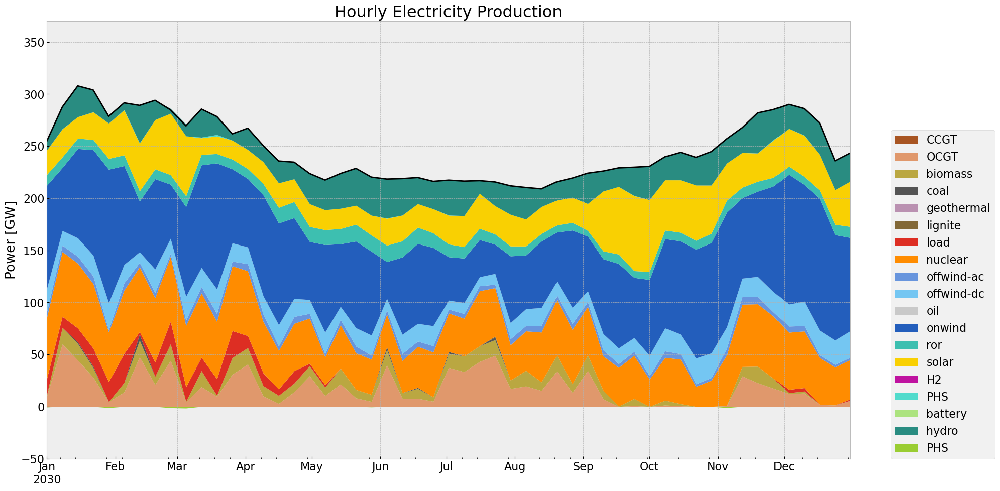

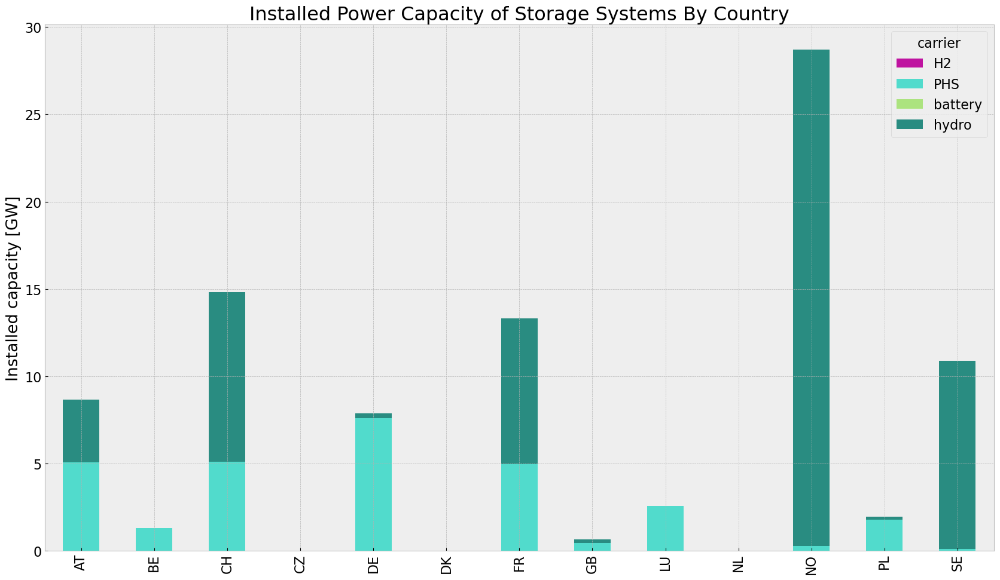

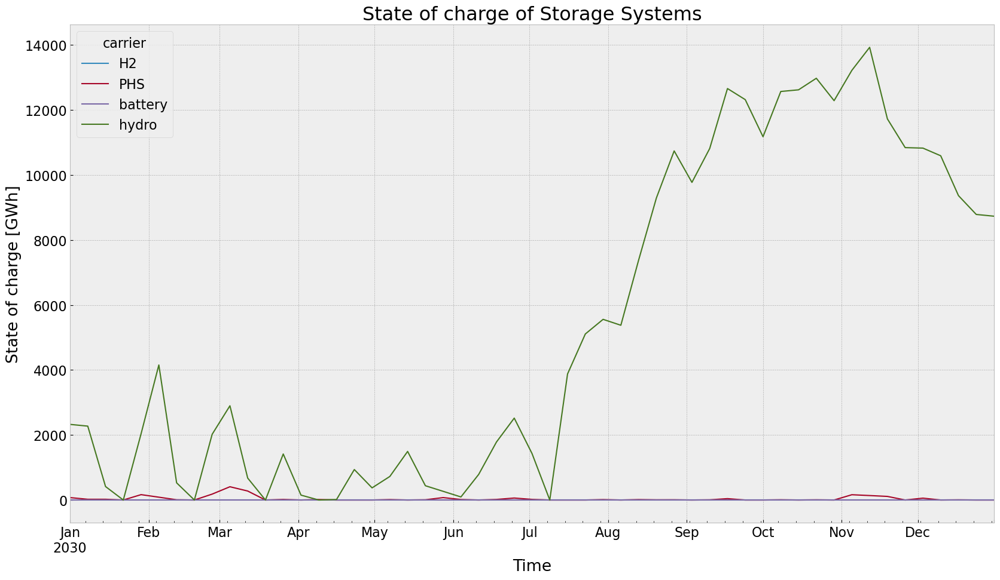

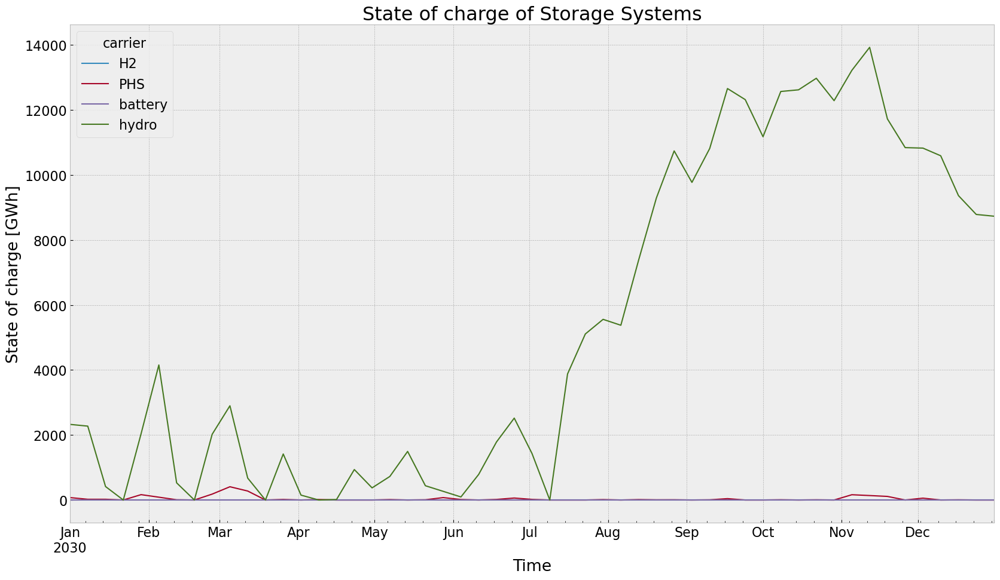

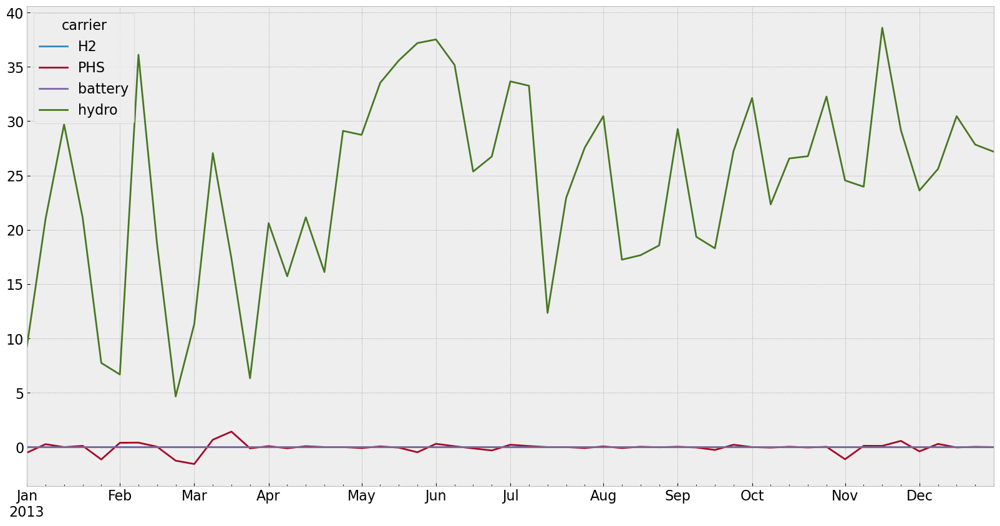

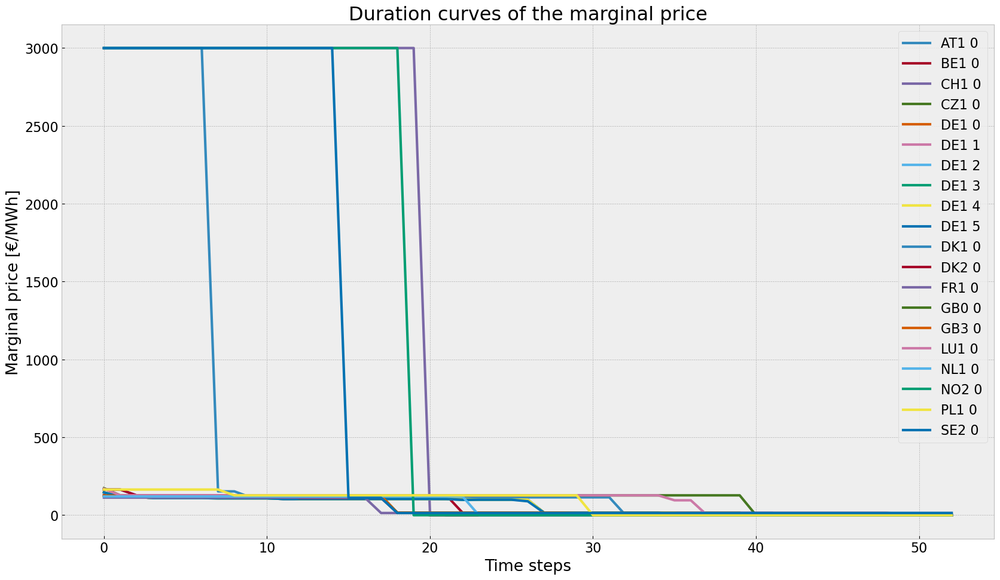

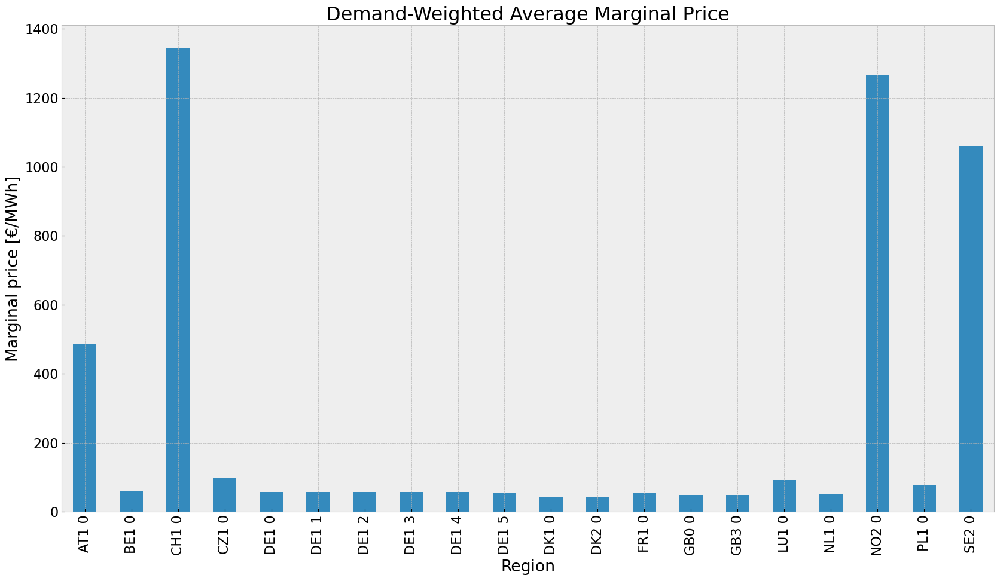

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


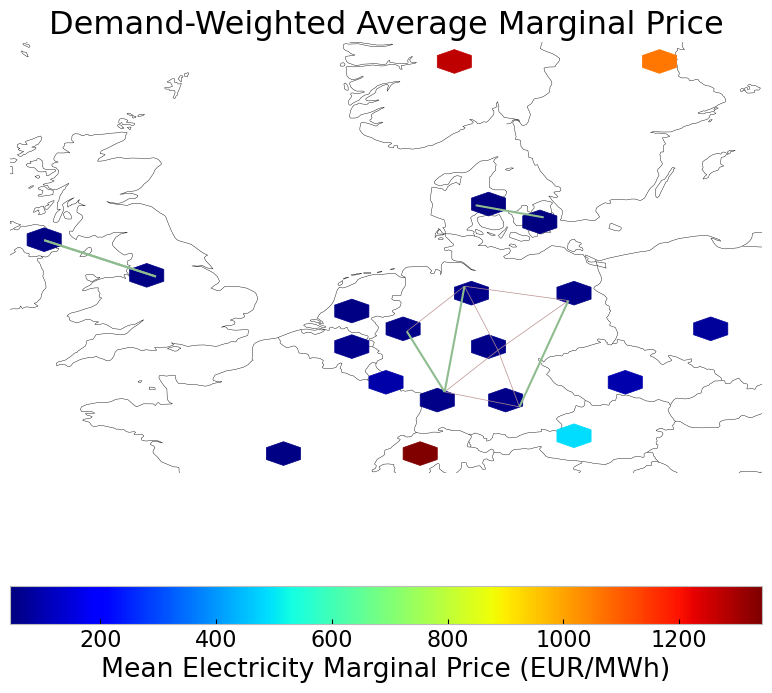

In [87]:

#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv_roll = inst_cap_table(n4, color_cap)
cap_inv_roll_country = inst_cap_table_country(n4, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_inv_roll  = gen_power_table(n4)
gen_inv_roll_country = gen_power_table_country(n4)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n4, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n4, '2030-01-01', '2030-12-31', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n4, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n4, '2030-01-01', '2030-12-31', colors_gen)

#installed storage unit & stores
store_inv_roll = inst_store_table(n4)

#State of Charge Storage unit
state_of_charge_plot(n4, '2030-01-01 00:00', '2030-12-31 21:00')
state_of_charge_plot(n4, '2030-01-01 00:00', '2030-12-31 21:00')
n4.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n4)

#avg electricity price
price_regions_table(n4)
price_regions(n4)

#Emission
em_inv_roll =em_table(n4)
em_inv_roll

In [88]:
#e_balance = n3.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :]
#e_balance.head()
#e_balance.to_csv('energy_balance_DE_offwind.csv', sep=',', index=True, header=True, encoding='utf-8')

# Scenario Analysis

## Installed Capacity

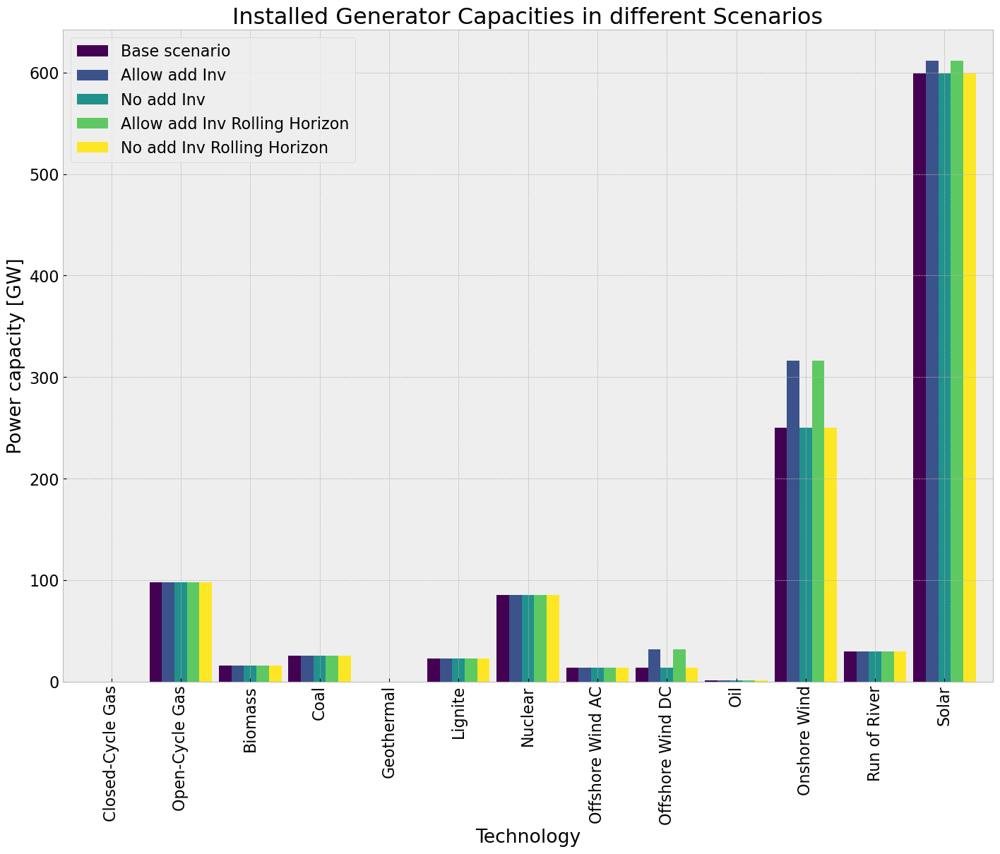

In [89]:
comp_inst_cap = pd.DataFrame(index=capacities_base.unstack().drop(columns=['load'],inplace=False).columns)

comp_inst_cap["Base scenario"] = capacities_base.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv"] = capacities_inv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv"] = capacities_noinv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv Rolling Horizon"] = capacities_inv_roll.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv Rolling Horizon"] = capacities_noinv_roll.groupby("carrier").sum().div(1e3).drop(index="load")

comp_inst_cap.rename(index = {"coal": "Coal"}, inplace=True)
comp_inst_cap.rename(index = {"OCGT": "Open-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"CCGT": "Closed-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"ror": "Run of River"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-ac": "Offshore Wind AC"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-dc": "Offshore Wind DC"}, inplace=True)
comp_inst_cap.rename(index = {"onwind": "Onshore Wind"}, inplace=True)
comp_inst_cap.rename(index = {"solar": "Solar"}, inplace=True)
comp_inst_cap.rename(index = {"oil": "Oil"}, inplace=True)
comp_inst_cap.rename(index = {"geothermal": "Geothermal"}, inplace=True)
comp_inst_cap.rename(index = {"nuclear": "Nuclear"}, inplace=True)
comp_inst_cap.rename(index = {"biomass": "Biomass"}, inplace=True)
comp_inst_cap.rename(index = {"lignite": "Lignite"}, inplace=True)

comp_inst_cap.fillna(0, inplace=True)

comp_inst_cap.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_cap.columns))),
                        grid=True,
                        xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Generator Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.show()

### Analysis of extendable Generators

Extendable Generators: OCGT, Offshore Wind AC and DC, Onshore Wind, Solar

{'AC': '#70af1d', 'DC': '#8a1caf', 'OCGT': '#e0986c', 'lignite': '#826837', 'nuclear': '#ff8c00', 'oil': '#c9c9c9', 'CCGT': '#a85522', 'biomass': '#baa741', 'onwind': '#235ebc', 'coal': '#545454', 'geothermal': '#ba91b1', 'offwind-dc': '#74c6f2', 'offwind-ac': '#6895dd', 'solar': '#f9d002', 'hydro': '#298c81', 'ror': '#3dbfb0', 'PHS': '#51dbcc', '': '', 'battery': '#ace37f', 'H2': '#bf13a0', 'load': '#dd2e23'}


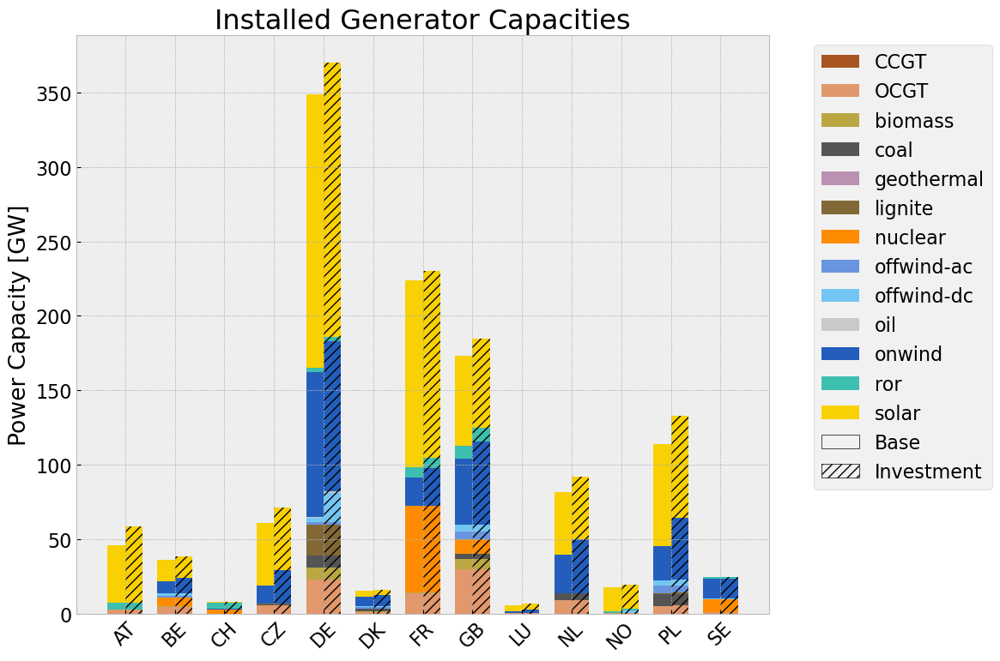

In [90]:
from matplotlib.patches import Patch

color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}
print(color_map)

base = cap_base_country
base.fillna(0, inplace=True)
inv = cap_inv_country
inv.fillna(0, inplace=True)

# Color mapping for generator types
color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(base.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, base, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, inv, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Generator Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_cap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)


plt.show()

## Power Generation

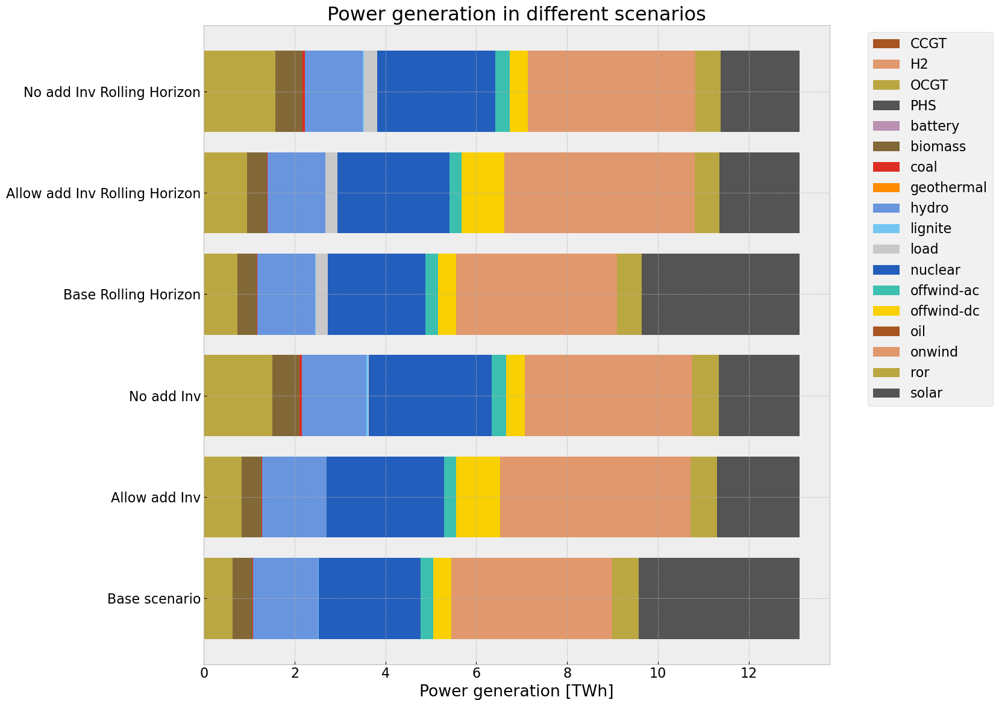

In [91]:
comp_gen_electr = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Rolling Horizon","Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = gen_base.columns.tolist())

comp_gen_electr.loc["Base scenario"] = gen_base.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv"] = gen_inv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv"] = gen_noinv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Base Rolling Horizon"] = gen_base_roll.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv Rolling Horizon"] = gen_inv_roll.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv Rolling Horizon"] = gen_noinv_roll.sum().div(1e3) # TWh/a



#comp_gen_electr.rename(columns = {"coal": "Coal"}, inplace=True)
#comp_gen_electr.rename(columns = {"gas": "Gas"}, inplace=True)
#comp_gen_electr.rename(columns = {"hydro": "Hydro"}, inplace=True)
#comp_gen_electr.rename(columns = {"offwind": "Offshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"onwind": "Onshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"solar": "Solar"}, inplace=True)
#comp_gen_electr.rename(columns = {"oil": "Oil"}, inplace=True)
#comp_gen_electr.rename(columns = {"geothermal": "Geothermal"}, inplace=True)
#comp_gen_electr.rename(columns = {"nuclear": "Nuclear"}, inplace=True)

#define color dict for tech
color_dict = {}

for index, row in n.carriers.iterrows():
    key = index
    value = row['color']
    color_dict[key] = value

#color list
colors = [color_dict[cat] for cat in gen_base.columns]

comp_gen_electr.fillna(0, inplace=True)
comp_gen_electr.plot.barh(figsize=(17,12),
                        color=colors_gen_table,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Power generation [TWh]",
                        title=f"Power generation in different scenarios",
                        #xlim=[0,200],
                        width=0.8
)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_generation.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Installed Storage Capacities

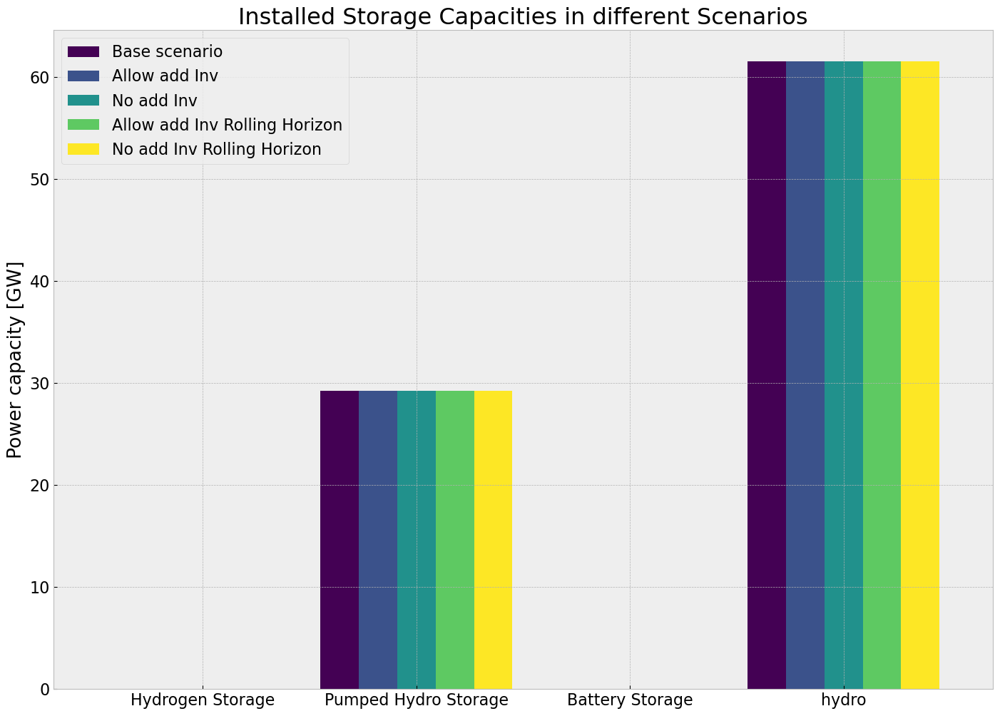

In [92]:
comp_inst_store = pd.DataFrame(index=store_base.unstack().columns)
comp_inst_store.index.name = ''

comp_inst_store["Base scenario"] = store_base.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv.groupby("carrier").sum()
comp_inst_store["No add Inv"] = store_noinv.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["Allow add Inv Rolling Horizon"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["No add Inv Rolling Horizon"] = store_noinv_roll.groupby("carrier").sum()

comp_inst_store.rename(index = {"battery": "Battery Storage"}, inplace=True)
comp_inst_store.rename(index = {"H2": "Hydrogen Storage"}, inplace=True)
comp_inst_store.rename(index = {"Hydro": "Reservoir & Dam"}, inplace=True)
comp_inst_store.rename(index = {"PHS": "Pumped Hydro Storage"}, inplace=True)


comp_inst_store.fillna(0, inplace=True)

comp_inst_store.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_store.columns))),
                        grid=True,
                        #xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Storage Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.xticks(rotation=360, ha='center')
fig.tight_layout()
# Save plot to the current working directory
filename = "analysis_installed_cap.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

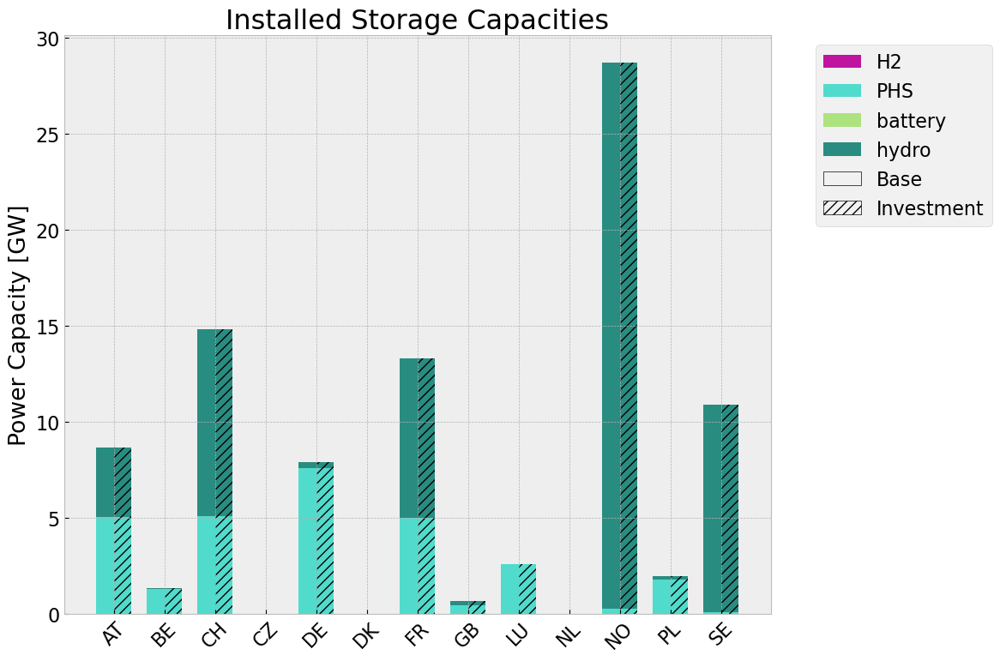

In [93]:
store_base_df = store_base.unstack()
store_inv_df = store_inv.unstack()

store_base_df.fillna(0, inplace=True)
store_inv_df.fillna(0, inplace=True)

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(store_base_df.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, store_base_df, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, store_inv_df, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Storage Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_storagecap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()


## System Cost

In [94]:
tech_comp = system_cost_base.index.tolist()
comp_system_cost = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Rolling Horizon", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_cost.loc["Base scenario"] = system_cost_base # Million €/a
comp_system_cost.loc["Allow add Inv"] = system_cost_inv # Million €/a
#if tot_cost_0_PV > 0: 
#    comp_system_cost.loc["0% PV potential"] = system_cost_0_PV # Million €/a
#else: comp_system_cost.loc["0% PV potential"] = 0.0
#if tot_cost_20_PV > 0: 
#    comp_system_cost.loc["20% PV potential"] = system_cost_20_PV # Million €/a
#else: comp_system_cost.loc["20% PV potential"] = 0.0
comp_system_cost.loc["No add Inv"] = system_cost_noinv # Million €/a
comp_system_cost.loc["Base Rolling Horizon"] = system_cost_base_roll # Million €/a
comp_system_cost.loc["Allow add Inv Rolling Horizon"] = system_cost_inv_roll
comp_system_cost.loc["No add Inv Rolling Horizon"] = system_cost_noinv_roll # Million €/a

#if 'AC' in system_cost_base:
#   comp_system_cost.AC = comp_system_cost.AC-system_cost_base.AC # expenditure for already existing transmission lines

#comp_system_cost[comp_system_cost<0] = 0 # since we subtact the AC cost (for the 0% or 20%) 
comp_system_cost.drop('-', axis=1, inplace=True)
#comp_system_cost.iloc[0,0] = system_cost_base.AC


#comp_system_cost = comp_system_cost   #Million eur0/

#comp_system_cost.rename(columns = {"battery storage": "Battery storage"}, inplace=True)
#comp_system_cost.rename(columns = {"hydrogen storage underground": "Hydrogen storage underground"}, inplace=True)

comp_system_cost.fillna(0, inplace=True)
comp_system_cost = comp_system_cost.div(1e3) # Billion €

#move load shedding to the last col
# Specify the column name to move
column_to_move = 'Load shedding'

# Create a new list of column names without the column to move
new_columns = [col for col in comp_system_cost.columns if col != column_to_move]

# Append the column to move to the end
new_columns.append(column_to_move)

# Reorder the columns
comp_system_cost = comp_system_cost[new_columns]


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\3411115089.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\3411115089.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


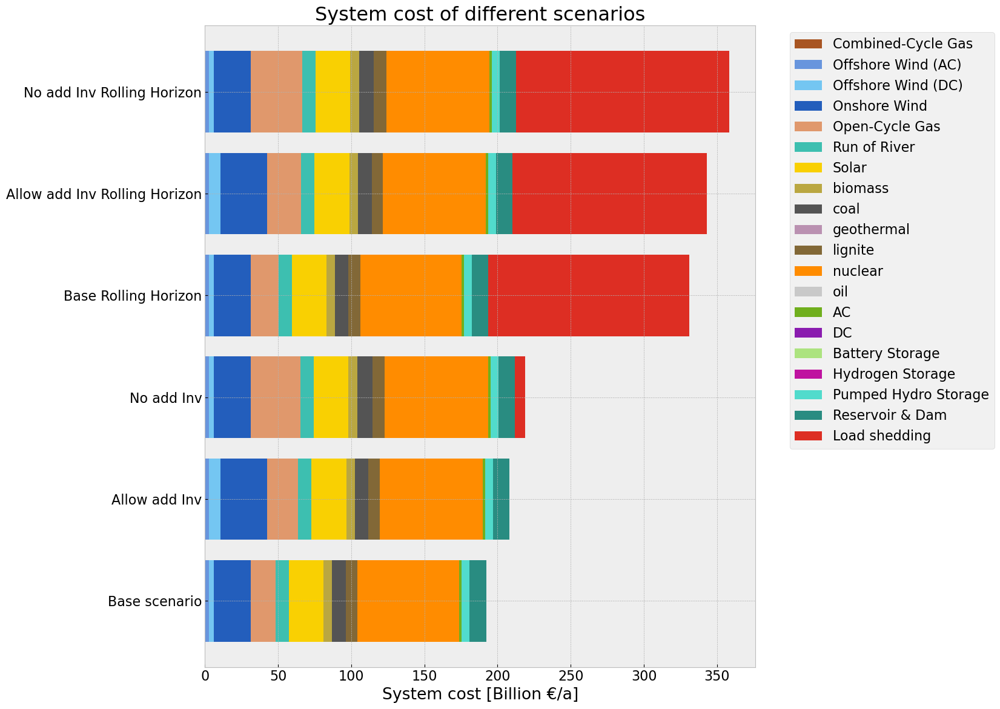

In [95]:
colors_comp = []

for i in range(len(comp_system_cost.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_cost.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="System cost [Billion €/a]",
                        title=f"System cost of different scenarios",
                        #xlim=[0,100],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_system_cost.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

In [96]:
comp_system_cost

,Combined-Cycle Gas,Offshore Wind (AC),Offshore Wind (DC),Onshore Wind,Open-Cycle Gas,Run of River,Solar,biomass,coal,geothermal,lignite,nuclear,oil,AC,DC,Battery Storage,Hydrogen Storage,Pumped Hydro Storage,Reservoir & Dam,Load shedding
Base scenario,0.0,2.840414,3.137813,25.409983,17.102586,9.107393,23.558445,5.837968,9.292896,0.0,8.035015,69.542986,0.063705,1.565854,0.107982,0.0,0.0,5.339881,11.243094,0.0
Allow add Inv,0.0,2.840375,7.698855,32.134417,20.894598,9.107393,24.041768,5.851852,9.203867,0.0,7.723268,70.331199,0.052908,1.605157,0.107951,0.0,0.0,5.339886,11.243094,0.0
No add Inv,0.0,2.840591,3.137824,25.410624,33.948778,9.107393,23.552551,6.295843,10.108999,0.0,8.436303,70.636739,0.063705,1.565854,0.10798,0.0,0.0,5.339876,11.243094,7.021906
Base Rolling Horizon,0.0,2.840416,3.137811,25.40998,18.899465,9.107332,23.558229,5.842122,9.298435,0.0,8.035015,69.311834,0.063705,1.565854,0.107982,0.0,0.0,5.339872,11.242794,137.279543
Allow add Inv Rolling Horizon,0.0,2.840376,7.698735,32.134406,23.125537,9.107335,24.041592,5.856358,9.20624,0.0,7.728607,70.066902,0.052908,1.605157,0.107951,0.0,0.0,5.339868,11.242823,132.788081
No add Inv Rolling Horizon,0.0,2.84059,3.137824,25.410614,35.084367,9.107335,23.552417,6.297241,10.117521,0.0,8.447713,70.378303,0.074503,1.565854,0.10798,0.0,0.0,5.339866,11.242821,145.575363


## Curtailment

In [97]:
comp_curtailment = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Rolling Horizon","Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = stat_base.loc["Generator"].index)

comp_curtailment.loc["Base scenario"] = stat_base.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv"] = stat_inv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv"] = stat_noinv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Base Rolling Horizon"] = stat_base_roll.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv Rolling Horizon"] = stat_inv_roll.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv Rolling Horizon"] = stat_noinv_roll.loc["Generator"].Curtailment.div(1e6) # TWh

comp_curtailment.fillna(0, inplace=True)

In [98]:
color_curtailment=[]

for i in range(len(comp_curtailment.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
            color_curtailment.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found 

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\3109801822.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\3109801822.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_curtailment.append(n.carriers.color[j])


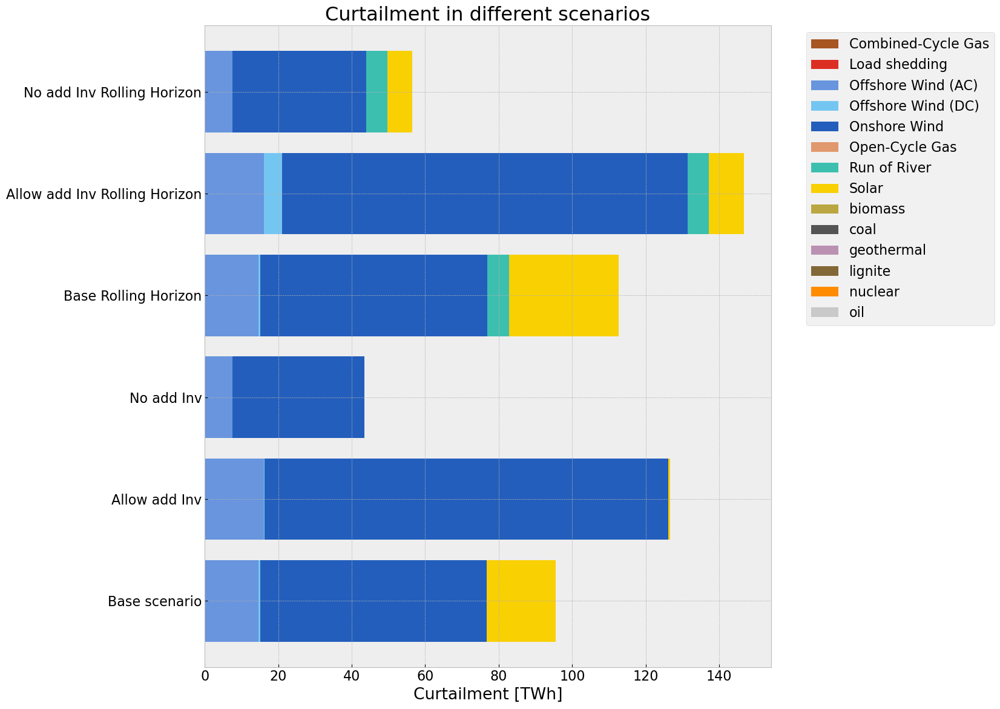

In [99]:
comp_curtailment.plot.barh(figsize=(17,12),
                        color=color_curtailment,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Curtailment [TWh]",
                        title=f"Curtailment in different scenarios",
                        #xlim=[0,120],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_curtailment.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

## Emission

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_13772\3480178836.py:21: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


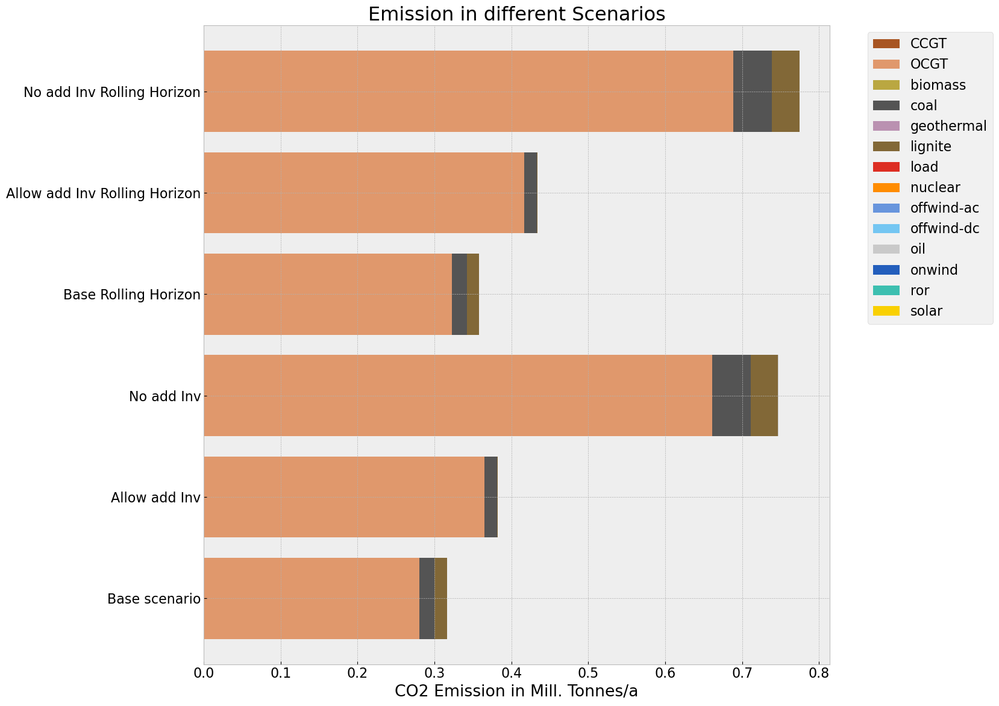

In [100]:
tech_comp = em_base.index.tolist()
comp_system_em = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Rolling Horizon","Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_em.loc["Base scenario"] = em_base['emissions in Tonnes CO2']/1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv"] = em_inv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Base Rolling Horizon"] = em_base_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv"] = em_noinv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv Rolling Horizon"] = em_inv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv Rolling Horizon"] = em_noinv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a

comp_system_em.fillna(0, inplace=True)

colors_comp = []

for i in range(len(comp_system_em.columns)):
    for j in range(len(n.carriers.index)):
        if comp_system_em.columns[i] == n.carriers.index[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_em.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="CO2 Emission in Mill. Tonnes/a",
                        title=f"Emission in different Scenarios",
                        #xlim=[0,100],
                        width=0.8
)
#global_constraint
#plt.axvline(x=n.global_constraints.loc['CO2Limit','constant']/1e6, color='r', linestyle='-', linewidth=2, label='CO2 cap')
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_emission.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

## Transmission Lines

In [101]:
models = [n, n1, n2, n4]

In [102]:
model_trans = [n,n1]
for m in model_trans:
    #create empty df
    trans_df = {
        'Country' : cap_base_country.index,
        'AC': np.zeros(len(cap_base_country.index)),
        'DC': np.zeros(len(cap_base_country.index))
    }

    trans_df = pd.DataFrame(trans_df)
    trans_df.set_index('Country', inplace=True)
    
    #AC
    ac_df = m.lines
    ac_df['country'] = ac_df['bus0'].str[:2]
    ac_df = ac_df.groupby(['country', 'carrier']).s_nom_opt.sum()
    ac_df.fillna(0, inplace=True)
    ac_df = ac_df.unstack().div(1e3) #GVA
            
    #DC
    dc_df = m.links
    dc_df['country'] = dc_df['bus0'].str[:2]
    dc_df = dc_df.groupby(['country', 'carrier']).p_nom_opt.sum()
    dc_df.fillna(0, inplace=True)
    dc_df = dc_df.unstack().div(1e3) #GW

    #fill empty df with AC Cap
    for index, row in trans_df.iterrows():
        if index in ac_df.index:
            try:
                trans_df.loc[index, 'AC'] = ac_df.loc[index, 'AC']
            except KeyError: 
                trans_df.loc[index, 'AC'] = 0

    #fill empty df with DC Cap
    for index, row in trans_df.iterrows():
        if index in dc_df.index:
            try:
                trans_df.loc[index, 'DC'] = dc_df.loc[index, 'DC']
            except KeyError: 
                trans_df.loc[index, 'DC'] = 0


    #trans_df = pd.concat([ac_df, dc_df], axis=1)
    #trans_df.fillna(0, inplace=True)
    globals()[f'trans_{m.name}'] = trans_df

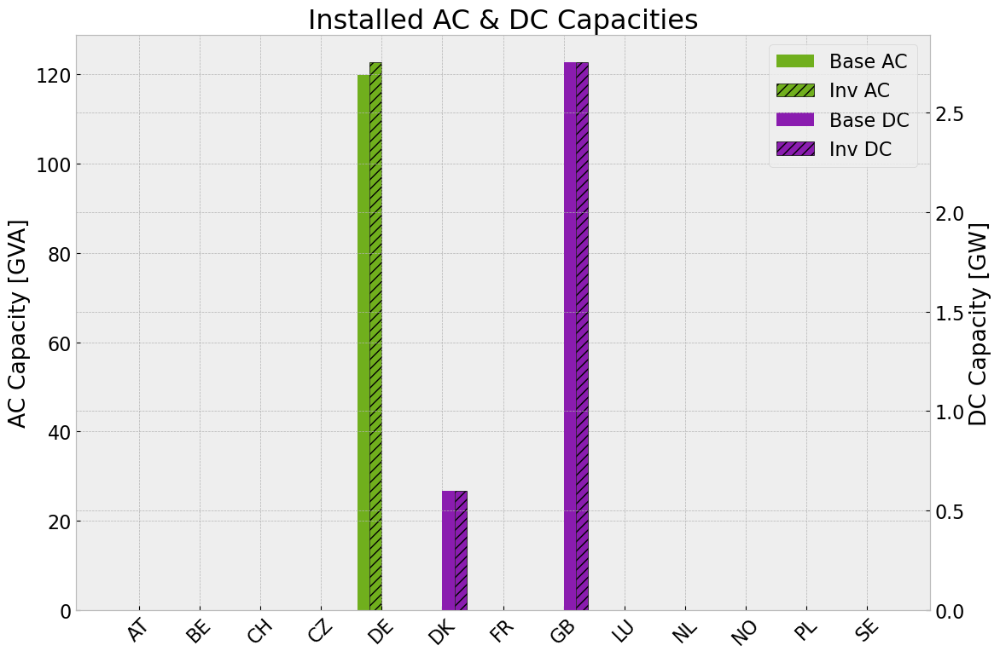

In [103]:
# Setting up bar plot parameters
bar_width = 0.2
indices = np.arange(len(trans_base_pv.index))
base_ac_indices = indices - bar_width * 1.5  # Shift slightly to the left
inv_ac_indices = indices - bar_width * 0.5  # Shift slightly to the right
base_dc_indices = indices + bar_width * 0.5
inv_dc_indices = indices + bar_width * 1.5

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Create secondary axis
ax2 = ax.twinx()

# Plot the base DataFrame (no hatching)
ax.bar(base_ac_indices, trans_base_pv.AC, bar_width, color = n.carriers.loc['AC','color'], label='Base AC')
ax2.bar(base_dc_indices, trans_base_pv.DC, bar_width, color = n.carriers.loc['DC','color'], label='Base DC')

# Plot the inv DataFrame (with hatching)
ax.bar(inv_ac_indices, trans_inv_pv.AC, bar_width, label='Inv AC', edgecolor = 'black', color = n.carriers.loc['AC','color'], hatch='///')
ax2.bar(inv_dc_indices, trans_inv_pv.DC, bar_width, label='Inv DC', edgecolor = 'black', color = n.carriers.loc['DC','color'], hatch='///')


# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + ax2.get_legend_handles_labels()[0]

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(0.8, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed AC & DC Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(trans_base_pv.index, rotation=45)
ax.set_ylabel('AC Capacity [GVA]')
ax2.set_ylabel('DC Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_trans_cap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

In [104]:
for index, row in n.links.iterrows():
    pnomoptn = n.links.at[index,'p_nom_opt']
    pnomoptn1 = n1.links.at[index,'p_nom_opt']
    bus0 = row['bus0']
    bus1 = row['bus1']
    if 'DE' in bus0 or 'DE' in bus1:
        print(f'{bus0},{bus1}: {index}, p_nom_opt: {pnomoptn}, {pnomoptn1}')

DE1 4,DE1 2: T10, p_nom_opt: 0.0, 0.0
DE1 5,DE1 3: T18, p_nom_opt: 0.0, 0.0
DE1 1,DE1 3: T20, p_nom_opt: 0.0, 0.0


In [105]:
n1.links

,bus0,bus1,carrier,geometry,length,p_nom,tags,under_construction,underground,p_min_pu,underwater_fraction,capital_cost,p_nom_max,build_year,marginal_cost,min_up_time,min_down_time,up_time_before,down_time_before,p_nom_opt,reversed,type,efficiency,lifetime,p_nom_mod,p_nom_extendable,p_nom_min,p_set,p_max_pu,marginal_cost_quadratic,stand_by_cost,terrain_factor,committable,start_up_cost,shut_down_cost,ramp_limit_up,ramp_limit_down,ramp_limit_start_up,ramp_limit_shut_down,country
Link,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
14805,DK2 0,DK1 0,DC,"LINESTRING(11.2853515176222 55.5308076825323,1...",205.403041,600.0,,False,True,-1.0,0.134963,25433.548360,30600.0,0,0.010393,0,0,1,0,600.0,False,,1.0,inf,0.0,True,600.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,DK
5581,GB0 0,GB3 0,DC,"LINESTRING(-4.94702447012386 55.0727948492206,...",383.992956,2501.0,"""MW""=>""None"", ""TSO""=>""None"", ""oid""=>""32527"", ""...",False,False,-1.0,0.130063,33780.438307,32501.0,0,0.009572,0,0,1,0,2501.0,False,,1.0,inf,0.0,True,2501.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,GB
5580,GB0 0,GB3 0,DC,"LINESTRING(-4.94689333475508 55.0726735779237,...",383.992956,250.0,"""MW""=>""None"", ""TSO""=>""None"", ""oid""=>""32526"", ""...",False,False,-1.0,0.099807,33344.500478,30250.0,0,0.009454,0,0,1,0,250.0,False,,1.0,inf,0.0,True,250.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,GB
T10,DE1 4,DE1 2,DC,"LINESTRING (11.629014 52.252137, 12.091596 48....",566.199061,0.0,"""name""=>""HVDC SuedOstLink"", ""ref""=>""https://ty...",True,False,-1.0,0.000000,39595.540717,30000.0,0,0.010103,0,0,1,0,0.0,False,,1.0,inf,0.0,True,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,DE
T18,DE1 5,DE1 3,DC,"LINESTRING (9.373979 53.922479, 9.117193 49.14...",544.320009,0.0,"""name""=>""HVDC SuedLink"", ""ref""=>""https://tyndp...",True,False,-1.0,0.013530,38943.907491,30000.0,0,0.010439,0,0,1,0,0.0,False,,1.0,inf,0.0,True,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,DE
T20,DE1 1,DE1 3,DC,"LINESTRING (6.619451 51.272935, 8.458036 49.23...",333.524322,0.0,"""name""=>""HVDC Ultranet"", ""ref""=>""https://tyndp...",True,False,-1.0,0.000000,29794.710303,30000.0,0,0.009846,0,0,1,0,0.0,False,,1.0,inf,0.0,True,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,DE


# Sensitivity Analysis

In [106]:
sens_reductionto = [0.5, reductionto,0]

sens_duration = [
    int(duration-(0.5*duration)),
    duration,
    int(duration+(0.5*duration)) 
]

#### Create and Solve Models

In [109]:
def sanitize_variable_name(name):
    """
    Sanitize a string to be used as a valid Python variable name.

    Args:
    name (str): The name to sanitize.

    Returns:
    str: A sanitized name.
    """
    # Replace periods and hyphens with underscores
    return name.replace('.', '_').replace('-', '_')

In [110]:
# Assuming sens_reductionto and sens_duration are defined and iterable

for red in sens_reductionto:
    for dur in sens_duration:
        name = f'n_{red}_{dur}'

        # Skip iteration if both conditions are met
        if red == reductionto and dur == duration:
            continue

        # Sanitize the names to be valid Python variable names
        red_sanitized = sanitize_variable_name(str(red))
        dur_sanitized = sanitize_variable_name(str(dur))

        # Variable names for models
        inv_model_name = f'n_{red_sanitized}_{dur_sanitized}_inv'
        inv_roll_model_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll'
        noinv_model_name = f'n_{red_sanitized}_{dur_sanitized}_noinv'
        noinv_roll_model_name = f'n_{red_sanitized}_{dur_sanitized}_noinv_roll'

        # Create inv model with perfect foresight
        globals()[inv_model_name] = pvscenario(n, carriers_to_cut, dur, red)
        allow_inv(globals()[inv_model_name], n, country)
        globals()[inv_model_name].name = inv_model_name
        print(globals()[inv_model_name].name)

        # Solve and export
        filename = f'{globals()[inv_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[inv_model_name] = import_nc_file(directory, filename)
        else:
            globals()[inv_model_name].optimize(solver_name="gurobi")
            print(f'{globals()[inv_model_name].name}.nc does not exist in current wd')
            globals()[inv_model_name].export_to_netcdf(output_path)
        

        # Create inv model rolling horizon
        globals()[inv_roll_model_name] = globals()[inv_model_name].copy()
        no_inv(globals()[inv_roll_model_name], globals()[inv_model_name])
        globals()[inv_roll_model_name].storage_units['cyclic_state_of_charge'] = False
        globals()[inv_roll_model_name].storage_units['cyclic_state_of_charge_per_period'] = False
        globals()[inv_roll_model_name].name = inv_roll_model_name
        print(globals()[inv_roll_model_name].name)

        # Solve with rolling horizon and export model
        filename = f'{globals()[inv_roll_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[inv_roll_model_name] = import_nc_file(directory, filename)
        else:
            optimize.optimize_with_rolling_horizon(globals()[inv_roll_model_name], horizon=horizon, overlap=0, solver_name='gurobi')
            print(f'{globals()[inv_roll_model_name].name}.nc does not exist in current wd')
            globals()[inv_roll_model_name].export_to_netcdf(output_path)

        # Create noinv model perfect foresight
        globals()[noinv_model_name] = pvscenario(n, carriers_to_cut, dur, red)
        no_inv(globals()[noinv_model_name], n)
        globals()[noinv_model_name].name = noinv_model_name
        print(globals()[noinv_model_name].name)

        # Solve and export
        filename = f'{globals()[noinv_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[noinv_model_name] = import_nc_file(directory, filename)
        else:
            globals()[noinv_model_name].optimize(solver_name="gurobi")
            print(f'{globals()[noinv_model_name].name}.nc does not exist in current wd')
            globals()[noinv_model_name].export_to_netcdf(output_path)

        # Create noinv model rolling horizon
        globals()[noinv_roll_model_name] = globals()[noinv_model_name].copy()
        globals()[noinv_roll_model_name].storage_units['cyclic_state_of_charge'] = False
        globals()[noinv_roll_model_name].storage_units['cyclic_state_of_charge_per_period'] = False
        globals()[noinv_roll_model_name].name = noinv_roll_model_name
        print(globals()[noinv_roll_model_name].name)

        # Solve with rolling horizon and export model
        filename = f'{globals()[noinv_roll_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[noinv_roll_model_name] = import_nc_file(directory, filename)
        else:
            optimize.optimize_with_rolling_horizon(globals()[noinv_roll_model_name], horizon=horizon, overlap=0, solver_name='gurobi')
            print(f'{globals()[noinv_roll_model_name].name}.nc does not exist in current wd')
            globals()[noinv_roll_model_name].export_to_netcdf(output_path)

Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')


cut_start: 2013-06-04 00:00:00
n_0_5_90_inv


Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 101.69it/s]
INFO:linopy.io: Writing time: 0.86s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9h6e7bei.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9h6e7bei.lp


Reading time = 0.36 seconds


INFO:gurobipy:Reading time = 0.36 seconds


obj: 54704 rows, 25581 columns, 98944 nonzeros


INFO:gurobipy:obj: 54704 rows, 25581 columns, 98944 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 54704 rows, 25581 columns and 98944 nonzeros


INFO:gurobipy:Optimize a model with 54704 rows, 25581 columns and 98944 nonzeros


Model fingerprint: 0x2b208982


INFO:gurobipy:Model fingerprint: 0x2b208982


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 3e+02]


INFO:gurobipy:  Matrix range     [1e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 38130 rows and 6912 columns


INFO:gurobipy:Presolve removed 38130 rows and 6912 columns


Presolve time: 0.09s


INFO:gurobipy:Presolve time: 0.09s


Presolved: 16574 rows, 18669 columns, 54227 nonzeros


INFO:gurobipy:Presolved: 16574 rows, 18669 columns, 54227 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.05s


INFO:gurobipy:Ordering time: 0.05s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 54


INFO:gurobipy: Dense cols : 54


 AA' NZ     : 1.505e+05


INFO:gurobipy: AA' NZ     : 1.505e+05


 Factor NZ  : 5.351e+05 (roughly 20 MB of memory)


INFO:gurobipy: Factor NZ  : 5.351e+05 (roughly 20 MB of memory)


 Factor Ops : 3.742e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.742e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.78833255e+12 -7.40303109e+13  9.10e+05 1.85e+05  3.36e+10     0s


INFO:gurobipy:   0   5.78833255e+12 -7.40303109e+13  9.10e+05 1.85e+05  3.36e+10     0s


   1   5.26555541e+12 -3.63768480e+13  5.67e+05 4.92e+04  1.51e+10     0s


INFO:gurobipy:   1   5.26555541e+12 -3.63768480e+13  5.67e+05 4.92e+04  1.51e+10     0s


   2   3.35819670e+12 -2.40247945e+13  9.78e+04 1.37e+04  3.61e+09     0s


INFO:gurobipy:   2   3.35819670e+12 -2.40247945e+13  9.78e+04 1.37e+04  3.61e+09     0s


   3   2.61796179e+12 -8.59317835e+12  6.38e+03 1.03e+03  4.50e+08     0s


INFO:gurobipy:   3   2.61796179e+12 -8.59317835e+12  6.38e+03 1.03e+03  4.50e+08     0s


   4   1.40905340e+12 -2.10523501e+12  3.68e+02 2.04e+02  1.01e+08     0s


INFO:gurobipy:   4   1.40905340e+12 -2.10523501e+12  3.68e+02 2.04e+02  1.01e+08     0s


   5   7.99802436e+11 -1.54503485e+12  1.37e+02 1.50e+02  6.37e+07     0s


INFO:gurobipy:   5   7.99802436e+11 -1.54503485e+12  1.37e+02 1.50e+02  6.37e+07     0s


   6   5.47278075e+11 -8.47671201e+11  7.79e+01 8.47e+01  3.68e+07     0s


INFO:gurobipy:   6   5.47278075e+11 -8.47671201e+11  7.79e+01 8.47e+01  3.68e+07     0s


   7   2.76302240e+11 -3.82890599e+11  2.35e+01 3.83e+01  1.68e+07     0s


INFO:gurobipy:   7   2.76302240e+11 -3.82890599e+11  2.35e+01 3.83e+01  1.68e+07     0s


   8   1.56548789e+11 -1.43019369e+11  6.61e+00 1.75e+01  7.51e+06     0s


INFO:gurobipy:   8   1.56548789e+11 -1.43019369e+11  6.61e+00 1.75e+01  7.51e+06     0s


   9   1.26213048e+11 -3.96482865e+10  3.99e+00 8.75e+00  4.13e+06     0s


INFO:gurobipy:   9   1.26213048e+11 -3.96482865e+10  3.99e+00 8.75e+00  4.13e+06     0s


  10   9.77278519e+10  6.59930268e+09  1.86e+00 4.96e+00  2.26e+06     0s


INFO:gurobipy:  10   9.77278519e+10  6.59930268e+09  1.86e+00 4.96e+00  2.26e+06     0s


  11   8.48601680e+10  2.79355868e+10  1.03e+00 3.16e+00  1.41e+06     0s


INFO:gurobipy:  11   8.48601680e+10  2.79355868e+10  1.03e+00 3.16e+00  1.41e+06     0s


  12   7.85781527e+10  3.78827059e+10  6.56e-01 2.33e+00  1.00e+06     0s


INFO:gurobipy:  12   7.85781527e+10  3.78827059e+10  6.56e-01 2.33e+00  1.00e+06     0s


  13   7.52308567e+10  4.52664031e+10  4.60e-01 1.71e+00  7.39e+05     1s


INFO:gurobipy:  13   7.52308567e+10  4.52664031e+10  4.60e-01 1.71e+00  7.39e+05     1s


  14   7.16356538e+10  5.29271818e+10  2.50e-01 1.09e+00  4.61e+05     1s


INFO:gurobipy:  14   7.16356538e+10  5.29271818e+10  2.50e-01 1.09e+00  4.61e+05     1s


  15   6.90424645e+10  5.82189216e+10  1.23e-01 6.52e-01  2.67e+05     1s


INFO:gurobipy:  15   6.90424645e+10  5.82189216e+10  1.23e-01 6.52e-01  2.67e+05     1s


  16   6.77619443e+10  6.14690572e+10  6.65e-02 3.75e-01  1.55e+05     1s


INFO:gurobipy:  16   6.77619443e+10  6.14690572e+10  6.65e-02 3.75e-01  1.55e+05     1s


  17   6.70689987e+10  6.28701589e+10  3.84e-02 2.56e-01  1.03e+05     1s


INFO:gurobipy:  17   6.70689987e+10  6.28701589e+10  3.84e-02 2.56e-01  1.03e+05     1s


  18   6.65946624e+10  6.36615885e+10  2.02e-02 1.90e-01  7.22e+04     1s


INFO:gurobipy:  18   6.65946624e+10  6.36615885e+10  2.02e-02 1.90e-01  7.22e+04     1s


  19   6.63316755e+10  6.46784861e+10  1.08e-02 1.06e-01  4.07e+04     1s


INFO:gurobipy:  19   6.63316755e+10  6.46784861e+10  1.08e-02 1.06e-01  4.07e+04     1s


  20   6.61434253e+10  6.55669205e+10  4.24e-03 3.19e-02  1.42e+04     1s


INFO:gurobipy:  20   6.61434253e+10  6.55669205e+10  4.24e-03 3.19e-02  1.42e+04     1s


  21   6.60443634e+10  6.58017252e+10  1.64e-03 1.32e-02  5.97e+03     1s


INFO:gurobipy:  21   6.60443634e+10  6.58017252e+10  1.64e-03 1.32e-02  5.97e+03     1s


  22   6.60151156e+10  6.58236165e+10  9.20e-04 1.15e-02  4.71e+03     1s


INFO:gurobipy:  22   6.60151156e+10  6.58236165e+10  9.20e-04 1.15e-02  4.71e+03     1s


  23   6.59906456e+10  6.59039469e+10  3.62e-04 5.30e-03  2.13e+03     1s


INFO:gurobipy:  23   6.59906456e+10  6.59039469e+10  3.62e-04 5.30e-03  2.13e+03     1s


  24   6.59842939e+10  6.59360339e+10  2.20e-04 2.79e-03  1.19e+03     1s


INFO:gurobipy:  24   6.59842939e+10  6.59360339e+10  2.20e-04 2.79e-03  1.19e+03     1s


  25   6.59790190e+10  6.59567521e+10  1.12e-04 1.17e-03  5.48e+02     1s


INFO:gurobipy:  25   6.59790190e+10  6.59567521e+10  1.12e-04 1.17e-03  5.48e+02     1s


  26   6.59732599e+10  6.59699918e+10  5.82e-05 1.60e-04  8.04e+01     1s


INFO:gurobipy:  26   6.59732599e+10  6.59699918e+10  5.82e-05 1.60e-04  8.04e+01     1s


  27   6.59728308e+10  6.59717399e+10  2.16e-05 4.52e-05  2.68e+01     1s


INFO:gurobipy:  27   6.59728308e+10  6.59717399e+10  2.16e-05 4.52e-05  2.68e+01     1s


  28   6.59726391e+10  6.59723527e+10  1.99e-05 9.74e-06  7.04e+00     1s


INFO:gurobipy:  28   6.59726391e+10  6.59723527e+10  1.99e-05 9.74e-06  7.04e+00     1s


  29   6.59725659e+10  6.59724790e+10  2.17e-05 2.66e-06  2.14e+00     1s


INFO:gurobipy:  29   6.59725659e+10  6.59724790e+10  2.17e-05 2.66e-06  2.14e+00     1s


  30   6.59725372e+10  6.59725259e+10  5.20e-06 2.14e-07  2.78e-01     1s


INFO:gurobipy:  30   6.59725372e+10  6.59725259e+10  5.20e-06 2.14e-07  2.78e-01     1s


  31   6.59725317e+10  6.59725292e+10  3.16e-05 5.54e-08  6.04e-02     1s


INFO:gurobipy:  31   6.59725317e+10  6.59725292e+10  3.16e-05 5.54e-08  6.04e-02     1s


  32   6.59725307e+10  6.59725304e+10  6.50e-06 4.23e-09  7.55e-03     1s


INFO:gurobipy:  32   6.59725307e+10  6.59725304e+10  6.50e-06 4.23e-09  7.55e-03     1s


  33   6.59725305e+10  6.59725305e+10  3.13e-06 1.52e-10  2.62e-04     1s


INFO:gurobipy:  33   6.59725305e+10  6.59725305e+10  3.13e-06 1.52e-10  2.62e-04     1s


  34   6.59725305e+10  6.59725305e+10  8.03e-07 1.33e-10  8.65e-07     1s


INFO:gurobipy:  34   6.59725305e+10  6.59725305e+10  8.03e-07 1.33e-10  8.65e-07     1s


  35   6.59725305e+10  6.59725305e+10  1.29e-06 5.46e-10  1.16e-09     1s


INFO:gurobipy:  35   6.59725305e+10  6.59725305e+10  1.29e-06 5.46e-10  1.16e-09     1s


INFO:gurobipy:


Barrier solved model in 35 iterations and 1.06 seconds (0.45 work units)


INFO:gurobipy:Barrier solved model in 35 iterations and 1.06 seconds (0.45 work units)


Optimal objective 6.59725305e+10


INFO:gurobipy:Optimal objective 6.59725305e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    9447 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:    9447 DPushes remaining with DInf 0.0000000e+00                 1s


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Extra simplex iterations after uncrush: 7


INFO:gurobipy:Extra simplex iterations after uncrush: 7


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


   14570    6.5972530e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:   14570    6.5972530e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 14570 iterations and 1.16 seconds (0.43 work units)


INFO:gurobipy:Solved in 14570 iterations and 1.16 seconds (0.43 work units)


Optimal objective  6.597253046e+10


INFO:gurobipy:Optimal objective  6.597253046e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 25581 primals, 54704 duals
Objective: 6.60e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_5_90_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_90_inv.nc has lines, links, generators, carriers, loads, storage_units, buses
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).
Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')


n_0_5_90_inv_roll


Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ekgb32l4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ekgb32l4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0x53707473


INFO:gurobipy:Model fingerprint: 0x53707473


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3921 rows and 1179 columns


INFO:gurobipy:Presolve removed 3921 rows and 1179 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 191 rows, 741 columns, 1057 nonzeros


INFO:gurobipy:Presolved: 191 rows, 741 columns, 1057 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.6132029e+09   3.294349e+06   0.000000e+00      0s


INFO:gurobipy:       0    4.6132029e+09   3.294349e+06   0.000000e+00      0s


     200    3.5662752e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    3.5662752e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.07 seconds (0.00 work units)


Optimal objective  3.566275164e+10


INFO:gurobipy:Optimal objective  3.566275164e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 3.57e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', 'D

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lpliytku.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lpliytku.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0xab476cd8


INFO:gurobipy:Model fingerprint: 0xab476cd8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3924 rows and 1189 columns


INFO:gurobipy:Presolve removed 3924 rows and 1189 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 188 rows, 731 columns, 1041 nonzeros


INFO:gurobipy:Presolved: 188 rows, 731 columns, 1041 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.5191715e+09   3.116691e+06   0.000000e+00      0s


INFO:gurobipy:       0    8.5191715e+09   3.116691e+06   0.000000e+00      0s


Extra simplex iterations after uncrush: 2


INFO:gurobipy:Extra simplex iterations after uncrush: 2


     196    3.7261545e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     196    3.7261545e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 196 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 196 iterations and 0.05 seconds (0.00 work units)


Optimal objective  3.726154511e+10


INFO:gurobipy:Optimal objective  3.726154511e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 3.73e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', 'D

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u0zcs5r8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u0zcs5r8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0x7dd64eef


INFO:gurobipy:Model fingerprint: 0x7dd64eef


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3926 rows and 1203 columns


INFO:gurobipy:Presolve removed 3926 rows and 1203 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 186 rows, 717 columns, 1026 nonzeros


INFO:gurobipy:Presolved: 186 rows, 717 columns, 1026 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.6615192e+09   3.027364e+06   0.000000e+00      0s


INFO:gurobipy:       0    7.6615192e+09   3.027364e+06   0.000000e+00      0s


     182    3.4153834e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     182    3.4153834e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 182 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 182 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.415383416e+10


INFO:gurobipy:Optimal objective  3.415383416e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 3.42e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', 'D

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jf9m11v9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jf9m11v9.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0x41397ba4


INFO:gurobipy:Model fingerprint: 0x41397ba4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3933 rows and 1218 columns


INFO:gurobipy:Presolve removed 3933 rows and 1218 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 179 rows, 702 columns, 995 nonzeros


INFO:gurobipy:Presolved: 179 rows, 702 columns, 995 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.0680669e+09   2.450827e+06   0.000000e+00      0s


INFO:gurobipy:       0    9.0680669e+09   2.450827e+06   0.000000e+00      0s


     180    2.4517026e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     180    2.4517026e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 180 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 180 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.451702618e+10


INFO:gurobipy:Optimal objective  2.451702618e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 2.45e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', 'D

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pos5vmee.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pos5vmee.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0x2bc12219


INFO:gurobipy:Model fingerprint: 0x2bc12219


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3934 rows and 1216 columns


INFO:gurobipy:Presolve removed 3934 rows and 1216 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 178 rows, 704 columns, 1003 nonzeros


INFO:gurobipy:Presolved: 178 rows, 704 columns, 1003 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7940146e+09   2.752965e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.7940146e+09   2.752965e+06   0.000000e+00      0s


     172    7.6227635e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     172    7.6227635e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 172 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 172 iterations and 0.04 seconds (0.00 work units)


Optimal objective  7.622763474e+09


INFO:gurobipy:Optimal objective  7.622763474e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 7.62e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', 'D

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qdsoz3uv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qdsoz3uv.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0x32d726f6


INFO:gurobipy:Model fingerprint: 0x32d726f6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3939 rows and 1209 columns


INFO:gurobipy:Presolve removed 3939 rows and 1209 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 173 rows, 711 columns, 997 nonzeros


INFO:gurobipy:Presolved: 173 rows, 711 columns, 997 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3176744e+08   2.787257e+06   0.000000e+00      0s


INFO:gurobipy:       0    2.3176744e+08   2.787257e+06   0.000000e+00      0s


     160    9.0551086e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     160    9.0551086e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 160 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 160 iterations and 0.04 seconds (0.00 work units)


Optimal objective  9.055108594e+08


INFO:gurobipy:Optimal objective  9.055108594e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 9.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', 'D

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-whxwrlaa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-whxwrlaa.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0x58190880


INFO:gurobipy:Model fingerprint: 0x58190880


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3927 rows and 1185 columns


INFO:gurobipy:Presolve removed 3927 rows and 1185 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 185 rows, 735 columns, 1046 nonzeros


INFO:gurobipy:Presolved: 185 rows, 735 columns, 1046 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1172817e+08   2.825962e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.1172817e+08   2.825962e+06   0.000000e+00      0s


     177    1.4010288e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     177    1.4010288e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 177 iterations and 0.11 seconds (0.00 work units)


INFO:gurobipy:Solved in 177 iterations and 0.11 seconds (0.00 work units)


Optimal objective  1.401028787e+09


INFO:gurobipy:Optimal objective  1.401028787e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 1.40e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', 'D

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-83juxj95.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-83juxj95.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0x89eba8fc


INFO:gurobipy:Model fingerprint: 0x89eba8fc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3929 rows and 1193 columns


INFO:gurobipy:Presolve removed 3929 rows and 1193 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 183 rows, 727 columns, 1031 nonzeros


INFO:gurobipy:Presolved: 183 rows, 727 columns, 1031 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2537696e+08   2.587664e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.2537696e+08   2.587664e+06   0.000000e+00      0s


     187    2.0353200e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    2.0353200e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.035319969e+09


INFO:gurobipy:Optimal objective  2.035319969e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 2.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', 'D

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dif0k3ae.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dif0k3ae.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0x3c4527b3


INFO:gurobipy:Model fingerprint: 0x3c4527b3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3929 rows and 1206 columns


INFO:gurobipy:Presolve removed 3929 rows and 1206 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 183 rows, 714 columns, 1018 nonzeros


INFO:gurobipy:Presolved: 183 rows, 714 columns, 1018 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7965877e+08   2.560968e+06   0.000000e+00      0s


INFO:gurobipy:       0    2.7965877e+08   2.560968e+06   0.000000e+00      0s


     181    1.4716632e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     181    1.4716632e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 181 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 181 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.471663229e+09


INFO:gurobipy:Optimal objective  1.471663229e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 1.47e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', '

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-asnpkh3l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-asnpkh3l.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0xcf994638


INFO:gurobipy:Model fingerprint: 0xcf994638


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3930 rows and 1208 columns


INFO:gurobipy:Presolve removed 3930 rows and 1208 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 182 rows, 712 columns, 1016 nonzeros


INFO:gurobipy:Presolved: 182 rows, 712 columns, 1016 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3670237e+08   2.683604e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.3670237e+08   2.683604e+06   0.000000e+00      0s


     185    7.5743994e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     185    7.5743994e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 185 iterations and 0.08 seconds (0.00 work units)


INFO:gurobipy:Solved in 185 iterations and 0.08 seconds (0.00 work units)


Optimal objective  7.574399372e+08


INFO:gurobipy:Optimal objective  7.574399372e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 7.57e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', '

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6nd88035.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6nd88035.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0x0e7813fe


INFO:gurobipy:Model fingerprint: 0x0e7813fe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3933 rows and 1218 columns


INFO:gurobipy:Presolve removed 3933 rows and 1218 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 179 rows, 702 columns, 1004 nonzeros


INFO:gurobipy:Presolved: 179 rows, 702 columns, 1004 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6128644e+08   2.661447e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.6128644e+08   2.661447e+06   0.000000e+00      0s


     179    6.1568212e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     179    6.1568212e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 179 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 179 iterations and 0.04 seconds (0.00 work units)


Optimal objective  6.156821160e+08


INFO:gurobipy:Optimal objective  6.156821160e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 6.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', '

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-18kxn2fc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-18kxn2fc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0xc4ed520f


INFO:gurobipy:Model fingerprint: 0xc4ed520f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3929 rows and 1202 columns


INFO:gurobipy:Presolve removed 3929 rows and 1202 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 183 rows, 718 columns, 1022 nonzeros


INFO:gurobipy:Presolved: 183 rows, 718 columns, 1022 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6467438e+08   2.988866e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.6467438e+08   2.988866e+06   0.000000e+00      0s


     192    3.1456855e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     192    3.1456855e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 192 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 192 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.145685501e+09


INFO:gurobipy:Optimal objective  3.145685501e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 3.15e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', '

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sqrm6q45.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sqrm6q45.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0x8729b8d8


INFO:gurobipy:Model fingerprint: 0x8729b8d8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3935 rows and 1228 columns


INFO:gurobipy:Presolve removed 3935 rows and 1228 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 177 rows, 692 columns, 993 nonzeros


INFO:gurobipy:Presolved: 177 rows, 692 columns, 993 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.0435220e+07   2.867297e+06   0.000000e+00      0s


INFO:gurobipy:       0    6.0435220e+07   2.867297e+06   0.000000e+00      0s


     178    5.2519936e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     178    5.2519936e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 178 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 178 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.251993636e+09


INFO:gurobipy:Optimal objective  5.251993636e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 5.25e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
Index(['BE1 0 offwind-ac', 'DE1 3 solar', 'PL1 0 offwind-ac',
       'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['BE1 0 offwind-ac', '

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-11juo167.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-11juo167.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 1028 rows, 480 columns, 1564 nonzeros


INFO:gurobipy:obj: 1028 rows, 480 columns, 1564 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1028 rows, 480 columns and 1564 nonzeros


INFO:gurobipy:Optimize a model with 1028 rows, 480 columns and 1564 nonzeros


Model fingerprint: 0x7d6b5f3b


INFO:gurobipy:Model fingerprint: 0x7d6b5f3b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 5e+01]


INFO:gurobipy:  Matrix range     [1e+00, 5e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 995 rows and 345 columns


INFO:gurobipy:Presolve removed 995 rows and 345 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 33 rows, 135 columns, 183 nonzeros


INFO:gurobipy:Presolved: 33 rows, 135 columns, 183 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1403164e+07   1.282251e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1403164e+07   1.282251e+05   0.000000e+00      0s


      32    1.2508303e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      32    1.2508303e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 32 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 32 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.250830251e+08


INFO:gurobipy:Optimal objective  1.250830251e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 480 primals, 1028 duals
Objective: 1.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_90_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_90_inv_roll.nc has lines, links, generators, carriers, loads, storage_units, buses


cut_start: 2013-06-04 00:00:00
n_0_5_90_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 61.95it/s]
INFO:linopy.io: Writing time: 0.68s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2wjql3mn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2wjql3mn.lp


Reading time = 0.17 seconds


INFO:gurobipy:Reading time = 0.17 seconds


obj: 54484 rows, 25440 columns, 86337 nonzeros


INFO:gurobipy:obj: 54484 rows, 25440 columns, 86337 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 54484 rows, 25440 columns and 86337 nonzeros


INFO:gurobipy:Optimize a model with 54484 rows, 25440 columns and 86337 nonzeros


Model fingerprint: 0xe6730e68


INFO:gurobipy:Model fingerprint: 0xe6730e68


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 51957 rows and 15278 columns


INFO:gurobipy:Presolve removed 51957 rows and 15278 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 2527 rows, 10162 columns, 14717 nonzeros


INFO:gurobipy:Presolved: 2527 rows, 10162 columns, 14717 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.813e+03


INFO:gurobipy: AA' NZ     : 3.813e+03


 Factor NZ  : 3.039e+04 (roughly 5 MB of memory)


INFO:gurobipy: Factor NZ  : 3.039e+04 (roughly 5 MB of memory)


 Factor Ops : 4.543e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.543e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.88416793e+13 -1.19221105e+14  9.16e+05 4.80e+04  4.00e+10     0s


INFO:gurobipy:   0   1.88416793e+13 -1.19221105e+14  9.16e+05 4.80e+04  4.00e+10     0s


   1   3.82284043e+12 -3.14428822e+13  7.77e+04 1.45e+04  4.25e+09     0s


INFO:gurobipy:   1   3.82284043e+12 -3.14428822e+13  7.77e+04 1.45e+04  4.25e+09     0s


   2   9.29957664e+11 -7.67367517e+12  5.94e+03 8.57e+02  5.58e+08     0s


INFO:gurobipy:   2   9.29957664e+11 -7.67367517e+12  5.94e+03 8.57e+02  5.58e+08     0s


   3   2.45963966e+11 -1.28299606e+12  5.88e+02 3.49e-10  8.17e+07     0s


INFO:gurobipy:   3   2.45963966e+11 -1.28299606e+12  5.88e+02 3.49e-10  8.17e+07     0s


   4   9.41655780e+10 -2.49751323e+11  1.38e+02 2.62e-10  1.75e+07     0s


INFO:gurobipy:   4   9.41655780e+10 -2.49751323e+11  1.38e+02 2.62e-10  1.75e+07     0s


   5   6.14369701e+10 -6.94253026e+10  6.44e+01 2.33e-10  6.57e+06     0s


INFO:gurobipy:   5   6.14369701e+10 -6.94253026e+10  6.44e+01 2.33e-10  6.57e+06     0s


   6   4.13380530e+10 -8.95672675e+09  2.26e+01 1.16e-10  2.49e+06     0s


INFO:gurobipy:   6   4.13380530e+10 -8.95672675e+09  2.26e+01 1.16e-10  2.49e+06     0s


   7   3.48849071e+10  9.73690428e+09  1.22e+01 7.28e-11  1.24e+06     0s


INFO:gurobipy:   7   3.48849071e+10  9.73690428e+09  1.22e+01 7.28e-11  1.24e+06     0s


   8   2.95058990e+10  2.09757872e+10  4.45e+00 6.55e-11  4.21e+05     0s


INFO:gurobipy:   8   2.95058990e+10  2.09757872e+10  4.45e+00 6.55e-11  4.21e+05     0s


   9   2.75393600e+10  2.36371238e+10  2.07e+00 5.25e-11  1.92e+05     0s


INFO:gurobipy:   9   2.75393600e+10  2.36371238e+10  2.07e+00 5.25e-11  1.92e+05     0s


  10   2.63583009e+10  2.50065351e+10  7.30e-01 6.15e-11  6.65e+04     0s


INFO:gurobipy:  10   2.63583009e+10  2.50065351e+10  7.30e-01 6.15e-11  6.65e+04     0s


  11   2.60194165e+10  2.53655426e+10  3.73e-01 5.82e-11  3.22e+04     0s


INFO:gurobipy:  11   2.60194165e+10  2.53655426e+10  3.73e-01 5.82e-11  3.22e+04     0s


  12   2.57933372e+10  2.55296967e+10  1.39e-01 5.16e-11  1.30e+04     0s


INFO:gurobipy:  12   2.57933372e+10  2.55296967e+10  1.39e-01 5.16e-11  1.30e+04     0s


  13   2.57020162e+10  2.56159956e+10  4.90e-02 4.43e-11  4.23e+03     0s


INFO:gurobipy:  13   2.57020162e+10  2.56159956e+10  4.90e-02 4.43e-11  4.23e+03     0s


  14   2.56622408e+10  2.56382846e+10  1.04e-02 4.74e-11  1.18e+03     0s


INFO:gurobipy:  14   2.56622408e+10  2.56382846e+10  1.04e-02 4.74e-11  1.18e+03     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.24 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.24 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Extra simplex iterations after uncrush: 11


INFO:gurobipy:Extra simplex iterations after uncrush: 11


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2920    2.5650265e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2920    2.5650265e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2920 iterations and 0.30 seconds (0.06 work units)


INFO:gurobipy:Solved in 2920 iterations and 0.30 seconds (0.06 work units)


Optimal objective  2.565026543e+10


INFO:gurobipy:Optimal objective  2.565026543e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 25440 primals, 54484 duals
Objective: 2.57e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_90_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_90_noinv.nc has lines, links, generators, global_constraints, carriers, loads, storage_units, buses
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).


n_0_5_90_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uw_rpf24.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uw_rpf24.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0x9b4a40c5


INFO:gurobipy:Model fingerprint: 0x9b4a40c5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3922 rows and 1188 columns


INFO:gurobipy:Presolve removed 3922 rows and 1188 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 190 rows, 732 columns, 1048 nonzeros


INFO:gurobipy:Presolved: 190 rows, 732 columns, 1048 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.0099355e+09   3.263535e+06   0.000000e+00      0s


INFO:gurobipy:       0    5.0099355e+09   3.263535e+06   0.000000e+00      0s


     196    3.6721708e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     196    3.6721708e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 196 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 196 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.672170751e+10


INFO:gurobipy:Optimal objective  3.672170751e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 3.67e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-35nr2pcm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-35nr2pcm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0x60bc87d7


INFO:gurobipy:Model fingerprint: 0x60bc87d7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3924 rows and 1190 columns


INFO:gurobipy:Presolve removed 3924 rows and 1190 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 188 rows, 730 columns, 1040 nonzeros


INFO:gurobipy:Presolved: 188 rows, 730 columns, 1040 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.8070544e+09   3.129893e+06   0.000000e+00      0s


INFO:gurobipy:       0    8.8070544e+09   3.129893e+06   0.000000e+00      0s


     202    3.8183790e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     202    3.8183790e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 202 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 202 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.818378972e+10


INFO:gurobipy:Optimal objective  3.818378972e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 3.82e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-odtcsijr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-odtcsijr.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4112 rows, 1920 columns, 6451 nonzeros


INFO:gurobipy:obj: 4112 rows, 1920 columns, 6451 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


INFO:gurobipy:Optimize a model with 4112 rows, 1920 columns and 6451 nonzeros


Model fingerprint: 0x36e02d9f


INFO:gurobipy:Model fingerprint: 0x36e02d9f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3924 rows and 1204 columns


INFO:gurobipy:Presolve removed 3924 rows and 1204 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 188 rows, 716 columns, 1026 nonzeros


INFO:gurobipy:Presolved: 188 rows, 716 columns, 1026 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.0421510e+09   3.049297e+06   0.000000e+00      0s


INFO:gurobipy:       0    8.0421510e+09   3.049297e+06   0.000000e+00      0s


     187    3.5067893e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    3.5067893e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.506789317e+10


INFO:gurobipy:Optimal objective  3.506789317e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1920 primals, 4112 duals
Objective: 3.51e+10
Solver model: available
Solver message: 2



KeyboardInterrupt: 

In [ ]:
# import initial models and give uniformed name
models =['inv', 'inv_roll', 'noinv', 'noinv_roll']

for red in sens_reductionto:
    for dur in sens_duration:
        for mod in models:
            
            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))
            
            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 
            
            # copy model from intial model
            if red == reductionto and dur == duration:
                if mod_name == f'n_{red_sanitized}_{dur_sanitized}_inv':
                    filename = 'inv_pv.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_inv'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_noinv':
                    filename = 'noinv_pv.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_noinv'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_noinv_roll':
                    filename = 'noinv_roll_pv.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_noinv_roll'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_inv_roll':
                    filename = 'inv_roll_pv.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll'

INFO:pypsa.io:Imported network inv_pv.nc has buses, carriers, generators, lines, links, loads, storage_units
INFO:pypsa.io:Imported network inv_roll_pv.nc has buses, carriers, generators, lines, links, loads, storage_units
INFO:pypsa.io:Imported network noinv_pv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units
INFO:pypsa.io:Imported network noinv_roll_pv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


### Saved Cost by Investing

In [ ]:
#create senscost df and addcost df
senscost_df = pd.DataFrame(index = sens_reductionto)
addcost_df = pd.DataFrame(index = sens_reductionto)
for i in sens_duration:
    senscost_df[f'saved cost (dur: {i} days)'] = pd.NA
    addcost_df[f'added cost (dur: {i} days)'] = pd.NA

In [ ]:
 #cost saved by investment
#senscost_df.reindex(columns=sens_duration)
#addcost_df = pd.DataFrame(index = sens_reductionto) #cost saved by investment
#addcost_df.reindex(columns=sens_duration)

for red in sens_reductionto:
    for dur in sens_duration:
        #senscost_df[f'n_{red_sanitized}_{dur_sanitized}'] = [0]
        
        for mod in models:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 

            #model as variable
            model =  globals()[mod_name]

            #create cost data frame
            globals()[f'tot_cost_{mod_name}'] = model.objective/1e9 # billion €
            globals()[f'system_cost_{mod_name}'] = system_cost(model) #million€/a
            globals()[f'marg_price_{mod_name}'] = model.buses_t.marginal_price.mean()
            globals()[f'stat_{mod_name}']= model.statistics()

            if mod == 'inv_roll' or mod == 'noinv_roll':
                try:
                    # calc tot system cost for noinv_roll and inv_roll models
                    globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'] = globals()[f'system_cost_n_{red_sanitized}_{dur_sanitized}_inv_roll'].sum()
                    #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])
                    globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] = globals()[f'system_cost_n_{red_sanitized}_{dur_sanitized}_noinv_roll'].sum()
                    #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'])
                except KeyError as e:
                    print(f"KeyError: {e} not found in globals()")

            #calculate cost saved in the rolling horizon models
            #if f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum' in globals() and f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum' in globals():
                #globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] = globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] - globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum']
                #print(globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'])
                
            #else:
                #continue

column_order = []

for red in sens_reductionto:
    for dur in sens_duration:
        # Sanitize the names to be valid Python variable names
        red_sanitized = sanitize_variable_name(str(red))
        dur_sanitized = sanitize_variable_name(str(dur))

        #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'])
        #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])
        #calc saved cost
        globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] = (globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] - globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])/1e3 #Bill€/a
        
        #calc additional investment cost
        globals()[f'add_cost_{red_sanitized}_{dur_sanitized}_roll'] = (globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum']-system_cost_base_roll.sum())/1e3 #Bill€/a -
        #print(globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'])
        
        #addcost_df.loc[]
        
        addcost_df.loc[red,f'added cost (dur: {dur} days)'] = globals()[f'add_cost_{red_sanitized}_{dur_sanitized}_roll'] #Bill €/a

        senscost_df.loc[red,f'saved cost (dur: {dur} days)'] = globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] #Bill €/a
        

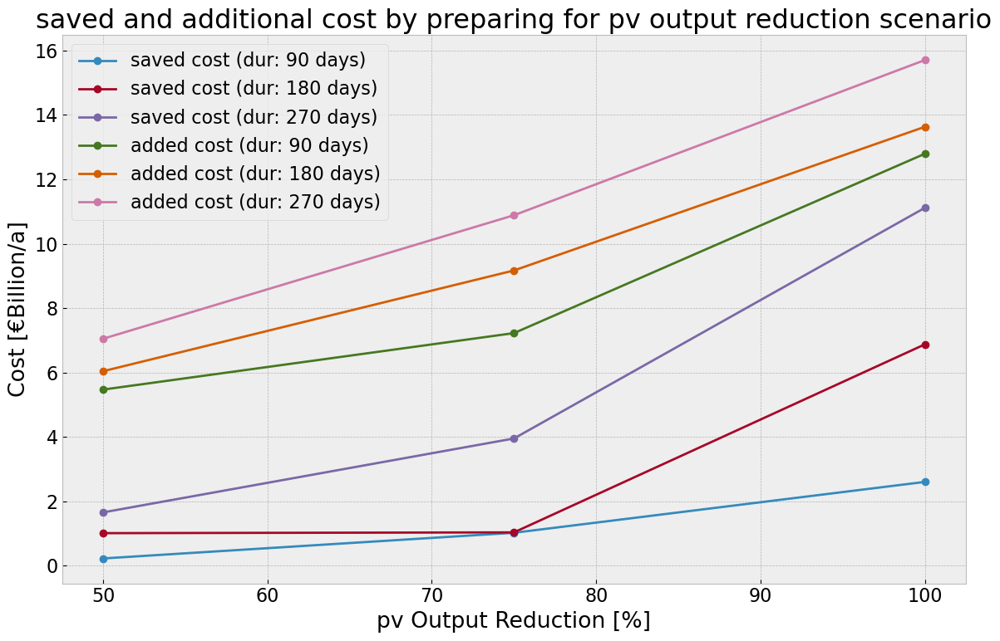

In [ ]:
#rename index
cost_df = pd.concat([senscost_df, addcost_df], axis=1)

new_index = [(x - 1) * -100 for x in sens_reductionto]
cost_df.index = new_index


# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Plot each column in the DataFrame
for column in cost_df.columns:
    ax.plot(cost_df.index, cost_df[column], marker='o', label=column)

# Add labels and legend
ax.set_xlabel(f'{contingency} Output Reduction [%]')
ax.set_ylabel('Cost [€Billion/a]')
ax.set_title(f'saved and additional cost by preparing for {contingency} output reduction scenario')
ax.legend()

# Show the plot
plt.xticks()  # Rotate x-axis labels if necessary
plt.tight_layout()  # Adjust layout to make room for labels

# Save plot to the current working directory
filename = f"sens_saved_cost.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()



### Built Generator & Storage Capacities

In [ ]:
#create a country based generator capacity df for every investment models 
modname_iteration = []
red_iteration = []
dur_iteration = []

for red in sens_reductionto:
    for dur in sens_duration:
        #senscost_df[f'n_{red_sanitized}_{dur_sanitized}'] = [0]
        
        for mod in models:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 

            
            #model as variable
            model =  globals()[mod_name]

            if mod == 'inv_roll':
                #append modname list
                modname_iteration.append(f'n_{red_sanitized}_{dur_sanitized}_inv_roll')
                red_iteration.append(red)
                dur_iteration.append(dur)

                # cap table
                capacities = model.generators
                capacities['country'] = capacities['bus'].str[:2]
                capacities = capacities.groupby(['country', 'carrier']).p_nom_opt.sum()
                capacities.fillna(0, inplace=True)
                #print(capacities)
                globals()[f'{mod_name}_cap_country'] = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
                globals()[f'{mod_name}_cap_country'].fillna(0, inplace=True)

                #sto table
                storage = n.storage_units
                storage['country'] = storage['bus'].str[:2]

                globals()[f'{mod_name}_sto_country'] = (storage.groupby(['country','carrier']).p_nom_opt.sum().unstack()/1000) #GW
                globals()[f'{mod_name}_sto_country'].fillna(0, inplace=True)


                #create empty df for transmission
                trans_df = {
                    'Country' : cap_base_country.index,
                    'AC': np.zeros(len(cap_base_country.index)),
                    'DC': np.zeros(len(cap_base_country.index))
                }

                trans_df = pd.DataFrame(trans_df)
                trans_df.set_index('Country', inplace=True)
    
                #AC
                ac_df = model.lines
                ac_df['country'] = ac_df['bus0'].str[:2]
                ac_df = ac_df.groupby(['country', 'carrier']).s_nom_opt.sum()
                ac_df.fillna(0, inplace=True)
                ac_df = ac_df.unstack().div(1e3) #GVA
            
                #DC
                dc_df = model.links
                dc_df['country'] = dc_df['bus0'].str[:2]
                dc_df = dc_df.groupby(['country', 'carrier']).p_nom_opt.sum()
                dc_df.fillna(0, inplace=True)
                dc_df = dc_df.unstack().div(1e3) #GW

                #fill empty df with AC Cap
                for index, row in trans_df.iterrows():
                    if index in ac_df.index:
                        try:
                            trans_df.loc[index, 'AC'] = ac_df.loc[index, 'AC']
                        except KeyError: 
                            trans_df.loc[index, 'AC'] = 0

                #fill empty df with DC Cap
                for index, row in trans_df.iterrows():
                    if index in dc_df.index:
                        try:
                            trans_df.loc[index, 'DC'] = dc_df.loc[index, 'DC']
                        except KeyError: 
                            trans_df.loc[index, 'DC'] = 0


                #trans_df = pd.concat([ac_df, dc_df], axis=1)
                #trans_df.fillna(0, inplace=True)
                globals()[f'{mod_name}_trans'] = trans_df
                #globals()[f'{mod_name}_trans_country'] = trans_df
                

#### Bar Plot

In [ ]:
# Define a color map using a color palette with 12 contrasting colors
colors = sns.color_palette("tab20", 13)  # 12 contrasting colors

# Mapping countries to colors
country_colors = {
    'AT': colors[0],
    'BE': colors[1],
    'CH': colors[2],
    'CZ': colors[3],
    'DE': colors[4],
    'DK': colors[5],
    'FR': colors[6],
    'GB': colors[7],
    'LU': colors[8],
    'NL': colors[9],
    'NO': colors[10],
    'PL': colors[11],
    'SE': colors[12]  # Reusing the first color for 'SE' to ensure there are 12 colors
}

In [ ]:
extendables = ['OCGT', 'solar','onwind', 'offwind-dc', 'offwind-ac']

for e in extendables:

    e_sanitized = sanitize_variable_name(str(e))

    #Cap Sensitivity df
    globals()[f'sens_{e_sanitized}'] = {
        'Scenario' : ['Base Roll'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e_sanitized}_sens_df'] = pd.DataFrame(globals()[f'sens_{e_sanitized}'])

    #add column countries
    for country in cap_base_country.index:
        globals()[f'{e_sanitized}_sens_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e_sanitized}_sens_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in cap_base_country.index:
        globals()[f'{e_sanitized}_sens_df'].loc['Base Roll', i] = cap_base_roll_country.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e_sanitized}_sens_df'].iterrows():
                if index != 'Base Roll':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e_sanitized}_sens_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            cap_df =  globals()[f'{mod_name}_cap_country']

            for index, row in globals()[f'{e_sanitized}_sens_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e_sanitized}_sens_df'].loc[index, i] = cap_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e_sanitized}_pivot_df'] = globals()[f'{e_sanitized}_sens_df'].drop(columns = ['Days', 'Reductionto'])
    

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\298830397.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2.8192' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_sens_df'].loc['Base Roll', i] = cap_base_roll_country.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\298830397.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '4.5323' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_sens_df'].loc['Base Roll', i] = cap_base_roll_country.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\298830397.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '22.8885365' has dtype incompatible with 

In [ ]:
extendables_plot = {'OCGT', 'solar', 'onwind', 'offwind'}
element_to_ax = {element: i for i, element in enumerate(extendables_plot)}

element_to_ax

{'OCGT': 0, 'offwind': 1, 'solar': 2, 'onwind': 3}

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, 

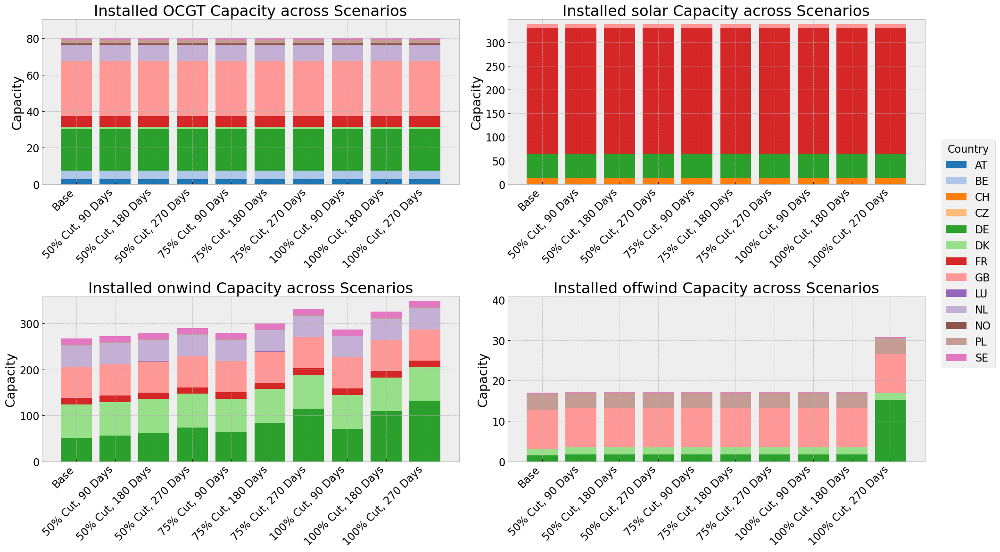

In [ ]:
# combine offwind ac and dc
offwind_pivot_df = offwind_ac_pivot_df.select_dtypes(include='number') + offwind_dc_pivot_df.select_dtypes(include='number')
offwind_pivot_df

extendables_plot = ['OCGT', 'solar', 'onwind', 'offwind']

# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20,12))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(extendables_plot)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_cap.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()


### Built Storage Capacities

In [ ]:
sto_type = n.storage_units.carrier.unique() 

for e in sto_type:

    #e_sanitized = sanitize_variable_name(str(e))

    #sto Sensitivity df
    globals()[f'sens_{e}'] = {
        'Scenario' : ['Base'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e}_sens_df'] = pd.DataFrame(globals()[f'sens_{e}'])

    #add column countries
    for country in store_base_df.index:
        globals()[f'{e}_sens_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e}_sens_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in store_base_df.index:
        globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e}_sens_df'].iterrows():
                if index != 'Base':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e}_sens_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            sto_df =  globals()[f'{mod_name}_sto_country']

            for index, row in globals()[f'{e}_sens_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e}_sens_df'].loc[index, i] = sto_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e}_pivot_df'] = globals()[f'{e}_sens_df'].drop(columns = ['Days', 'Reductionto'])

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '5.057300000000001' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.308' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '5.089549999999999' has dtype incompatible with int64, please explicitly cast

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, 

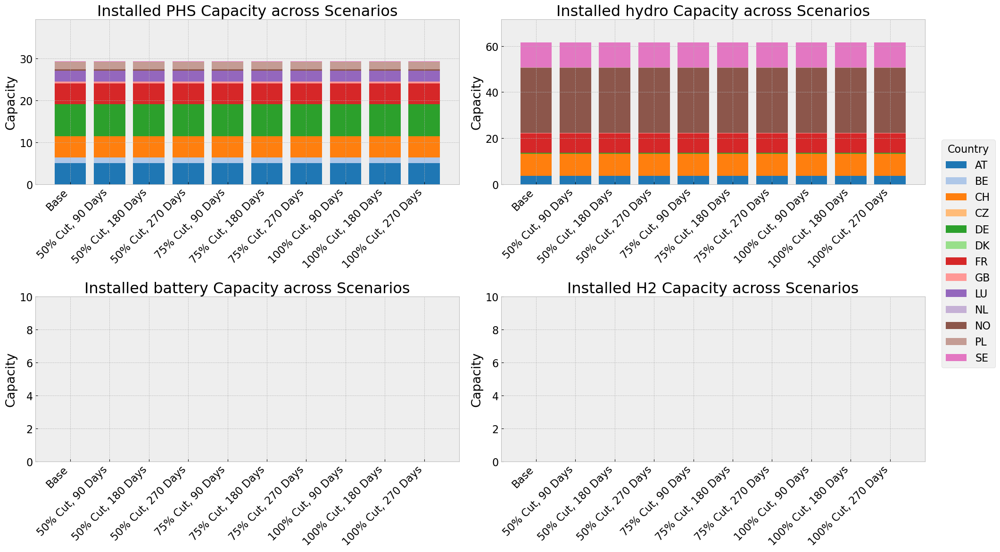

In [ ]:
# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20,12))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(sto_type)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_sto.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()

### Transmission Cap

In [ ]:
line_type = ['AC', 'DC']

for e in line_type:

    e_sanitized = sanitize_variable_name(str(e))

    #trans Sensitivity df
    globals()[f'trans_{e_sanitized}'] = {
        'Scenario' : ['Base'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e_sanitized}_trans_df'] = pd.DataFrame(globals()[f'trans_{e_sanitized}'])

    #add column countries
    for country in cap_base_country.index:
        globals()[f'{e_sanitized}_trans_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e_sanitized}_trans_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in cap_base_country.index:
        globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_pv.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e_sanitized}_trans_df'].iterrows():
                if index != 'Base':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e_sanitized}_trans_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            cap_df =  globals()[f'{mod_name}_trans']

            for index, row in globals()[f'{e_sanitized}_trans_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e_sanitized}_trans_df'].loc[index, i] = cap_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e_sanitized}_pivot_df'] = globals()[f'{e_sanitized}_trans_df'].drop(columns = ['Days', 'Reductionto'])

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\1851231033.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '29.022506910057025' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_pv.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\1851231033.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '21.365814189857804' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_pv.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\1851231033.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '41.77435568306778' has dtype incompat

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\3519662137.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_6304\3519662137.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')


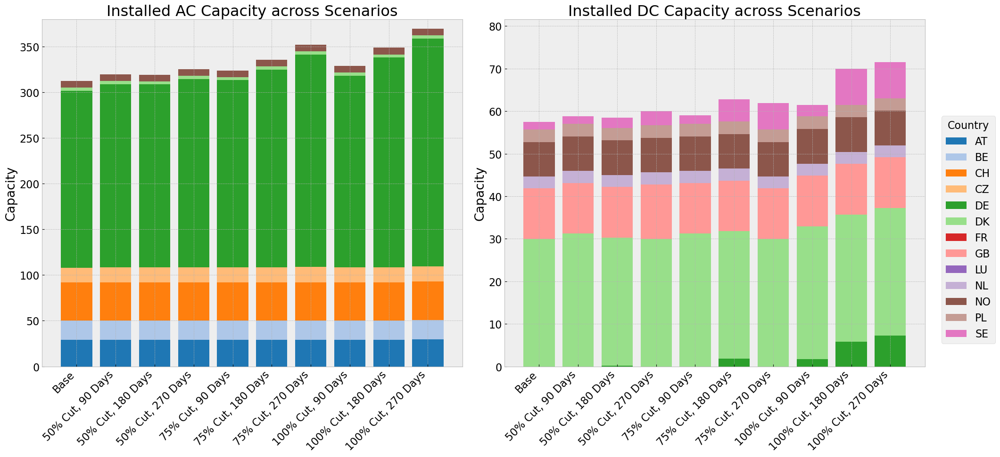

In [ ]:
# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20,10))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(line_type)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_sto.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()